## Drive Mount

In [ ]:
from google.colab import auth
auth.authenticate_user()

from google.colab import drive, files
drive.mount('/content/drive')


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


# Install and Importing

In [ ]:
%%capture
!pip install --force-reinstall stable-baselines3[extra]
# !pip install --force-reinstall stable-baselines[mpi]
!pip install gym
!pip install -U tensorboard
!pip install matplotlib==3.1.3

In [ ]:
#Import scipy
import scipy as sci
#Import matplotlib and associated modules for 3D and animations
import matplotlib.pyplot as plt
import numpy as np
import shutil 
%tensorflow_version 1.x
import gym
from gym import spaces
import scipy.integrate

TensorFlow 1.x selected.


# Custom Envs

## Define Custom Gym - 3D version. Default


In [ ]:
def ThreeBodyEquations(w,t,m1,m2,m3):
  import numpy as np
  import scipy as sci
  #Define universal gravitation constant
  G=6.67408e-11 #N-m2/kg2
  m_nd=1.989e+30 #kg #mass of the sun
  r_nd=5.326e+12 #m #distance between stars in Alpha Centauri
  v_nd=30000 #m/s #relative velocity of earth around the sun
  t_nd=79.91*365*24*3600*0.51 #s #orbital period of Alpha Centauri
  # G = 1
  # m_nd = 1
  # r_nd = 1
  # v_nd = 1
  # t_nd = 1
  #Net constants
  K1=G*t_nd*m_nd/(r_nd**2*v_nd)
  K2=v_nd*t_nd/r_nd

  r1=w[:3]
  r2=w[3:6]
  r3=w[6:9]
  v1=w[9:12]
  v2=w[12:15]
  v3=w[15:18]
  r12=sci.linalg.norm(r2-r1)
  r13=sci.linalg.norm(r3-r1)
  r23=sci.linalg.norm(r3-r2)
  
  dv1bydt=K1*m2*(r2-r1)/r12**3+K1*m3*(r3-r1)/r13**3
  dv2bydt=K1*m1*(r1-r2)/r12**3+K1*m3*(r3-r2)/r23**3
  dv3bydt=K1*m1*(r1-r3)/r13**3+K1*m2*(r2-r3)/r23**3
  dr1bydt=K2*v1
  dr2bydt=K2*v2
  dr3bydt=K2*v3

  r12_derivs=np.concatenate((dr1bydt,dr2bydt))
  r_derivs=np.concatenate((r12_derivs,dr3bydt))
  v12_derivs=np.concatenate((dv1bydt,dv2bydt))
  v_derivs=np.concatenate((v12_derivs,dv3bydt))
  derivs=np.concatenate((r_derivs,v_derivs))

  return derivs

In [ ]:
def fit_sin(tt, yy):
  import numpy, scipy.optimize
  
  '''Fit sin to the input time sequence, and return fitting parameters "amp", "omega", "phase", "offset", "freq", "period" and "fitfunc"'''
  tt = numpy.array(tt)
  yy = numpy.array(yy)
  ff = numpy.fft.fftfreq(len(tt), (tt[1]-tt[0]))   # assume uniform spacing
  Fyy = abs(numpy.fft.fft(yy))
  guess_freq = abs(ff[numpy.argmax(Fyy[1:])+1])   # excluding the zero frequency "peak", which is related to offset
  guess_amp = numpy.std(yy) * 2.**0.5
  guess_offset = numpy.mean(yy)
  guess = numpy.array([guess_amp, 2.*numpy.pi*guess_freq, 0., guess_offset])

  def sinfunc(t, A, w, p, c):  return A * numpy.sin(w*t + p) + c

  popt, pcov = scipy.optimize.curve_fit(sinfunc, tt, yy, p0=guess, maxfev=5000)
  A, w, p, c = popt
  f = w/(2.*numpy.pi)
  fitfunc = lambda t: A * numpy.sin(w*t + p) + c

  def sinfuncd2(t, A, w, p, c):  return -w**2 * A * numpy.sin(w*t + p) + c*0

  return sinfunc(tt, *popt), 1/f , sinfuncd2(tt, *popt)


In [ ]:
def reward_scheme(r1_sol, r2_sol, r3_sol, period_weight=1, r_squared_weight=1, range_weight=10, rel_range_weight=10, err_weight=10, Outrange_val = 10, time_fin=20, time_separ=500):
  r_squared_reward = []
  period_reward = []
  range_reward = []
  Fit_err_reward = []
  time_span= np.linspace(0, time_fin, time_separ)
  r_sol = [r1_sol,r2_sol,r3_sol]

  r12 = r_sol[1]-r_sol[0]
  r13 = r_sol[2]-r_sol[0]
  r23 = r_sol[2]-r_sol[1]

  r12_reward = np.where((Outrange_val >= np.abs(r12)), 0, np.abs(r12) )
  r13_reward = np.where((Outrange_val >= np.abs(r12)), 0, np.abs(r13) )
  r23_reward = np.where((Outrange_val >= np.abs(r12)), 0, np.abs(r23) )

  total_rel_range_reward = np.sum(r12_reward)+np.sum(r23_reward)+np.sum(r13_reward)
  
  # R_12 = np.square(np.linalg.norm((r_sol[1]-r_sol[0]), axis=1))
  # R_13 = np.square(np.linalg.norm((r_sol[2]-r_sol[0]), axis=1))
  # R_23 = np.square(np.linalg.norm((r_sol[2]-r_sol[1]), axis=1))
  
  # F_1 =  r12/np.array([R_12,R_12,R_12]).T + r13/np.array([R_13,R_13,R_13]).T
  # F_2 =  r23/np.array([R_23,R_23,R_23]).T - r12/np.array([R_12,R_12,R_12]).T
  # F_3 = -r13/np.array([R_13,R_13,R_13]).T - r23/np.array([R_23,R_23,R_23]).T

  # F = [F_1, F_2, F_3]


  if total_rel_range_reward > ( time_separ / 2 )*9*Outrange_val:
    return -1000
  else:
    r12_reward[r12_reward==0]=np.nan
    r13_reward[r12_reward==0]=np.nan
    r23_reward[r12_reward==0]=np.nan

    rel_range_reward_avg = np.nanmean(r12_reward)+np.nanmean(r23_reward)+np.nanmean(r13_reward)
    if np.isnan(rel_range_reward_avg):
      rel_range_reward_avg = 0
    else:
      pass

    for i in [0,1,2]:
      for j in [0,1,2]:
        xdata = time_span #self
        ydata = r_sol[j][:,i]

        # F_val = F[j][:,i]

        if np.abs(r_sol[j][-1,i]) > Outrange_val:
          range_reward.append(-range_weight*np.abs(r1_sol[-1,i]))
        else:
          range_reward.append(0)
        try:
          fitsin, T, fita = fit_sin(time_span, ydata)
          residuals = ydata- fitsin
          # ss_res = np.sum(residuals**2)
          # ss_tot = np.sum((ydata-np.mean(ydata))**2)
          # r_squared = 1 - (ss_res / ss_tot)
          # R-squared reward 보다(큰 의미없음, 웬만하면 맞추게 함) 실질적인 Err를 reward로.
          period_reward.append((period_weight * (time_fin/np.abs(T)))) #self
          # r_squared_reward.append(r_squared_weight * r_squared) #self
          r_squared_reward.append(0)

          err = np.linalg.norm(fitsin-ydata)
          Fit_err_reward.append(err)


        except:
          period_reward.append(-1)
          r_squared_reward.append(-1)
          Fit_err_reward.append(-1)
    period_reward = np.nan_to_num(period_reward, nan=-1.0, posinf=-1, neginf=-1)
    r_squared_reward = np.nan_to_num(r_squared_reward, nan=-1.0,posinf=-1, neginf=-1)
    range_reward = np.nan_to_num(range_reward, nan=-1.0,posinf=-1, neginf=-1)

    reward_tot = (np.average(r_squared_reward)+np.average(period_reward)+np.average(range_reward)-rel_range_weight*rel_range_reward_avg-err_weight*np.average(Fit_err_reward)).astype(dtype=float)
    return reward_tot


In [ ]:



import scipy as sci

class CustomEnv(gym.Env):
  """Custom Environment that follows gym interface"""
  metadata = {'render.modes': ['human']}

  def __init__(self):
    super(CustomEnv, self).__init__()
    # Define action and observation space

    # They must be gym.spaces objects
    self.reward = 0.0
    self.time_fin = 40
    self.time_separ = 1000
    self.time_span=np.linspace(0, self.time_fin, self.time_separ)

    #initial params 
    self.m1=1
    self.m2=1
    self.m3=1

    self.r1=[0,1,0]
    self.r2=[1,0,0]
    self.r3=[-1,0,0]

    self.v1=[0,0,0]
    self.v2=[0,0,0]
    self.v3=[0,0,0]
    # val = np.finfo(np.float32).max
    self.action_space = spaces.Box(np.array([-1, -1, -1], dtype=np.float32), np.array([+1, +1, +1], dtype=np.float32), dtype=np.float32)
    self.observation_space = spaces.Box(low = -100, high= 100, shape=(3,), dtype=np.float32)


  def step(self, action):
    action = np.nan_to_num(action, nan=0)
    if action is not None:
      r1_P = [action[0]/100, action[1]/100, action[2]/100]
    else:
      r1_P = [0,0,0]
    
    self.r1 = [self.r1[0] + r1_P[0], self.r1[1] + r1_P[1], self.r1[2] + r1_P[2]]
    
    r1_=np.array(self.r1,dtype=np.float32)
    r2_=np.array(self.r2,dtype=np.float32)
    r3_=np.array(self.r3,dtype=np.float32)

    v1_=np.array(self.v1,dtype=np.float32)
    v2_=np.array(self.v2,dtype=np.float32)
    v3_=np.array(self.v3,dtype=np.float32)

    init_params_step = np.array([r1_,r2_,r3_,v1_,v2_,v3_]).flatten()

    three_body_sol=sci.integrate.odeint(ThreeBodyEquations, init_params_step, self.time_span,args=(self.m1, self.m2, self.m3))

    three_body_sol = three_body_sol.astype(dtype=np.float32)

    r1_sol=three_body_sol[:,:3]
    r2_sol=three_body_sol[:,3:6]
    r3_sol=three_body_sol[:,6:9]

    reward_tot = reward_scheme(r1_sol, r2_sol, r3_sol, Outrange_val = 4, period_weight=50, r_squared_weight=1, range_weight=10, rel_range_weight=10, err_weight=10,  time_fin=self.time_fin, time_separ=self.time_separ)
    reward = reward_tot
    
    if np.abs(r1_sol[-1,0]) > 100 or np.abs(r1_sol[-1,1])>100 or np.abs(r1_sol[-1,2])>100:
      observation = np.array([99,99,99])
      #TODO Outranged 를 각각의 변수에 대한 Func로 변환해야함
    else:
      observation = np.array([r1_sol[-1,0],r1_sol[-1,1],r1_sol[-1,2]])
    
    if reward_tot == -1000:
      done = True
    else:
      done = bool(   r1_sol[-1,0]==r2_sol[-1,0] 
                or r2_sol[-1,0]==r3_sol[-1,0]
                or r3_sol[-1,0]==r1_sol[-1,0]
                or r1_sol[-1,1]==r2_sol[-1,1]
                or r2_sol[-1,1]==r3_sol[-1,1]
                or r3_sol[-1,1]==r1_sol[-1,1]
                or r1_sol[-1,2]==r2_sol[-1,2]
                or r2_sol[-1,2]==r3_sol[-1,2]
                or r3_sol[-1,2]==r1_sol[-1,2])


    info = {"r1_init": self.r1}

    # #resetting
    # r1=self.r1
    # r2=[0,-1,0]
    # r3=[0,1,0]
    # v1=[0,0,0] 
    # v2=[0,0,0] 
    # v3=[0,0,0]

    return observation, reward, done, info

  def reset(self):

    self.reward = 0.0
    self.r1 = [0,1,0]

    observation = np.array(self.r1)
    return observation  # reward, done, info can't be included

  def render(self, mode='human'):
    ###  
    _r1=np.array(self.r1,dtype=np.float32)
    _r2=np.array(self.r2,dtype=np.float32)
    _r3=np.array(self.r3,dtype=np.float32)

    _v1=np.array(self.v1,dtype=np.float32)
    _v2=np.array(self.v2,dtype=np.float32)
    _v3=np.array(self.v3,dtype=np.float32)

    init_params_render = np.array([_r1,_r2,_r3,_v1,_v2,_v3]).flatten()

    three_body_sol=sci.integrate.odeint(ThreeBodyEquations, init_params_render, self.time_span, args=(self.m1, self.m2, self.m3))
    three_body_sol = three_body_sol.astype(dtype=np.float32)
    ###
    r1_sol=three_body_sol[:,:3]
    r2_sol=three_body_sol[:,3:6]
    r3_sol=three_body_sol[:,6:9]
    
    #Create figure
    fig=plt.figure(figsize=(15,15))
    #Create 3D axes
    ax=fig.add_subplot(111,projection="3d")
    #Plot the orbits
    ax.plot(r1_sol[:,0],r1_sol[:,1],r1_sol[:,2],color="darkblue")
    ax.plot(r2_sol[:,0],r2_sol[:,1],r2_sol[:,2],color="tab:red")
    ax.plot(r3_sol[:,0],r3_sol[:,1],r3_sol[:,2],color="tab:green")
    #Plot the final positions of the stars
    ax.scatter(r1_sol[-1,0],r1_sol[-1,1],r1_sol[-1,2],color="darkblue",marker="o",s=100,label="A")
    ax.scatter(r2_sol[-1,0],r2_sol[-1,1],r2_sol[-1,2],color="tab:red",marker="o",s=100,label="B")
    ax.scatter(r3_sol[-1,0],r3_sol[-1,1],r3_sol[-1,2],color="tab:green",marker="o",s=100,label="C")
    #Add a few more bells and whistles
    ax.set_xlabel("x-coordinate",fontsize=14)
    ax.set_ylabel("y-coordinate",fontsize=14)
    ax.set_zlabel("z-coordinate",fontsize=14)
    ax.set_title("Visualization of orbits of stars in a 3-body system\n",fontsize=14)
    plt.xlim(-5,5)
    plt.ylim(-5,5)
    ax.set_zlim(-5,5)
    ax.legend(loc="upper left",fontsize=14)

  def close(self):
    pass


## 2D ver. -  3D defulat ver. to 2D
/ Not changed in scheme

In [ ]:
import gym
import scipy.integrate
from gym import spaces
import scipy as sci
def ThreeBodyEquations2(w,G,m1,m2,m3):
    import numpy as np
    import scipy as sci
    #Define universal gravitation constant
    # G=6.67408e-11 #N-m2/kg2
    # m_nd=1.989e+30 #kg #mass of the sun
    # r_nd=5.326e+12 #m #distance between stars in Alpha Centauri
    # v_nd=30000 #m/s #relative velocity of earth around the sun
    # t_nd=79.91*365*24*3600*0.51 #s #orbital period of Alpha Centauri
    G = 1
    m_nd = 1
    r_nd = 1
    v_nd = 1
    t_nd = 1
    #Net constants
    K1=G*t_nd*m_nd/(r_nd**2*v_nd)
    K2=v_nd*t_nd/r_nd
    r1=w[:2]
    r2=w[2:4]
    r3=w[4:6]
    v1=w[6:8]
    v2=w[8:10]
    v3=w[10:12]
    r12=np.linalg.norm(r2-r1)
    r13=np.linalg.norm(r3-r1)
    r23=np.linalg.norm(r3-r2)
    
    dv1bydt=K1*m2*(r2-r1)/r12**3+K1*m3*(r3-r1)/r13**3
    dv2bydt=K1*m1*(r1-r2)/r12**3+K1*m3*(r3-r2)/r23**3
    dv3bydt=K1*m1*(r1-r3)/r13**3+K1*m2*(r2-r3)/r23**3
    dr1bydt=K2*v1
    dr2bydt=K2*v2
    dr3bydt=K2*v3
    r12_derivs=np.concatenate((dr1bydt,dr2bydt))
    r_derivs=np.concatenate((r12_derivs,dr3bydt))
    v12_derivs=np.concatenate((dv1bydt,dv2bydt))
    v_derivs=np.concatenate((v12_derivs,dv3bydt))
    derivs=np.concatenate((r_derivs,v_derivs))
    return derivs

def reward_scheme2(r1_sol, r2_sol, r3_sol, period_weight=1, r_squared_weight=1, range_weight=10, rel_range_weight=10, err_weight=10, Outrange_val = 10, time_fin=20, time_separ=500):
  r_squared_reward = []
  period_reward = []
  range_reward = []
  Fit_err_reward = []
  time_span= np.linspace(0, time_fin, time_separ)
  r_sol = [r1_sol,r2_sol,r3_sol]

  r12 = r_sol[1]-r_sol[0]
  r13 = r_sol[2]-r_sol[0]
  r23 = r_sol[2]-r_sol[1]

  r12_reward = np.where((Outrange_val >= np.abs(r12)), 0, np.abs(r12) )
  r13_reward = np.where((Outrange_val >= np.abs(r12)), 0, np.abs(r13) )
  r23_reward = np.where((Outrange_val >= np.abs(r12)), 0, np.abs(r23) )

  total_rel_range_reward = np.sum(r12_reward)+np.sum(r23_reward)+np.sum(r13_reward)

  if total_rel_range_reward > ( time_separ / 2 )*9*Outrange_val:
    return -1000
  else:
    r12_reward[r12_reward==0]=np.nan
    r13_reward[r12_reward==0]=np.nan
    r23_reward[r12_reward==0]=np.nan

    rel_range_reward_avg = np.nanmean(r12_reward)+np.nanmean(r23_reward)+np.nanmean(r13_reward)
    if np.isnan(rel_range_reward_avg):
      rel_range_reward_avg = 0
    else:
      pass

    for i in [0,1]:
      for j in [0,1,2]:
        xdata = time_span #self
        ydata = r_sol[j][:,i]

        # F_val = F[j][:,i]

        if np.abs(r_sol[j][-1,i]) > Outrange_val:
          range_reward.append(-range_weight*np.abs(r1_sol[-1,i]))
        else:
          range_reward.append(0)
        try:
          fitsin, T, fita = fit_sin(time_span, ydata)
          residuals = ydata- fitsin
          # ss_res = np.sum(residuals**2)
          # ss_tot = np.sum((ydata-np.mean(ydata))**2)
          # r_squared = 1 - (ss_res / ss_tot)
          # R-squared reward 보다(큰 의미없음, 웬만하면 맞추게 함) 실질적인 Err를 reward로.
          period_reward.append((period_weight * (time_fin/np.abs(T)))) #self
          # r_squared_reward.append(r_squared_weight * r_squared) #self
          r_squared_reward.append(0)

          err = np.linalg.norm(fitsin-ydata)
          Fit_err_reward.append(err)


        except:
          period_reward.append(-1)
          r_squared_reward.append(-1)
          Fit_err_reward.append(-1)
    period_reward = np.nan_to_num(period_reward, nan=-1.0, posinf=-1, neginf=-1)
    r_squared_reward = np.nan_to_num(r_squared_reward, nan=-1.0,posinf=-1, neginf=-1)
    range_reward = np.nan_to_num(range_reward, nan=-1.0,posinf=-1, neginf=-1)

    reward_tot = (np.average(r_squared_reward)+np.average(period_reward)+np.average(range_reward)-rel_range_weight*rel_range_reward_avg-err_weight*np.average(Fit_err_reward)).astype(dtype=float)
    return reward_tot


class CustomEnv2(gym.Env):
  """Custom Environment that follows gym interface"""
  metadata = {'render.modes': ['human']}

  def __init__(self):
    super(CustomEnv2, self).__init__()
    # Define action and observation space

    # They must be gym.spaces objects
    self.reward = 0.0
    self.time_fin = 40
    self.time_separ = 1000
    self.time_span=np.linspace(0, self.time_fin, self.time_separ)

    #initial params 
    self.m1=1
    self.m2=1
    self.m3=1

    self.r1=[0,1]
    self.r2=[1,0]
    self.r3=[-1,0]

    self.v1=[0,0]
    self.v2=[0,0]
    self.v3=[0,0]
    # val = np.finfo(np.float32).max
    self.action_space = spaces.Box(np.array([-1, -1], dtype=np.float32), np.array([+1, +1], dtype=np.float32), dtype=np.float32)
    self.observation_space = spaces.Box(low = -100, high= 100, shape=(2,), dtype=np.float32)


  def step(self, action):
    action = np.nan_to_num(action, nan=0)
    if action is not None:
      r1_P = [action[0]/100, action[1]/100]
    else:
      r1_P = [0,0]
    
    self.r1 = [self.r1[0] + r1_P[0], self.r1[1] + r1_P[1]]
    
    r1_=np.array(self.r1,dtype=np.float32)
    r2_=np.array(self.r2,dtype=np.float32)
    r3_=np.array(self.r3,dtype=np.float32)

    v1_=np.array(self.v1,dtype=np.float32)
    v2_=np.array(self.v2,dtype=np.float32)
    v3_=np.array(self.v3,dtype=np.float32)

    init_params_step = np.array([r1_,r2_,r3_,v1_,v2_,v3_]).flatten()

    three_body_sol=sci.integrate.odeint(ThreeBodyEquations2, init_params_step, self.time_span,args=(self.m1, self.m2, self.m3))

    three_body_sol = three_body_sol.astype(dtype=np.float32)

    r1_sol=three_body_sol[:,:2]
    r2_sol=three_body_sol[:,2:4]
    r3_sol=three_body_sol[:,4:6]

    self.r1_sol = r1_sol
    self.r2_sol = r2_sol
    self.r3_sol = r3_sol

    reward_tot = reward_scheme2(r1_sol, r2_sol, r3_sol, Outrange_val = 4, period_weight=50, r_squared_weight=1, range_weight=10, rel_range_weight=10, err_weight=10,  time_fin=self.time_fin, time_separ=self.time_separ)
    reward = reward_tot
    
    if np.abs(r1_sol[-1,0]) > 100 or np.abs(r1_sol[-1,1])>100:
      observation = np.array([99,99])
      #TODO Outranged 를 각각의 변수에 대한 Func로 변환해야함
    else:
      observation = np.array([r1_sol[-1,0],r1_sol[-1,1]])
    
    if reward_tot == -1000:
      done = True
    else:
      done = bool(   r1_sol[-1,0]==r2_sol[-1,0] 
                or r2_sol[-1,0]==r3_sol[-1,0]
                or r3_sol[-1,0]==r1_sol[-1,0]
                or r1_sol[-1,1]==r2_sol[-1,1]
                or r2_sol[-1,1]==r3_sol[-1,1]
                or r3_sol[-1,1]==r1_sol[-1,1])


    info = {"r1_init": self.r1}

    return observation, reward, done, info

  def reset(self):

    self.reward = 0.0
    self.r1 = [0,1]

    self.r1_sol = []
    self.r2_sol = []
    self.r3_sol = []
    observation = np.array(self.r1)
    return observation  # reward, done, info can't be included

  def render(self, mode='human'):
    r1_sol=self.r1_sol
    r2_sol=self.r2_sol
    r3_sol=self.r3_sol
    #Create figure
    fig=plt.figure(figsize=(15,15))
    #Create 3D axes
    ax=fig.add_subplot(111)
    #Plot the orbits
    ax.plot(r1_sol[:,0],r1_sol[:,1],color="darkblue")
    ax.plot(r2_sol[:,0],r2_sol[:,1],color="tab:red")
    ax.plot(r3_sol[:,0],r3_sol[:,1],color="tab:green")
    #Plot the final positions of the stars
    ax.scatter(r1_sol[-1,0],r1_sol[-1,1],color="darkblue",marker="o",s=100,label="A")
    ax.scatter(r2_sol[-1,0],r2_sol[-1,1],color="tab:red",marker="o",s=100,label="B")
    ax.scatter(r3_sol[-1,0],r3_sol[-1,1],color="tab:green",marker="o",s=100,label="C")
    #Add a few more bells and whistles
    ax.set_xlabel("x-coordinate",fontsize=14)
    ax.set_ylabel("y-coordinate",fontsize=14)

    ax.set_title("Visualization of orbits of stars in a 3-body system\n",fontsize=14)
    plt.xlim(-5,5)
    plt.ylim(-5,5)
    print(r1_sol[0,:])
    ax.legend(loc="upper left",fontsize=14)
    plt.show()

  def close(self):
    pass
# 2D 3B equation 만족

## Custom ENV 2DT - random T search

In [ ]:
import random
from numba import jit

@jit
def ThreeBodyEquations2(w,G,m1,m2,m3):
  #Define universal gravitation constant
  # G=6.67408e-11 #N-m2/kg2
  # m_nd=1.989e+30 #kg #mass of the sun
  # r_nd=5.326e+12 #m #distance between stars in Alpha Centauri
  # v_nd=30000 #m/s #relative velocity of earth around the sun
  # t_nd=79.91*365*24*3600*0.51 #s #orbital period of Alpha Centauri
  G = 1
  m_nd = 1
  r_nd = 1
  v_nd = 1
  t_nd = 1
  # Net constants

  K1=G*t_nd*m_nd/(r_nd**2*v_nd)
  K2=v_nd*t_nd/r_nd
  r1=w[:2]
  r2=w[2:4]
  r3=w[4:6]
  v1=w[6:8]
  v2=w[8:10]
  v3=w[10:12]
  
  r12=np.linalg.norm(r2-r1)
  r13=np.linalg.norm(r3-r1)
  r23=np.linalg.norm(r3-r2)
  
  dv1bydt=K1*m2*(r2-r1)/r12**3+K1*m3*(r3-r1)/r13**3
  dv2bydt=K1*m1*(r1-r2)/r12**3+K1*m3*(r3-r2)/r23**3
  dv3bydt=K1*m1*(r1-r3)/r13**3+K1*m2*(r2-r3)/r23**3
  dr1bydt=K2*v1
  dr2bydt=K2*v2
  dr3bydt=K2*v3
  r12_derivs=np.concatenate((dr1bydt,dr2bydt))
  r_derivs=np.concatenate((r12_derivs,dr3bydt))
  v12_derivs=np.concatenate((dv1bydt,dv2bydt))
  v_derivs=np.concatenate((v12_derivs,dv3bydt))
  derivs=np.concatenate((r_derivs,v_derivs))
  return derivs
def reward_scheme_T(r1_sol, r2_sol, r3_sol, period_weight=1,range_weight=50, set_period=10, time_fin=40, time_separ=1000):
  period_reward = []
  # moved_reward = []
  range_reward = []
  time_span= np.linspace(0, time_fin, time_separ)
  r_sol = [r1_sol,r2_sol,r3_sol]
  T = set_period

  for j in [0,1,2]:
    xdata = time_span #self
    ydata = r_sol[j]
    err = np.sum(np.linalg.norm(ydata[:time_separ-T]-ydata[T:], axis=1))
    # moved = np.sum(np.linalg.norm(ydata[:time_separ-1]-ydata[1:], axis=1))

    loc = np.abs(np.linalg.norm(ydata[-1]))

    period_reward.append(err)
    # moved_reward.append(err)
    range_reward.append(loc)


## 그냥 저 멀리 보내서 안움직이게 만드는 경우가 생김
  # moved_frac = (1/np.sum(moved_reward)).astype(dtype=float)
  reward_tot = - period_weight*np.sum(period_reward).astype(dtype=float) - range_weight*np.sum(range_reward).astype(dtype=float)
    # reward_tot = period_reward
  return reward_tot

class CustomEnv2DT(gym.Env):
  """Custom Environment that follows gym interface"""
  metadata = {'render.modes': ['human']}

  def __init__(self):
    super(CustomEnv2DT, self).__init__()
    # Define action and observation space

    # They must be gym.spaces objects
    self.reward = 0
    self.time_fin = 40
    self.time_separ = 1000
    self.time_span=np.linspace(0, self.time_fin, self.time_separ)
    self.not_done_reward_weight = 5

    #initial params 
    self.m1=1
    self.m2=1
    self.m3=1
    self.range = 10

    self.period = random.randrange(0,self.time_separ/4)

    self.r1=[0,0]
    self.r2=[1,1]
    self.r3=[-1,-1]

    self.v1=[0,0]
    self.v2=[0,0]
    self.v3=[0,0]

    # vel .. 
    # val = np.finfo(np.float32).max
    self.action_space = spaces.Box(np.array([-1, -1, -1, -1], dtype=np.float32), np.array([+1, +1, +1, +1], dtype=np.float32), dtype=np.float32)
    self.observation_space = spaces.Box(low = -1000, high= 1000, shape=(4,), dtype=np.float32)


  def step(self, action):

    action = np.nan_to_num(action, nan=0)
    if action is not None:
      r2_P = [action[0]/100, action[1]/100]
      r3_P = [action[2]/100, action[3]/100]
    else:
      r2_P = [0,0]
      r3_P = [0,0]
    
    self.r2 = [self.r2[0] + r2_P[0], self.r2[1] + r2_P[1]]
    self.r3 = [self.r3[0] + r3_P[0], self.r3[1] + r3_P[1]]
    
    r1_=np.array(self.r1,dtype=np.float32)
    r2_=np.array(self.r2,dtype=np.float32)
    r3_=np.array(self.r3,dtype=np.float32)

    v1_=np.array(self.v1,dtype=np.float32)
    v2_=np.array(self.v2,dtype=np.float32)
    v3_=np.array(self.v3,dtype=np.float32)

    init_params_step = np.array([r1_,r2_,r3_,v1_,v2_,v3_]).flatten()

    three_body_sol=sci.integrate.odeint(ThreeBodyEquations2, init_params_step, self.time_span,args=(self.m1, self.m2, self.m3))

    three_body_sol = three_body_sol.astype(dtype=np.float32)

    r1_sol=three_body_sol[:,:2]
    r2_sol=three_body_sol[:,2:4]
    r3_sol=three_body_sol[:,4:6]

    self.r1_sol = r1_sol
    self.r2_sol = r2_sol
    self.r3_sol = r3_sol

    cond1 = bool(not((np.shape(np.where((r1_sol == r2_sol))) == (2,0))))
    cond2 = bool(not((np.shape(np.where((r2_sol == r3_sol))) == (2,0))))
    cond3 = bool(not((np.shape(np.where((r3_sol == r1_sol))) == (2,0))))
    val = self.range
    if np.abs(self.r2[0])>val or np.abs(self.r2[1])>val or np.abs(self.r3[0])>val or np.abs(self.r3[1])>val:
      done = True
      # reward = 

    elif cond1 or cond2 or cond3:
      done = True
      val1 =  np.where((r1_sol == r2_sol))[0][0] if cond1 else 0
      val2 =  np.where((r2_sol == r3_sol))[0][0] if cond2 else 0
      val3 =  np.where((r3_sol == r1_sol))[0][0] if cond3 else 0
      # reward = self.not_done_reward_weight*(val1+val2+val3).astype('float')

    else:
      done = False

    reward_tot = reward_scheme_T(r1_sol, r2_sol, r3_sol, period_weight=1, range_weight=50,  set_period=self.period,  time_fin=self.time_fin, time_separ=self.time_separ)
    reward = reward_tot
    
    observation = np.array([self.r2[0],self.r2[1],self.r3[0], self.r3[1]])
    # np.array([r2_sol[-1,0],r2_sol[-1,1],r3_sol[-1,0],r3_sol[-1,1]])
    
    info = {"r2_init": self.r2, "r3_init": self.r3, "period": self.period}

    return observation, reward, done, info

  def reset(self):

    self.reward = 0.0
    self.r1 = [0,0]
    self.r2 = [1,1]
    self.r3 = [-1,-1]

    self.r1_sol = []
    self.r2_sol = []
    self.r3_sol = []

    self.period = random.randrange(0,self.time_separ/4)

    observation = np.array([self.r2[0],self.r2[1],self.r3[0], self.r3[1]])
    return observation  # reward, done, info can't be included

  def render(self, mode='human'):
    r1_sol=self.r1_sol
    r2_sol=self.r2_sol
    r3_sol=self.r3_sol
    #Create figure
    fig=plt.figure(figsize=(15,15))
    #Create 3D axes
    ax=fig.add_subplot(111)
    #Plot the orbits
    ax.plot(r1_sol[:,0],r1_sol[:,1],color="darkblue")
    ax.plot(r2_sol[:,0],r2_sol[:,1],color="tab:red")
    ax.plot(r3_sol[:,0],r3_sol[:,1],color="tab:green")
    #Plot the final positions of the stars
    ax.scatter(r1_sol[-1,0],r1_sol[-1,1],color="darkblue",marker="o",s=100,label="A")
    ax.scatter(r2_sol[-1,0],r2_sol[-1,1],color="tab:red",marker="o",s=100,label="B")
    ax.scatter(r3_sol[-1,0],r3_sol[-1,1],color="tab:green",marker="o",s=100,label="C")
    #Add a few more bells and whistles
    ax.set_xlabel("x-coordinate",fontsize=14)
    ax.set_ylabel("y-coordinate",fontsize=14)

    ax.set_title("Visualization of orbits of stars in a 3-body system\n",fontsize=14)
    plt.xlim(-5,5)
    plt.ylim(-5,5)
    print(r2_sol[0,:],r3_sol[0,:])
    ax.legend(loc="upper left",fontsize=14)
    plt.show()

  def close(self):
    pass
# 2D 3B equation 만족

## Custom ENV 2DT V & T 
- T and V as variables
CustimEnv2DT_V()

In [ ]:
from numba import jit

@jit
def ThreeBodyEquations2(w,G,m1,m2,m3):
  #Define universal gravitation constant
  # G=6.67408e-11 #N-m2/kg2
  # m_nd=1.989e+30 #kg #mass of the sun
  # r_nd=5.326e+12 #m #distance between stars in Alpha Centauri
  # v_nd=30000 #m/s #relative velocity of earth around the sun
  # t_nd=79.91*365*24*3600*0.51 #s #orbital period of Alpha Centauri
  G = 1
  m_nd = 1
  r_nd = 1
  v_nd = 1
  t_nd = 1
  # Net constants

  K1=G*t_nd*m_nd/(r_nd**2*v_nd)
  K2=v_nd*t_nd/r_nd
  r1=w[:2]
  r2=w[2:4]
  r3=w[4:6]
  v1=w[6:8]
  v2=w[8:10]
  v3=w[10:12]
  
  r12=np.linalg.norm(r2-r1)
  r13=np.linalg.norm(r3-r1)
  r23=np.linalg.norm(r3-r2)
  
  dv1bydt=K1*m2*(r2-r1)/r12**3+K1*m3*(r3-r1)/r13**3
  dv2bydt=K1*m1*(r1-r2)/r12**3+K1*m3*(r3-r2)/r23**3
  dv3bydt=K1*m1*(r1-r3)/r13**3+K1*m2*(r2-r3)/r23**3
  dr1bydt=K2*v1
  dr2bydt=K2*v2
  dr3bydt=K2*v3
  r12_derivs=np.concatenate((dr1bydt,dr2bydt))
  r_derivs=np.concatenate((r12_derivs,dr3bydt))
  v12_derivs=np.concatenate((dv1bydt,dv2bydt))
  v_derivs=np.concatenate((v12_derivs,dv3bydt))
  derivs=np.concatenate((r_derivs,v_derivs))
  return derivs

In [ ]:
def reward_scheme_T(r1_sol, r2_sol, r3_sol, period_weight=1,range_weight=50, set_period=10, time_fin=40, time_separ=1000):
  period_reward = []
  # moved_reward = []
  # range_reward = []
  range_reward_weight = range_weight
  time_span= np.linspace(0, time_fin, time_separ)
  r_sol = [r1_sol,r2_sol,r3_sol]
  T = set_period
  # init_weight = time_separ - set_period
  for j in [0,1,2]:
    xdata = time_span #self
    ydata = r_sol[j]
    err = np.sum(np.linalg.norm(ydata[:time_separ-T]-ydata[T:], axis=1))
    # moved = np.sum(np.linalg.norm(ydata[:time_separ-1]-ydata[1:], axis=1))
    # delta x  * (time_separ - T)
    # x_T - X_t = delta 

    # loc_fin = np.abs(np.linalg.norm(ydata[-1]))
    # loc_init = np.abs(np.linalg.norm(ydata[0]))

    period_reward.append(err)
    # moved_reward.append(err)
    # range_reward.append(loc_fin+loc_init)


  ## 그냥 저 멀리 보내서 안움직이게 만드는 경우가 생김
  # moved_frac = (1/np.sum(moved_reward)).astype(dtype=float)
  period_reward = np.nan_to_num(period_reward, nan=0, posinf=0, neginf=0)
  # range_reward = np.nan_to_num(range_reward, nan=0,posinf=0, neginf=0)
  # reward_tot = - range_weight*np.sum(range_reward).astype(dtype=float)
  reward_tot = - period_weight*np.sum(period_reward).astype(dtype=float)
    # reward_tot = period_reward
  return reward_tot

In [ ]:
class CustomEnv2DT_V(gym.Env):
  """Custom Environment that follows gym interface"""
  metadata = {'render.modes': ['human']}

  def __init__(self):
    super(CustomEnv2DT_V, self).__init__()
    # Define action and observation space
    self.name = "2D_T_V"
    # They must be gym.spaces objects
    self.reward = 0
    self.time_fin = 200
    self.time_separ = 10000
    self.time_span=np.linspace(0, self.time_fin, self.time_separ)
    # self.not_done_reward_weight = 5

    #initial params 
    self.m1=1
    self.m2=1
    self.m3=1
    self.period_init = int(self.time_separ/4)
    self.period = int(self.time_separ/4)
    

    self.r1=[0,0]
    self.r2=[2,0]
    self.r3=[-1,0]

    self.v1=[0,0]
    self.v2=[0,-1]
    self.v3=[1 ,1]
    self.range_condition = 10


    # val = np.finfo(np.float32).max
    self.action_space = spaces.Box(np.array([-1, -1, -1, -1,-1,-1,-1], dtype=np.float32), np.array([+1, +1, +1, +1, +1, +1,+1], dtype=np.float32), dtype=np.float32)
    self.observation_space = spaces.Box(low = -self.time_separ, high= self.time_separ, shape=(7,), dtype=np.float32)


  def step(self, action):

    action = np.nan_to_num(action, nan=0)
    if action is not None:
      r2_P = [action[0]/100, action[1]/100]
      r3_P = [action[2]/100, action[3]/100]
      v2_P = [ action[4]/100,  action[5]/100]
      v3_P = [-action[4]/100, -action[5]/100]
      T_P = int(np.round(action[6]))
    else:
      r2_P = [0,0]
      r3_P = [0,0]
      v2_P = [0,0]
      v3_P = [0,0]
      T_P = 0
    
    # variable update
    self.r2 = [self.r2[0] + r2_P[0], self.r2[1] + r2_P[1]]
    self.r3 = [self.r3[0] + r3_P[0], self.r3[1] + r3_P[1]]
    
    self.v2 = [self.v2[0] + v2_P[0], self.v2[1] + v2_P[1]]
    self.v3 = [self.v3[0] + v3_P[0], self.v3[1] + v3_P[1]]

    self.period = int(self.period + T_P)

    
    r1_=np.array(self.r1,dtype=np.float32)
    r2_=np.array(self.r2,dtype=np.float32)
    r3_=np.array(self.r3,dtype=np.float32)

    v1_=np.array(self.v1,dtype=np.float32)
    v2_=np.array(self.v2,dtype=np.float32)
    v3_=np.array(self.v3,dtype=np.float32)

    #Numerical integration for calculate rewards
    init_params_step = np.array([r1_,r2_,r3_,v1_,v2_,v3_]).flatten()

    three_body_sol=sci.integrate.odeint(ThreeBodyEquations2, init_params_step, self.time_span,args=(self.m1, self.m2, self.m3))

    three_body_sol = three_body_sol.astype(dtype=np.float32)

    r1_sol=three_body_sol[:,:2]
    r2_sol=three_body_sol[:,2:4]
    r3_sol=three_body_sol[:,4:6]

    self.r1_sol = r1_sol
    self.r2_sol = r2_sol
    self.r3_sol = r3_sol

    # Make condition for banned
    cond1 = bool(not((np.shape(np.where((r1_sol == r2_sol))) == (2,0))))
    cond2 = bool(not((np.shape(np.where((r2_sol == r3_sol))) == (2,0))))
    cond3 = bool(not((np.shape(np.where((r3_sol == r1_sol))) == (2,0))))
    val = self.range_condition

    if np.abs(self.r2[0])>val or np.abs(self.r2[1])>val or np.abs(self.r3[0])>val or np.abs(self.r3[1])>val:
      done = True
      # reward = 

    elif np.abs(np.max(r1_sol)) > val or np.abs(np.max(r2_sol)) > val or np.abs(np.min(r1_sol)) > val or np.abs(np.min(r2_sol)) > val:
      done = True

    elif cond1 or cond2 or cond3:
      done = True
      val1 =  np.where((r1_sol == r2_sol))[0][0] if cond1 else 0
      val2 =  np.where((r2_sol == r3_sol))[0][0] if cond2 else 0
      val3 =  np.where((r3_sol == r1_sol))[0][0] if cond3 else 0
      # reward = self.not_done_reward_weight*(val1+val2+val3).astype('float')

    elif self.period < 1 or self.period > (self.time_separ-1):
      done = True

    else:
      done = False

    #Calculate reward by function
    reward_tot = reward_scheme_T(r1_sol, r2_sol, r3_sol, period_weight=1, range_weight=50,  set_period=self.period,  time_fin=self.time_fin, time_separ=self.time_separ)
    reward = reward_tot

    self.period_sec = (self.time_fin / self.time_separ)*self.period
    observation = np.array([self.r2[0],self.r2[1],self.r3[0], self.r3[1],self.v2[0],self.v2[1],self.period_sec])
    # np.array([r2_sol[-1,0],r2_sol[-1,1],r3_sol[-1,0],r3_sol[-1,1]])
    
    info = {"r2_init": self.r2, "r3_init": self.r3, "v2_init":self.v2, "v3_init":self.v3, "period": self.period, "period(s)": self.period_sec}

    return observation, reward, done, info

  def reset(self):

    self.period = self.period_init
    self.period_sec =(self.time_fin / self.time_separ)*self.period

    self.r1=[0,0]
    self.r2=[1,0]
    self.r3=[-1,0]

    self.v1=[0,0]
    self.v2=[0,-1]
    self.v3=[0,1]

    self.r1_sol = []
    self.r2_sol = []
    self.r3_sol = []

    # observation = np.array([self.r2[0],self.r2[1],self.r3[0], self.r3[1]])
    observation = np.array([self.r2[0],self.r2[1],self.r3[0], self.r3[1],self.v2[0],self.v2[1],self.period_sec])
    return observation  # reward, done, info can't be included

  def render(self, mode='human'):
    range = self.range_condition
    r1_sol=self.r1_sol
    r2_sol=self.r2_sol
    r3_sol=self.r3_sol
    #Create figure
    fig=plt.figure(figsize=(15,15))
    #Create 3D axes
    ax=fig.add_subplot(111)
    #Plot the orbits
    ax.plot(r1_sol[:,0],r1_sol[:,1],color="darkblue")
    ax.plot(r2_sol[:,0],r2_sol[:,1],color="tab:red")
    ax.plot(r3_sol[:,0],r3_sol[:,1],color="tab:green")
    #Plot the final positions of the stars
    ax.scatter(r1_sol[-1,0],r1_sol[-1,1],color="darkblue",marker="o",s=100,label="A")
    ax.scatter(r2_sol[-1,0],r2_sol[-1,1],color="tab:red",marker="o",s=100,label="B")
    ax.scatter(r3_sol[-1,0],r3_sol[-1,1],color="tab:green",marker="o",s=100,label="C")
    #Add a few more bells and whistles
    ax.set_xlabel("x-coordinate",fontsize=14)
    ax.set_ylabel("y-coordinate",fontsize=14)

    ax.set_title("Visualization of orbits of stars in a 3-body system\n",fontsize=14)
    plt.xlim(-range,range)
    plt.ylim(-range,range)
    print(r2_sol[0,:],r3_sol[0,:],self.v2, self.v3, self.period_sec)
    ax.legend(loc="upper left",fontsize=14)
    plt.show()

  def close(self):
    pass
# 2D 3B equation 만족

## Check Env  - stable_baseline3


In [ ]:
def check_(env):
  from stable_baselines3.common.env_checker import check_env

  # %xmode Verbose
  env = env
  check_env(env, skip_render_check=False)


/usr/local/lib/python3.6/dist-packages/scipy/integrate/odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: RuntimeWarning: invalid value encountered in subtract
/usr/local/lib/python3.6/dist-packages/numpy/linalg/linalg.py:2506: RuntimeWarning: overflow encountered in multiply
  


[0.9936504  0.99844724] [-1.0065713 -1.009967 ]


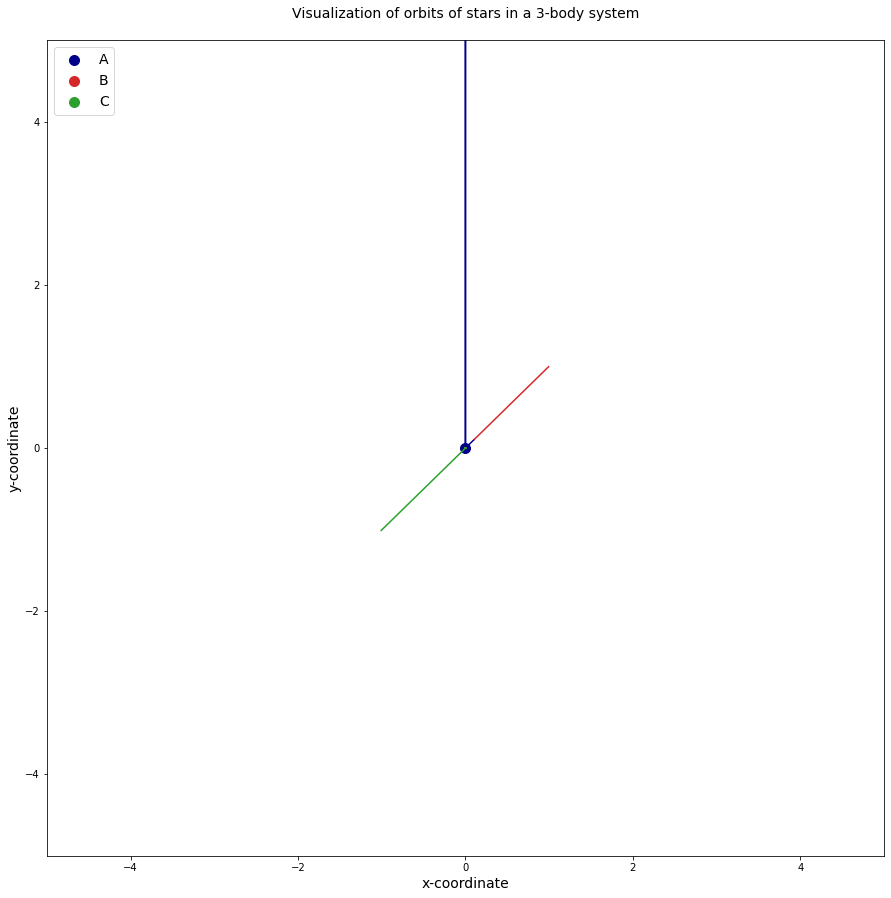

/usr/local/lib/python3.6/dist-packages/scipy/integrate/odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: RuntimeWarning: invalid value encountered in subtract
/usr/local/lib/python3.6/dist-packages/numpy/linalg/linalg.py:2506: RuntimeWarning: overflow encountered in multiply
  
/usr/local/lib/python3.6/dist-packages/stable_baselines3/common/vec_env/vec_check_nan.py:86: UserWarning: found nan in rewards.
Originated from the environment, Last given value was: 
	action=[[-0.05408523  0.82303727  0.5061074  -0.2029385 ]]
  warnings.warn(msg, UserWarning)


In [ ]:
check_(CustomEnv2DT())

[ 0.9948346  -0.00328425] [-0.99448514 -0.00867811] [0.005098945498466492, -1.0059238004684448] [-0.005098945498466492, 1.0059238004684448] 100.0


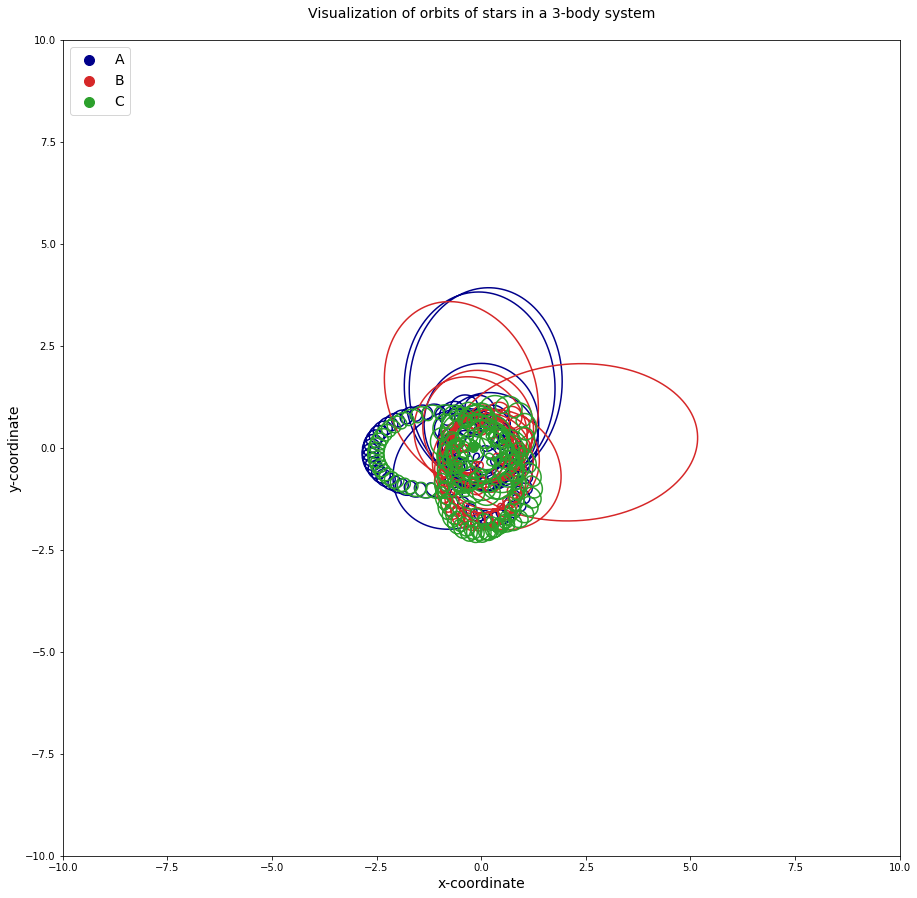

In [ ]:
check_(CustomEnv2DT_V())

# Model Train & Evaluate


## Train & Save Function


In [ ]:
def model_train(cusenv, alg, timestep, tag='', tensorboard_save = True):
  path = "/content/drive/My Drive/Termpaper/model/"
  timestep = timestep
  tag = tag
  env = cusenv
  name = env.name

  from datetime import date
  today = date.today().strftime("%y%m%d")

  tensorboard_path = f"./{name}_{alg}_demo_tensorboard_{timestep}_{today}/"
  path_save = path + name + f"{alg}_{timestep}_{today}" + tag

  if alg is not None:
    if alg == "A2C":
      from stable_baselines3 import A2C
      from stable_baselines3.a2c import MlpPolicy
      from stable_baselines3.common.env_util import make_vec_env
      %xmode Verbose
      model = A2C('MlpPolicy', env, verbose=1, tensorboard_log=tensorboard_path)
      model.learn(total_timesteps=timestep)
      model.save(path_save)

    elif alg == "SAC":
      from stable_baselines3 import SAC
      from stable_baselines3.sac import MlpPolicy
      %xmode Verbose
      model = SAC(MlpPolicy, env, verbose=1, tensorboard_log=tensorboard_path)
      model.learn(total_timesteps=timestep)
      model.save(path_save)

    elif alg == "PPO":
      from stable_baselines3 import PPO
      from stable_baselines3.ppo import MlpPolicy
      from stable_baselines3.common.env_util import make_vec_env
      %xmode Verbose     
      model = PPO(MlpPolicy, env, verbose=1, tensorboard_log=tensorboard_path)
      model.learn(total_timesteps=timestep)
      model.save(path_save)

    elif alg == "TD3":
      from stable_baselines3 import TD3
      from stable_baselines3.td3.policies import MlpPolicy
      from stable_baselines3.common.vec_env import DummyVecEnv
      from stable_baselines3.common.noise import NormalActionNoise, OrnsteinUhlenbeckActionNoise
      %xmode Verbose
      n_actions = env.action_space.shape[-1]
      action_noise = NormalActionNoise(mean=np.zeros(n_actions), sigma=0.1 * np.ones(n_actions))
      model = TD3(MlpPolicy, env, action_noise=action_noise, verbose=1,tensorboard_log=tensorboard_path)
      model.learn(total_timesteps=timestep)
      model.save(path_save)

    else:
      print("Algorithm Error: Not Supported. Choose one of [A2C, SAC, PPO, TD3]")
      exit()
      
    %load_ext tensorboard
    %tensorboard --logdir {tensorboard_path}
  else:
    print("None algorithm captured")
    exit()

  if tensorboard_save:
    import os

    save_path =  f"/content/drive/MyDrive/Termpaper/logs/{name}_{alg}_demo_tensorboard_{timestep}_{today}"
    if os.path.exists(save_path):
      shutil.rmtree(save_path)
    else:
      pass

    shutil.copytree(f"/content/{name}_{alg}_demo_tensorboard_{timestep}_{today}/", save_path)
    # log re-save
  else:
    pass

  print("path : ", path_save)


In [ ]:
def tensorboard_reload(path):
  import os

  save_path =  path
  default_path = "./tensorboard_logs"
  if os.path.exists(default_path):
    shutil.rmtree(default_path)
  else:
    pass

  shutil.copytree(path, default_path)

  if path is not None:
    %load_ext tensorboard
    %tensorboard --logdir {tensorboard_path}  
  else:
    print("None imput Error")
    exit()



## Train & Save


In [ ]:
#def model_train(env, alg, timestep, tag='', tensorboard_save = True):

model_train(CustomEnv2DT_V(), 'SAC', 10000, tag='')

In [ ]:
#def model_train(env, alg, timestep, tag='', tensorboard_save = True):

model_train(CustomEnv2DT_V(), 'PPO', 25000, tag='')

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
# def tensorboard_reload(path):
#def model_train(env, alg, timestep, tag='', tensorboard_save = True):

model_train(CustomEnv2DT_V(), 'A2C', 10000, tag='')

In [ ]:
#def model_train(env, alg, timestep, tag='', tensorboard_save = True):

model_train(CustomEnv2DT_V(), 'TD3', 10000, tag='')

Output hidden; open in https://colab.research.google.com to view.

#Algorhithm - Indivi.

In [ ]:
from stable_baselines3 import A2C
from stable_baselines3.a2c import MlpPolicy
from stable_baselines3.common.env_util import make_vec_env


env = CustomEnv2()
%xmode Verbose

model = A2C('MlpPolicy', env, verbose=1, tensorboard_log="./a2c_demo_tensorboard/")
model.learn(total_timesteps=timestep)
path = "./a2c_demo_tensorboard/"

model.save(f"/content/drive/My Drive/Termpaper/model/a2c_demo_{timestep}_{today}")



%load_ext tensorboard
%tensorboard --logdir {path}

In [ ]:
path = "/content/drive/MyDrive/Termpaper/logs/2dt_ppo_demo_tensorboard_10000_201126"
%load_ext tensorboard
%tensorboard --logdir {path}
#이ㅣ렇게 변수화 !

In [ ]:
from stable_baselines3 import SAC
from stable_baselines3.sac import MlpPolicy


env = CustomEnv2()
%xmode Verbose
timestep = 20000

model = SAC(MlpPolicy, env, verbose=1, tensorboard_log="./sac_demo_tensorboard/")
model.learn(total_timesteps=timestep)

from datetime import date

today = date.today().strftime("%y%m%d")

model.save(f"/content/drive/My Drive/Termpaper/model/sac_demo_{timestep}_{today}")


%load_ext tensorboard
%tensorboard --logdir ./sac_demo_tensorboard/

In [ ]:
from stable_baselines3 import SAC
from stable_baselines3.sac import MlpPolicy


env = CustomEnv2DT()
%xmode Verbose
timestep = 10000

model = SAC(MlpPolicy, env, verbose=1, tensorboard_log="./2dt_sac_demo_tensorboard/")
model.learn(total_timesteps=timestep)

from datetime import date

today = date.today().strftime("%y%m%d")
tag = '5moredone'

model.save(f"/content/drive/My Drive/Termpaper/model/2dt_sac_demo_{timestep}_{today}_{tag}")


%load_ext tensorboard
%tensorboard --logdir ./2dt_sac_demo_tensorboard/

import os

save_path =  f"/content/drive/MyDrive/Termpaper/logs/2dt_sac_demo_tensorboard_{timestep}_{today}"
if os.path.exists(save_path):
      shutil.rmtree(save_path)
else:
  pass

shutil.copytree("/content/2dt_sac_demo_tensorboard/", save_path)
# log re-save

In [ ]:
from stable_baselines3 import PPO
from stable_baselines3.ppo import MlpPolicy
from stable_baselines3.common.env_util import make_vec_env

env = CustomEnv2()

%xmode Verbose
timestep = 10000

model = PPO(MlpPolicy, env, verbose=1, tensorboard_log="./ppo_demo_tensorboard/")
model.learn(total_timesteps=timestep)

from datetime import date

today = date.today().strftime("%y%m%d")

model.save(f"/content/drive/My Drive/Termpaper/model/ppo_demo_{timestep}_{today}")


%load_ext tensorboard
%tensorboard --logdir ./ppo_demo_tensorboard/

In [ ]:
import warnings
warnings.filterwarnings("ignore")

In [ ]:
from stable_baselines3 import PPO
from stable_baselines3.ppo import MlpPolicy
from stable_baselines3.common.env_util import make_vec_env

env = CustomEnv2DT()
%xmode Verbose
timestep = 12

model = PPO(MlpPolicy, env, verbose=2, tensorboard_log="./2dt_ppo_demo_tensorboard/")
model.learn(total_timesteps=timestep)

from datetime import date

today = date.today().strftime("%y%m%d")
tag = ''

model.save(f"/content/drive/My Drive/Termpaper/model/2dt_ppo_demo_{timestep}_{today}_{tag}")


%load_ext tensorboard
%tensorboard --logdir ./2dt_ppo_demo_tensorboard/

import os

save_path =  f"/content/drive/MyDrive/Termpaper/logs/2dt_ppo_demo_tensorboard_{timestep}_{today}"
if os.path.exists(save_path):
      shutil.rmtree(save_path)
else:
  pass

shutil.copytree("/content/2dt_ppo_demo_tensorboard/", save_path)
# log re-save

## 틀

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
from stable_baselines3 import TD3
from stable_baselines3.td3.policies import MlpPolicy
from stable_baselines3.common.vec_env import DummyVecEnv
from stable_baselines3.common.noise import NormalActionNoise, OrnsteinUhlenbeckActionNoise

env = CustomEnv2()

n_actions = env.action_space.shape[-1]
action_noise = NormalActionNoise(mean=np.zeros(n_actions), sigma=0.1 * np.ones(n_actions))

%xmode Verbose
timestep = 10000

model = TD3(MlpPolicy, env, action_noise=action_noise, verbose=1, tensorboard_log="./td3_demo_tensorboard/")
model.learn(total_timesteps=timestep)

from datetime import date

today = date.today().strftime("%y%m%d")

model.save(f"/content/drive/My Drive/Termpaper/model/td3_demo_{timestep}_{today}")


%load_ext tensorboard
%tensorboard --logdir ./td3_demo_tensorboard/

In [ ]:
from stable_baselines3 import TD3
from stable_baselines3.td3.policies import MlpPolicy
from stable_baselines3.common.vec_env import DummyVecEnv
from stable_baselines3.common.noise import NormalActionNoise, OrnsteinUhlenbeckActionNoise

env = CustomEnv2DT_V()

n_actions = env.action_space.shape[-1]
action_noise = NormalActionNoise(mean=np.zeros(n_actions), sigma=0.1 * np.ones(n_actions))

%xmode Verbose
timestep = 1000

model = TD3(MlpPolicy, env, action_noise=action_noise, verbose=1, tensorboard_log="./2dt_td3_demo_tensorboard/")
model.learn(total_timesteps=timestep)

from datetime import date

today = date.today().strftime("%y%m%d")

model.save(f"/content/drive/My Drive/Termpaper/model/2dt_td3_demo_{timestep}_{today}")


%load_ext tensorboard
%tensorboard --logdir ./2dt_td3_demo_tensorboard/

# 문제가 있음, TD3에대한 이해부족으로 안건들거

###HER_sac

In [ ]:
from stable_baselines3 import HER, DDPG, DQN, SAC, TD3
from stable_baselines3.her.goal_selection_strategy import GoalSelectionStrategy
from stable_baselines3.common.bit_flipping_env import BitFlippingEnv
from stable_baselines3.common.vec_env import DummyVecEnv
from stable_baselines3.common.vec_env.obs_dict_wrapper import ObsDictWrapper

env = CustomEnv2()
model_class = SAC
%xmode Verbose
timestep = 10000
# Available strategies (cf paper): future, final, episode
# If True the HER transitions will get sampled online
online_sampling = True
goal_selection_strategy = 'future'
model = HER('MlpPolicy', env, model_class, n_sampled_goal=4, goal_selection_strategy=goal_selection_strategy, max_episode_length=100, verbose=1,tensorboard_log="./HER_sac_demo_tensorboard/")

model.learn(total_timesteps=timestep)

from datetime import date

today = date.today().strftime("%y%m%d")

model.save(f"/content/gdrive/My Drive/Termpaper/model/HER_sac_demo_{timestep}_{today}")


%load_ext tensorboard
%tensorboard --logdir ./HER_sac_demo_tensorboard/

Exception reporting mode: Verbose
Using cpu device


AttributeError: ignored

## Advanced Tensorboard - with online kernel Saving

In [ ]:
%load_ext tensorboard
%tensorboard --logdir ./a2c_demo_tensorboard/


# !tensorboard dev upload --logdir ./logs \
#   --name "3body_RL - A2C 10000" \
#   --description "Copyright, JeaYong Bae " \
#   --one_shot

In [ ]:
!tensorboard dev upload --logdir ./a2c_demo_tensorboard \
  --name f"3body_RL - A2C {timestep} - {today}" \
  --description "Copyright, JeaYong Bae " \
  --one_shot

  !tensorboard dev list

In [ ]:
# !tensorboard dev delete --experiment_id YOUR_EXPERIMENT_ID_HERE

#Model load

##model load - Function

In [ ]:
# del model # remove to demonstrate saving and loading
from stable_baselines3 import A2C
from stable_baselines3 import SAC
from stable_baselines3 import TD3
from stable_baselines3 import PPO

def model_load(alg, path):
  if alg == 0:
    model = A2C.load(path)
  elif alg == 1:
    model = SAC.load(path)
  elif alg == 2:
    model = PPO.load(path)
  elif alg == 3:
    model = TD3.load(path)
  else:
    print("input err")

  return model

##model load

In [ ]:
#[A2C, SAC, PPO, TD3]
#take num
path = "/content/drive/My Drive/Termpaper/model/2D_T_VA2C_10000_201127"
model_load(0, path)

env = CustomEnv2DT()
obs = env.reset()
for _ in range(1000):
    action, _states = model.predict(obs)
    obs, rewards, dones, info = env.step(action)
    print("steps:",_+1, "info", rewards, info, dones)

    if _ > 900:
        env.render()
        print("steps:",_+1, "info:",rewards, info)

In [ ]:
#[A2C, SAC, PPO, TD3]
#take num
path = "/content/drive/My Drive/Termpaper/model/2D_T_VSAC_10000_201127"
model_load(1, path)

env = CustomEnv2DT()
obs = env.reset()
for _ in range(1000):
    action, _states = model.predict(obs)
    obs, rewards, dones, info = env.step(action)
    print("steps:",_+1, "info", rewards, info, dones)

    if _ > 900:
        env.render()
        print("steps:",_+1, "info:",rewards, info)

In [ ]:
#[A2C, SAC, PPO, TD3]
#take num
path = "/content/drive/My Drive/Termpaper/model/2D_T_VPPO_10000_201127"
model_load(2, path)

env = CustomEnv2DT()
obs = env.reset()
for _ in range(1000):
    action, _states = model.predict(obs)
    obs, rewards, dones, info = env.step(action)
    print("steps:",_+1, "info", rewards, info, dones)

    if _ > 900:
        env.render()
        print("steps:",_+1, "info:",rewards, info)

In [ ]:
#[A2C, SAC, PPO, TD3]
#take num
path = "/content/drive/My Drive/Termpaper/model/2D_T_VTD3_10000_201127"
model_load(3, path)

env = CustomEnv2DT()
obs = env.reset()
for _ in range(1000):
    action, _states = model.predict(obs)
    obs, rewards, dones, info = env.step(action)
    print("steps:",_+1, "info", rewards, info, dones)

    if _ > 900:
        env.render()
        print("steps:",_+1, "info:",rewards, info)

In [ ]:
#[A2C, SAC, PPO, TD3]
#take num
path = "/content/drive/My Drive/Termpaper/model/2D_T_VTD3_10000_201128"
model = model_load(3, path)
%xmode Verbose

env = CustomEnv2DT_V()
obs = env.reset()
best_reward = None
for _ in range(100):
    action, _states = model.predict(obs)
    obs, rewards, dones, info = env.step(action)
    # print("steps", _ , "info", info)
    env.render()
    if dones == False:
      if best_reward is not None:
        if rewards > best_reward:
          print("steps:",_+1, "info", rewards, info, dones)
          env.render()

          best_reward = rewards
        else:
          pass
      else:
        if rewards is not None:
          best_reward = rewards
    


Output hidden; open in https://colab.research.google.com to view.

Exception reporting mode: Verbose
steps: 3 info -33307.65625 {'r2_init': [0.987654286623001, 0.017854090183973312], 'r3_init': [-0.9784218800067901, -0.00287660769186914], 'v2_init': [-0.001795281767845154, -1.0201806223392487], 'v3_init': [0.001795281767845154, 1.0201806223392487], 'period': 5001, 'period(s)': 100.02} False
[0.98765427 0.01785409] [-0.97842187 -0.00287661] [-0.001795281767845154, -1.0201806223392487] [0.001795281767845154, 1.0201806223392487] 100.02


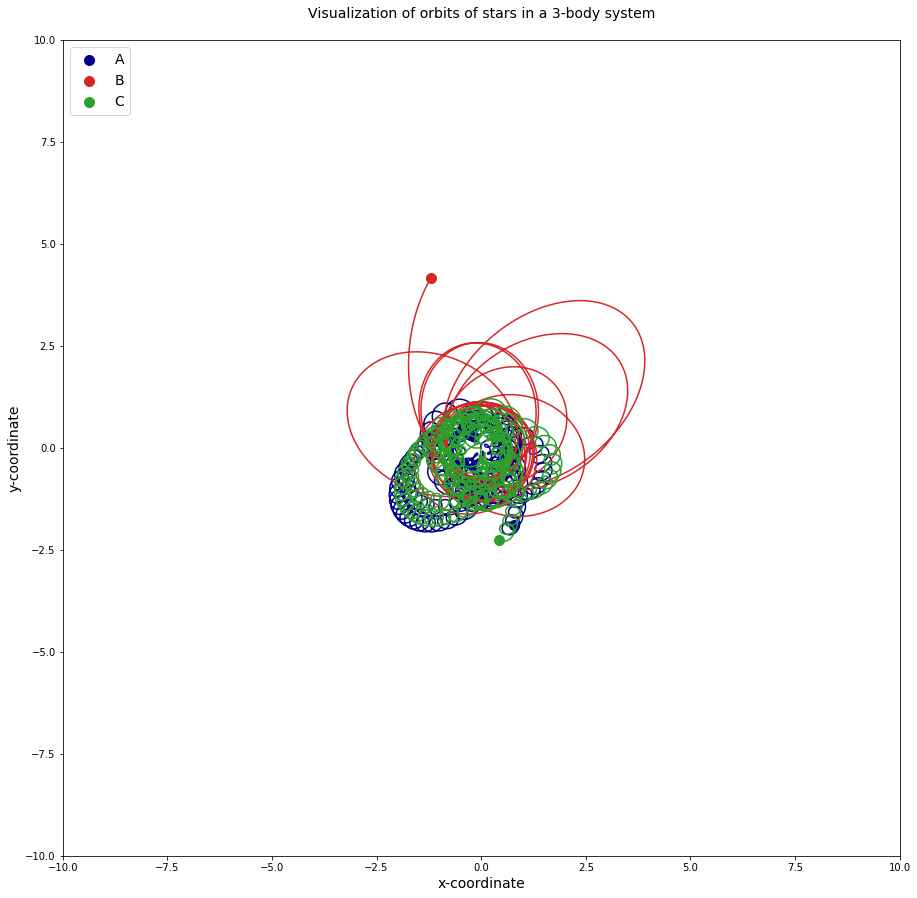

steps: 6 info -27707.595703125 {'r2_init': [0.9999907648563385, 0.018804860264062882], 'r3_init': [-0.9651305907964706, 0.0037254940811544644], 'v2_init': [-0.014694960080087185, -1.0202991184592247], 'v3_init': [0.014694960080087185, 1.0202991184592247], 'period': 4999, 'period(s)': 99.98} False
[0.99999076 0.01880486] [-0.96513057  0.00372549] [-0.014694960080087185, -1.0202991184592247] [0.014694960080087185, 1.0202991184592247] 99.98


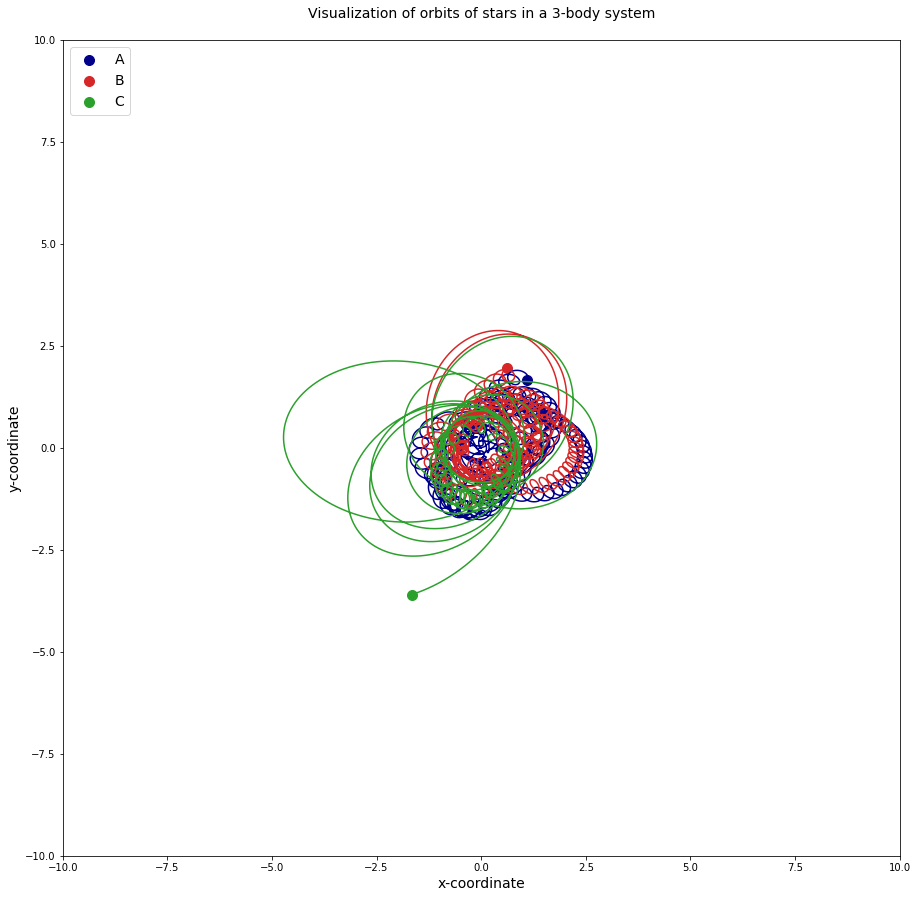

steps: 35 info -21546.4453125 {'r2_init': [1.016143713444471, 0.021256370106711987], 'r3_init': [-0.9399825990572569, 0.036556250350549824], 'v2_init': [-0.05192318014800549, -1.0576639986783265], 'v3_init': [0.05192318014800549, 1.0576639986783265], 'period': 4997, 'period(s)': 99.94} False
[1.0161437  0.02125637] [-0.9399826   0.03655625] [-0.05192318014800549, -1.0576639986783265] [0.05192318014800549, 1.0576639986783265] 99.94


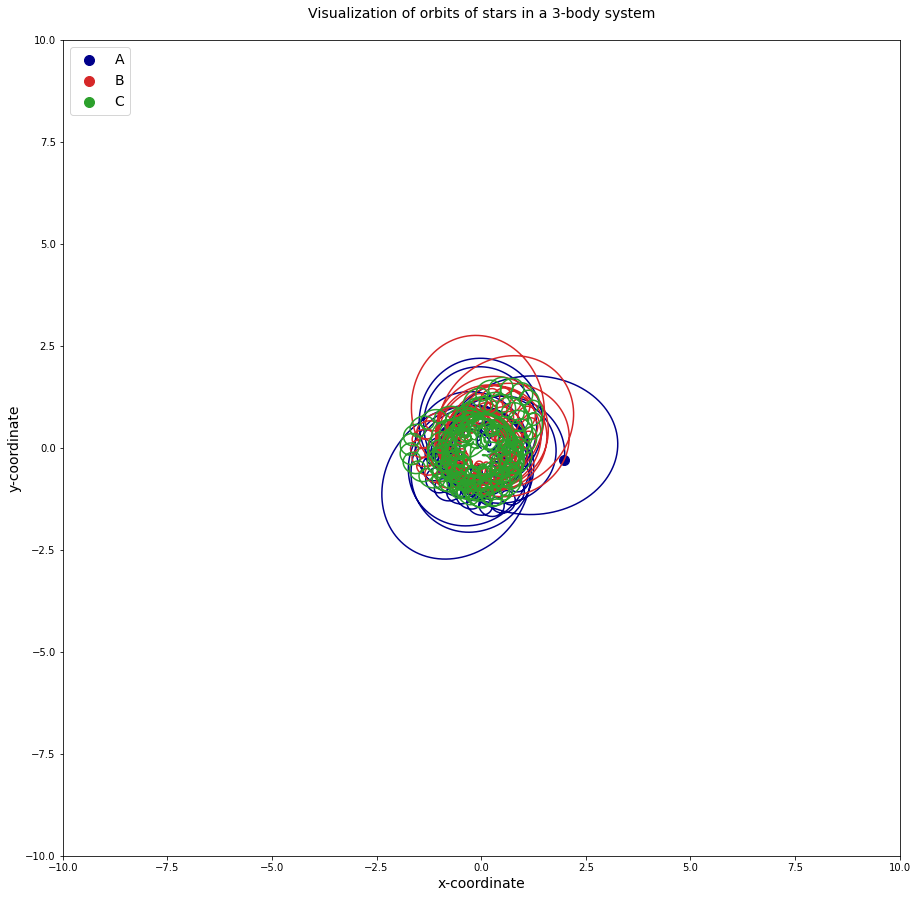

steps: 78 info -21366.6484375 {'r2_init': [1.0454669907689094, 0.03133720335550606], 'r3_init': [-0.9551672651991248, -0.008741471087560043], 'v2_init': [-0.03591884493827818, -1.026781810279936], 'v3_init': [0.03591884493827818, 1.026781810279936], 'period': 4988, 'period(s)': 99.76} False
[1.045467  0.0313372] [-0.9551673  -0.00874147] [-0.03591884493827818, -1.026781810279936] [0.03591884493827818, 1.026781810279936] 99.76


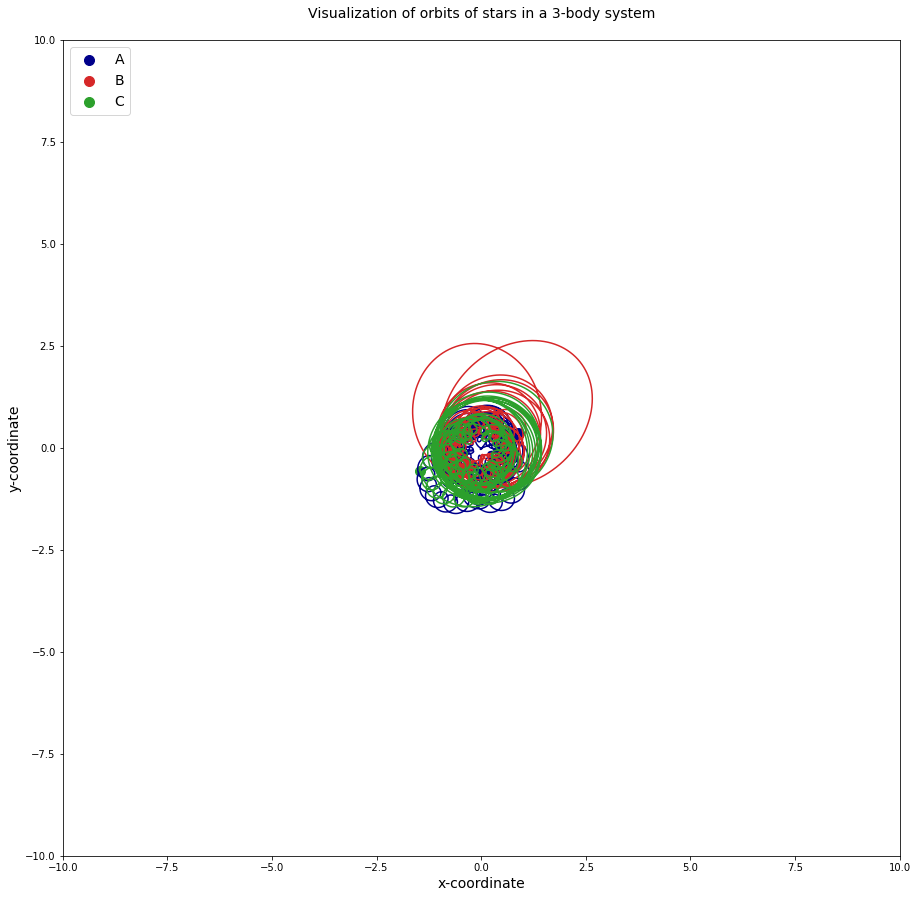

steps: 108 info -19928.98046875 {'r2_init': [1.1538993616402156, -0.004574636733159424], 'r3_init': [-0.9905604216083882, -0.004662813125178205], 'v2_init': [-0.06840785681270062, -1.054745143782348], 'v3_init': [0.06840785681270062, 1.054745143782348], 'period': 4985, 'period(s)': 99.7} False
[ 1.1538993  -0.00457464] [-0.9905604  -0.00466281] [-0.06840785681270062, -1.054745143782348] [0.06840785681270062, 1.054745143782348] 99.7


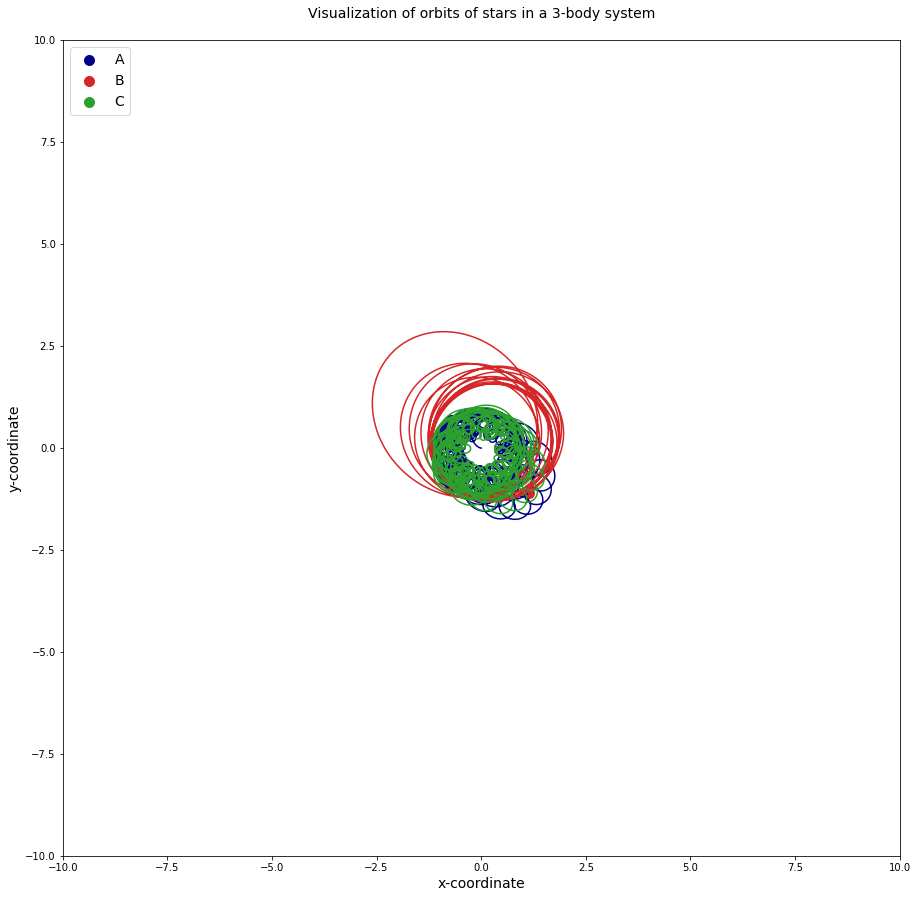

steps: 112 info -16485.71875 {'r2_init': [1.1416224209964283, -0.010943857571110133], 'r3_init': [-1.011517957113683, -0.020377312479540693], 'v2_init': [-0.057977734794840204, -1.0694890112988655], 'v3_init': [0.057977734794840204, 1.0694890112988655], 'period': 4986, 'period(s)': 99.72} False
[ 1.1416224  -0.01094386] [-1.011518   -0.02037731] [-0.057977734794840204, -1.0694890112988655] [0.057977734794840204, 1.0694890112988655] 99.72


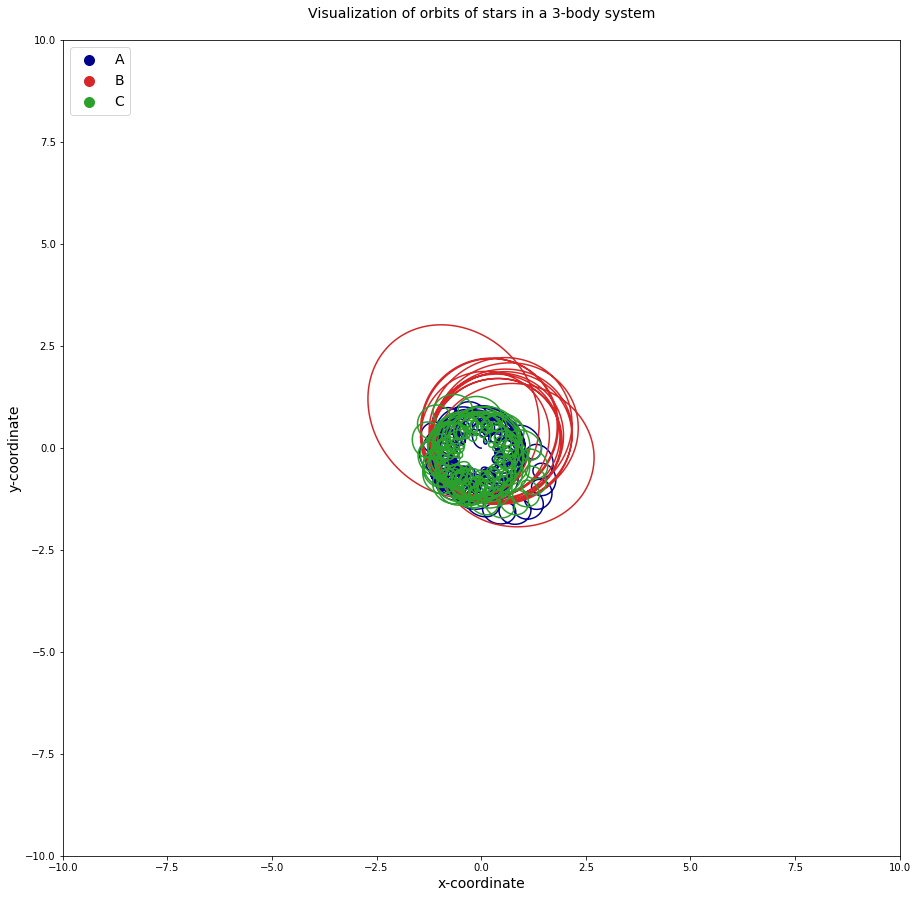

steps: 351 info -15908.505859375 {'r2_init': [1.259632021076979, -0.0242038364615291], 'r3_init': [-0.8696557492762794, 0.13659848557785162], 'v2_init': [0.13061797312926496, -0.9412932262662801], 'v3_init': [-0.13061797312926496, 0.9412932262662801], 'period': 4996, 'period(s)': 99.92} False
[ 1.259632   -0.02420384] [-0.8696557   0.13659848] [0.13061797312926496, -0.9412932262662801] [-0.13061797312926496, 0.9412932262662801] 99.92


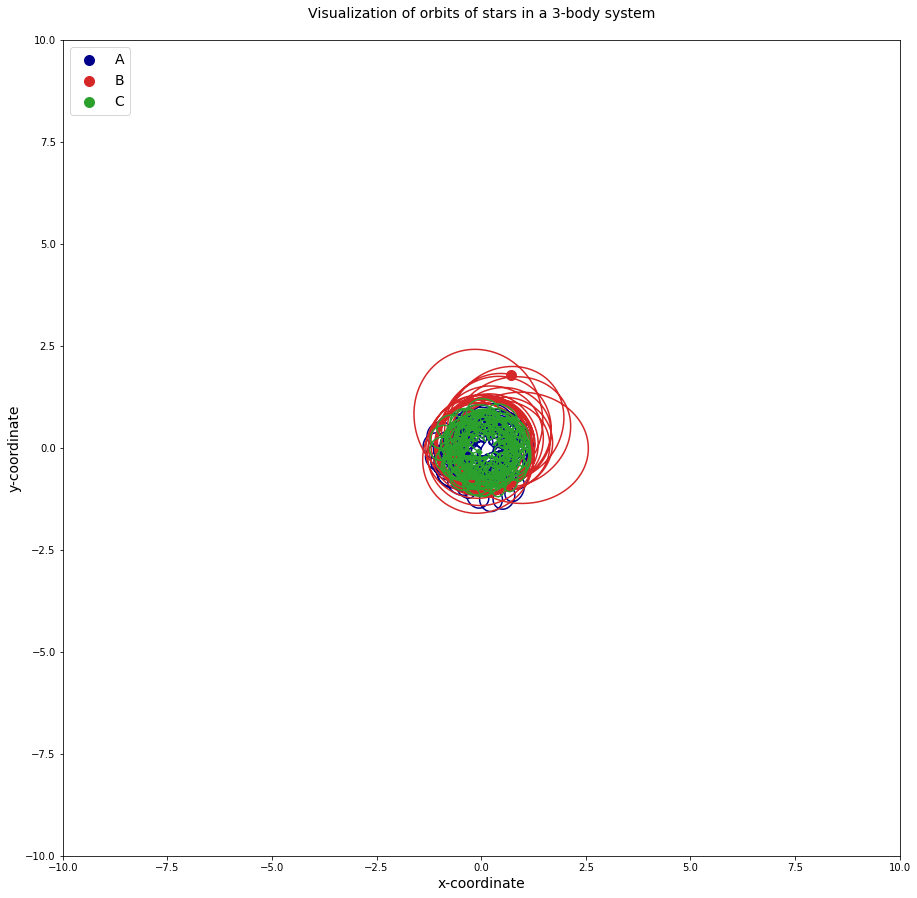

steps: 427 info -9958.94921875 {'r2_init': [1.3519406131282463, -0.01371344844810659], 'r3_init': [-0.7539677143096915, 0.21808021886274212], 'v2_init': [0.060391918388195326, -0.9394192141201348], 'v3_init': [-0.060391918388195326, 0.9394192141201348], 'period': 4994, 'period(s)': 99.88} False
[ 1.3519406  -0.01371345] [-0.7539677   0.21808022] [0.060391918388195326, -0.9394192141201348] [-0.060391918388195326, 0.9394192141201348] 99.88


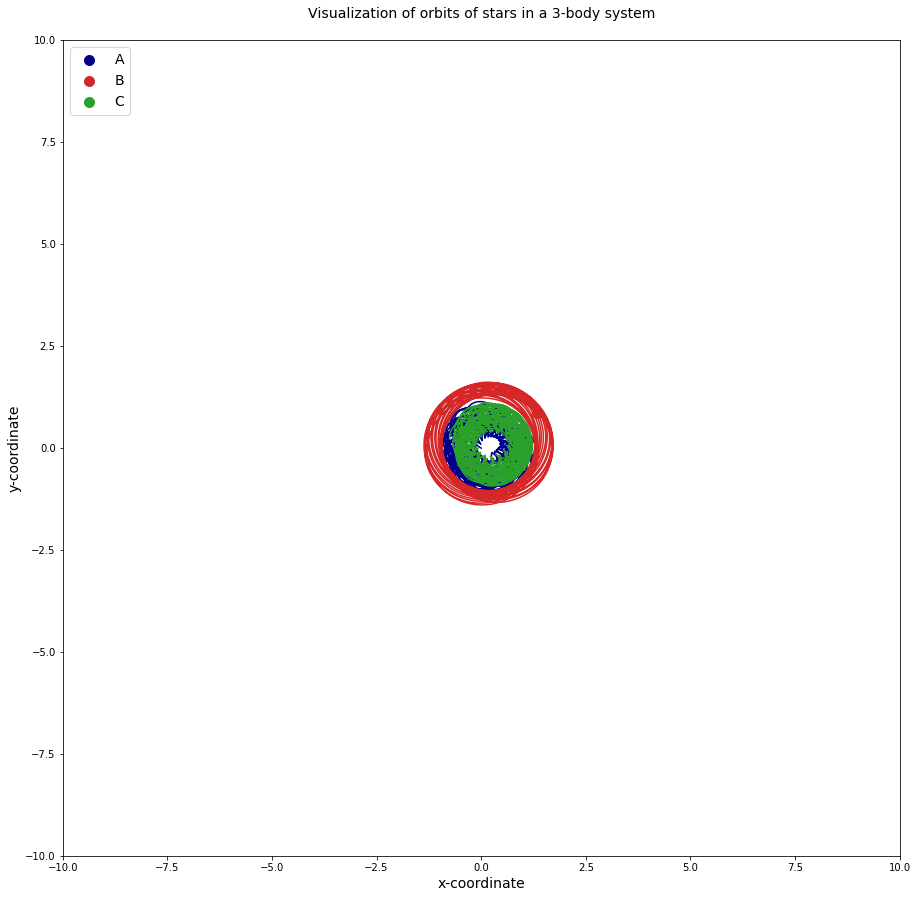

steps: 438 info -9137.7529296875 {'r2_init': [1.370223454125227, 0.007428316073492224], 'r3_init': [-0.7693670025467861, 0.23248177854344246], 'v2_init': [0.061081486311741165, -0.9436636114027355], 'v3_init': [-0.061081486311741165, 0.9436636114027355], 'period': 4997, 'period(s)': 99.94} False
[1.3702234  0.00742832] [-0.769367    0.23248178] [0.061081486311741165, -0.9436636114027355] [-0.061081486311741165, 0.9436636114027355] 99.94


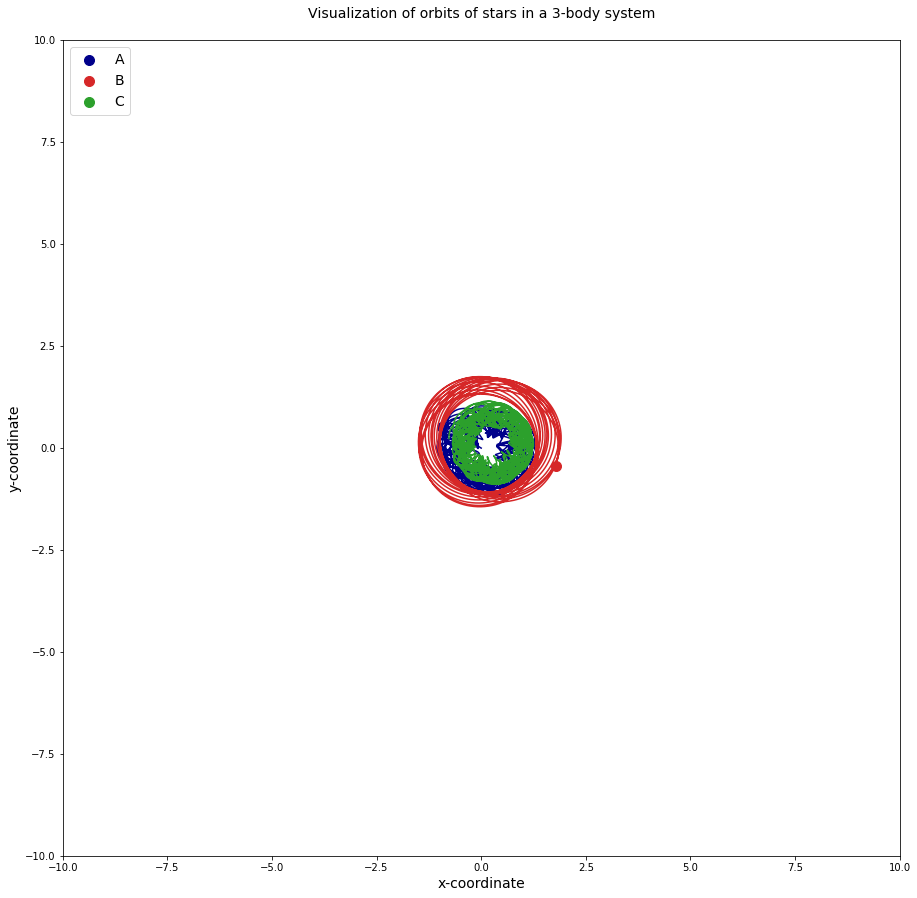

steps: 457 info -7561.6875 {'r2_init': [1.411139320917429, 0.0179597086180002], 'r3_init': [-0.7212367657572017, 0.2563508199341595], 'v2_init': [0.041599365142174057, -0.9408839502837514], 'v3_init': [-0.041599365142174057, 0.9408839502837514], 'period': 4997, 'period(s)': 99.94} False
[1.4111394  0.01795971] [-0.72123677  0.25635082] [0.041599365142174057, -0.9408839502837514] [-0.041599365142174057, 0.9408839502837514] 99.94


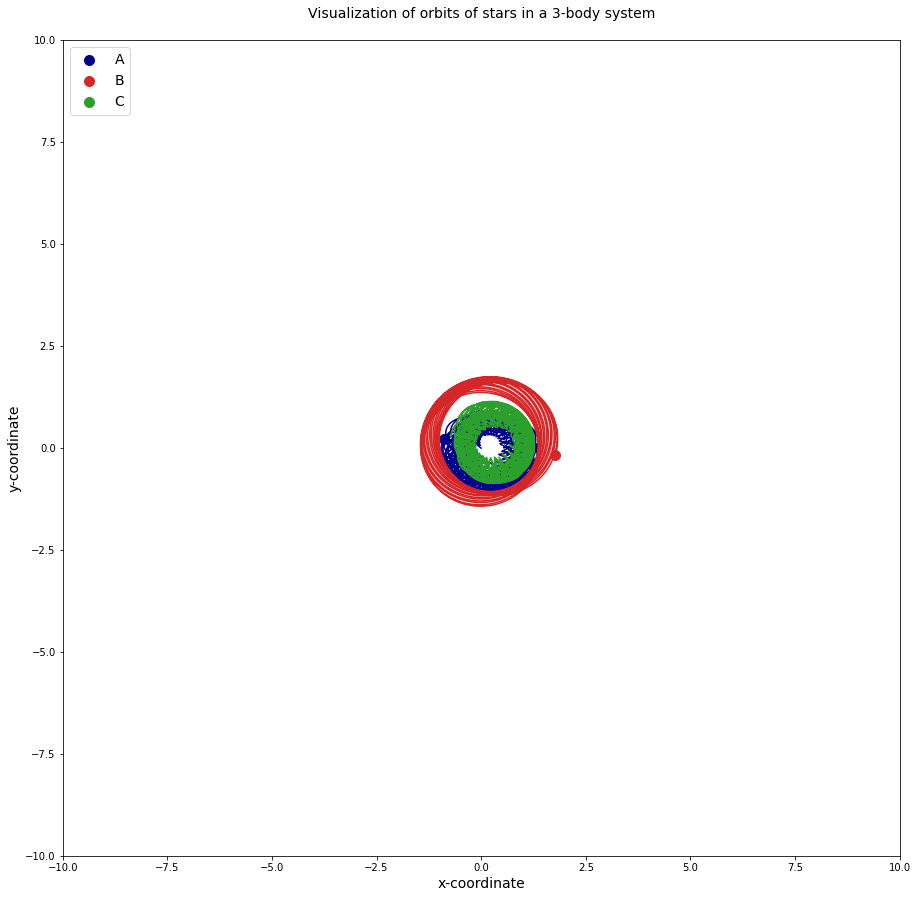

steps: 460 info -7148.04541015625 {'r2_init': [1.418659070320429, 0.021264731930568867], 'r3_init': [-0.7180570403486477, 0.2663508199341595], 'v2_init': [0.047282489803619675, -0.9386948180105542], 'v3_init': [-0.047282489803619675, 0.9386948180105542], 'period': 4997, 'period(s)': 99.94} False
[1.4186591  0.02126473] [-0.71805704  0.2663508 ] [0.047282489803619675, -0.9386948180105542] [-0.047282489803619675, 0.9386948180105542] 99.94


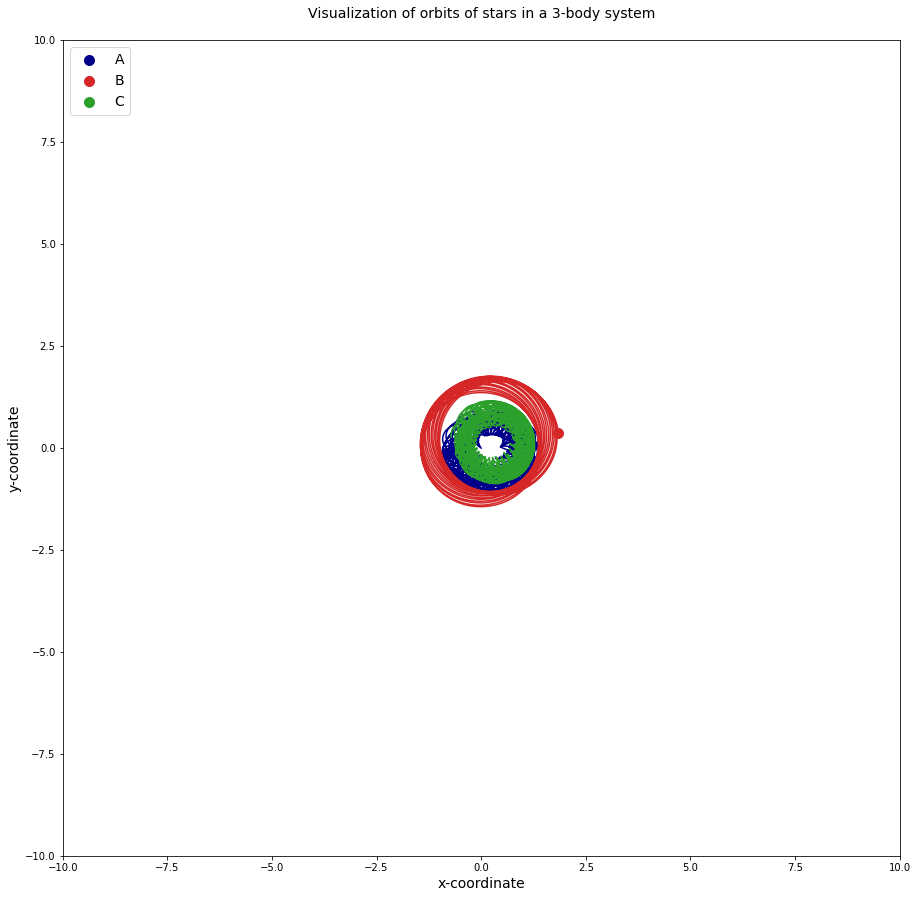

steps: 471 info -6381.697265625 {'r2_init': [1.4016968681290758, 0.04292473276145762], 'r3_init': [-0.6602292303740965, 0.2786029165517538], 'v2_init': [0.006505060163326556, -0.9591650899406527], 'v3_init': [-0.006505060163326556, 0.9591650899406527], 'period': 4998, 'period(s)': 99.96000000000001} False
[1.4016969  0.04292473] [-0.6602292   0.27860293] [0.006505060163326556, -0.9591650899406527] [-0.006505060163326556, 0.9591650899406527] 99.96000000000001


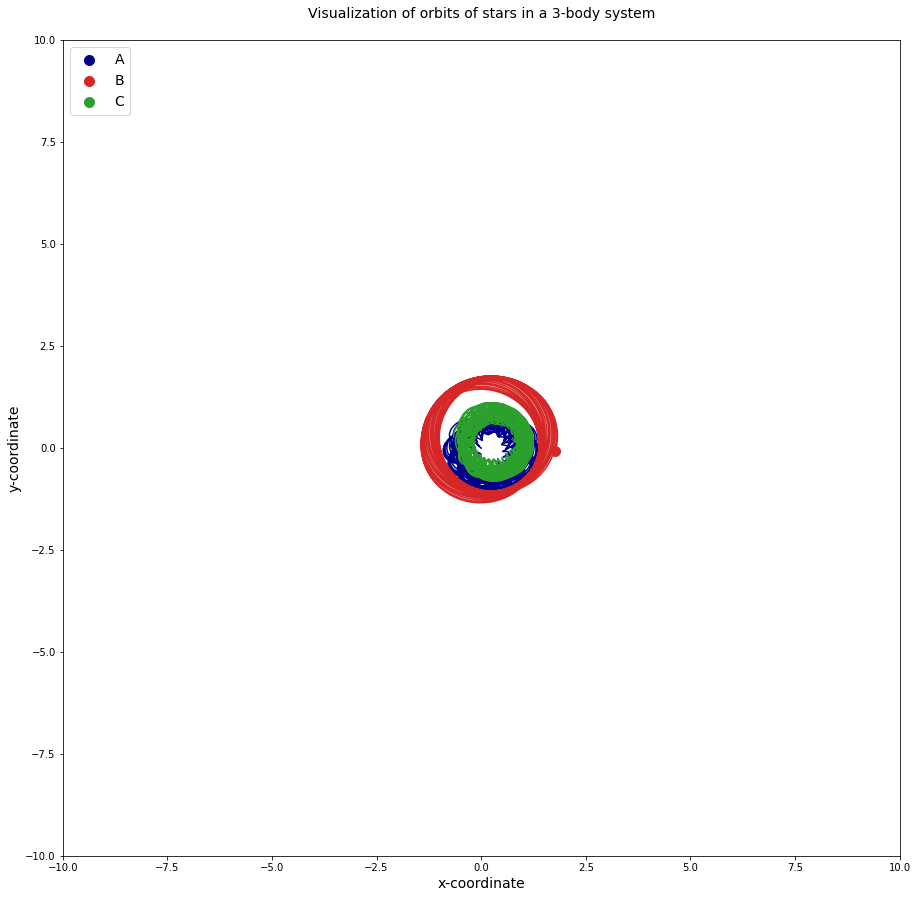

steps: 473 info -6165.5078125 {'r2_init': [1.4034254832938327, 0.023622135119512735], 'r3_init': [-0.6494422856718288, 0.2782176088821142], 'v2_init': [0.006520408955402668, -0.9391650899406527], 'v3_init': [-0.006520408955402668, 0.9391650899406527], 'period': 4997, 'period(s)': 99.94} False
[1.4034255  0.02362213] [-0.6494423  0.2782176] [0.006520408955402668, -0.9391650899406527] [-0.006520408955402668, 0.9391650899406527] 99.94


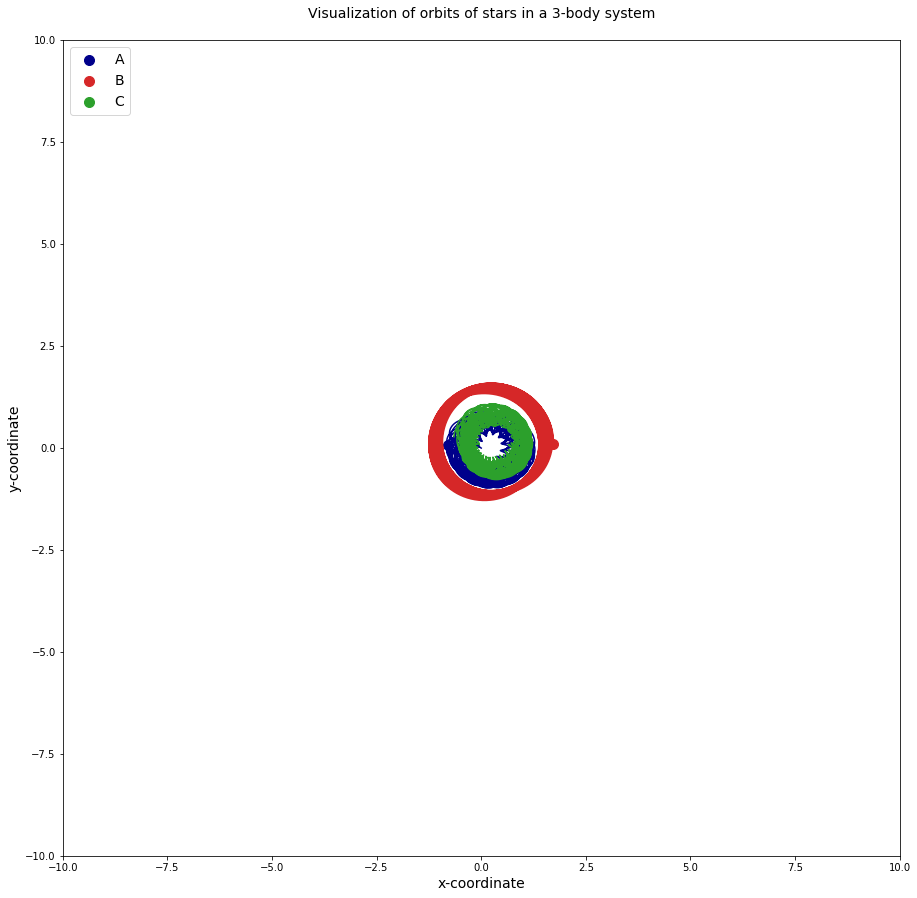

steps: 592 info -5412.11767578125 {'r2_init': [1.4129340529069316, -0.016765530342236122], 'r3_init': [-0.6036362781375632, 0.20459195179864773], 'v2_init': [0.0009511717362329208, -0.9686833064537508], 'v3_init': [-0.0009511717362329208, 0.9686833064537508], 'period': 5003, 'period(s)': 100.06} False
[ 1.4129341  -0.01676553] [-0.60363626  0.20459194] [0.0009511717362329208, -0.9686833064537508] [-0.0009511717362329208, 0.9686833064537508] 100.06


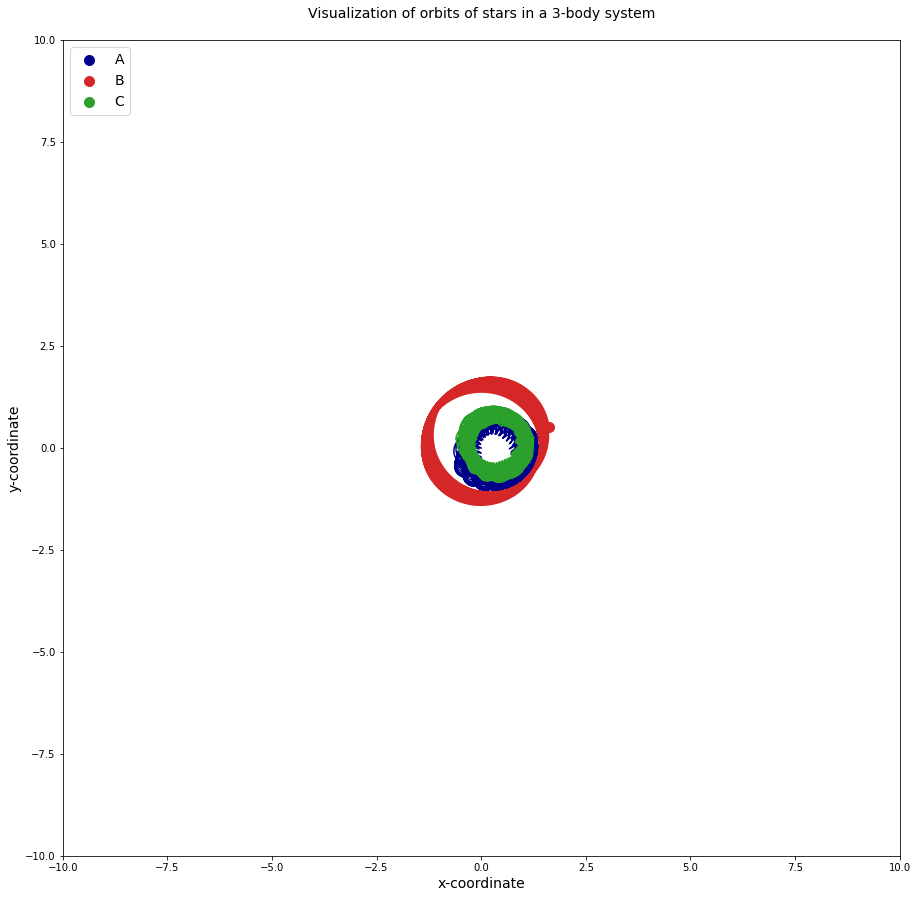

steps: 597 info -4935.1435546875 {'r2_init': [1.4196414565667521, -0.03240309364162382], 'r3_init': [-0.5697837608307584, 0.2104958872683347], 'v2_init': [-0.014333344479091481, -0.9955158143024904], 'v3_init': [0.014333344479091481, 0.9955158143024904], 'period': 5005, 'period(s)': 100.10000000000001} False
[ 1.4196415  -0.03240309] [-0.56978375  0.21049589] [-0.014333344479091481, -0.9955158143024904] [0.014333344479091481, 0.9955158143024904] 100.10000000000001


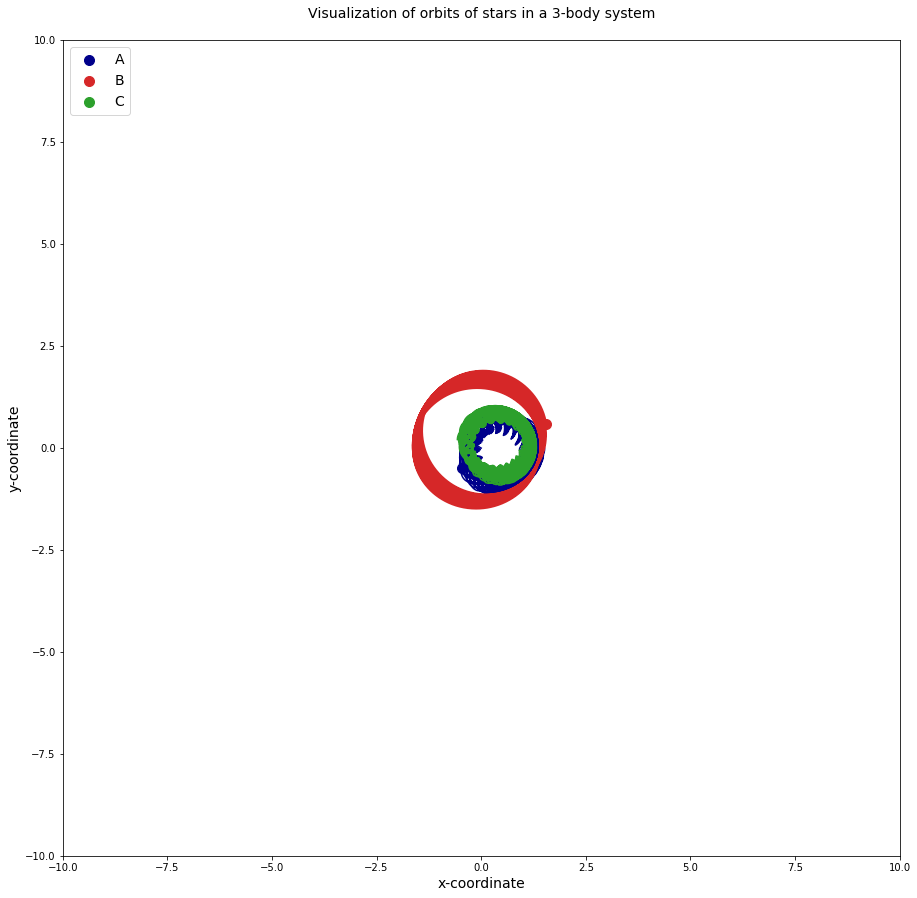

steps: 612 info -4301.55517578125 {'r2_init': [1.434844941161574, -0.019866453725844578], 'r3_init': [-0.6049259833246452, 0.18947902694344526], 'v2_init': [-0.04855485663283618, -0.958149709729479], 'v3_init': [0.04855485663283618, 0.958149709729479], 'period': 5004, 'period(s)': 100.08} False
[ 1.434845   -0.01986645] [-0.604926    0.18947902] [-0.04855485663283618, -0.958149709729479] [0.04855485663283618, 0.958149709729479] 100.08


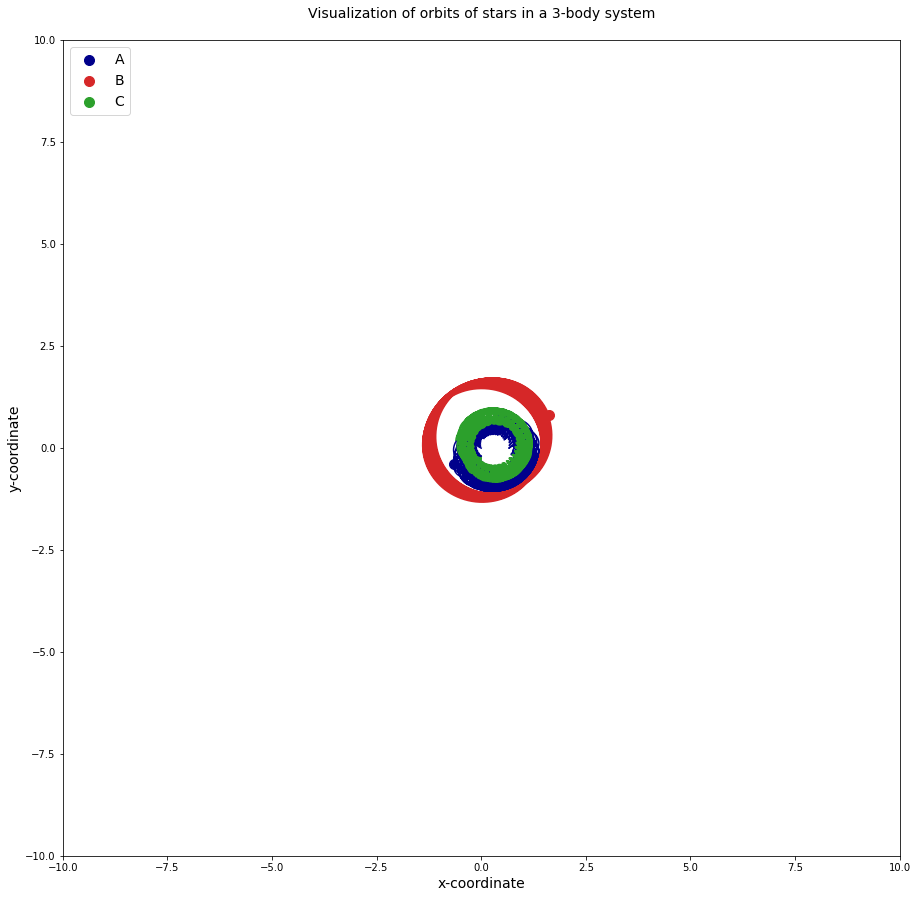

steps: 678 info -4270.529296875 {'r2_init': [1.4529419727996002, -0.12436030754819506], 'r3_init': [-0.5573413181304914, 0.3247098198905587], 'v2_init': [-0.07061184197198603, -0.9033575363177818], 'v3_init': [0.07061184197198603, 0.9033575363177818], 'period': 5013, 'period(s)': 100.26} False
[ 1.452942   -0.12436031] [-0.55734134  0.32470983] [-0.07061184197198603, -0.9033575363177818] [0.07061184197198603, 0.9033575363177818] 100.26


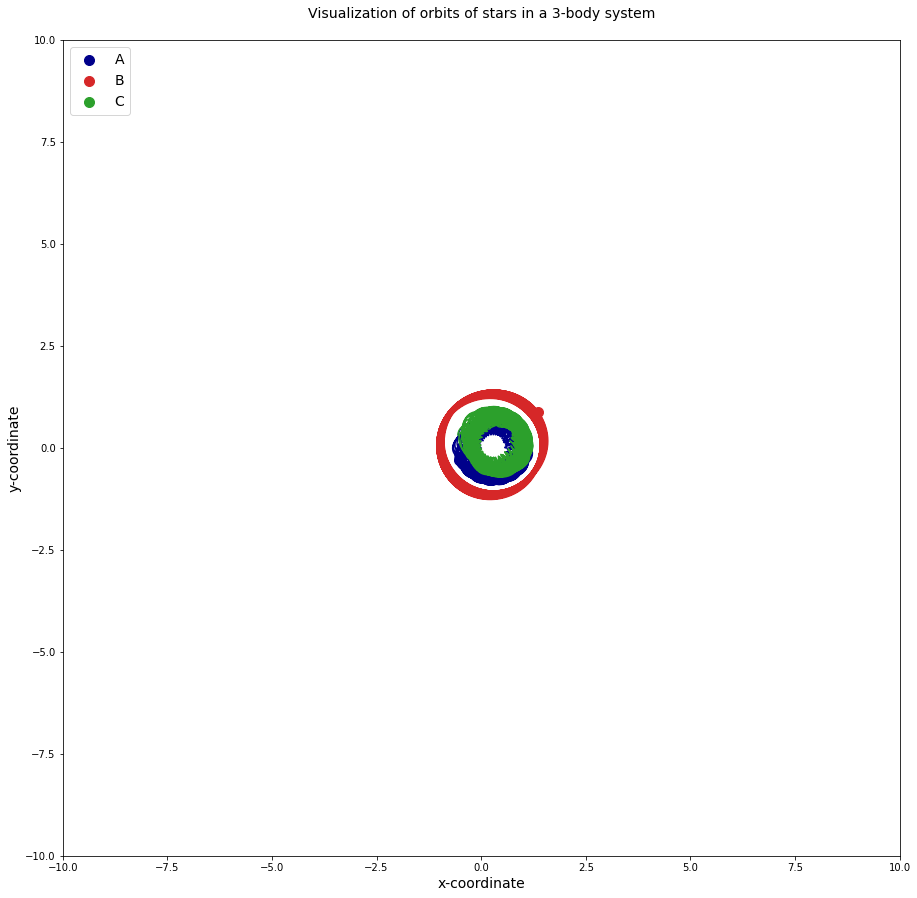

steps: 688 info -4235.58740234375 {'r2_init': [1.4569090098515165, -0.11974637577310196], 'r3_init': [-0.5358910314738733, 0.3272593358159065], 'v2_init': [-0.08687458261381836, -0.8818571243900819], 'v3_init': [0.08687458261381836, 0.8818571243900819], 'period': 5014, 'period(s)': 100.28} False
[ 1.4569091  -0.11974637] [-0.53589106  0.32725933] [-0.08687458261381836, -0.8818571243900819] [0.08687458261381836, 0.8818571243900819] 100.28


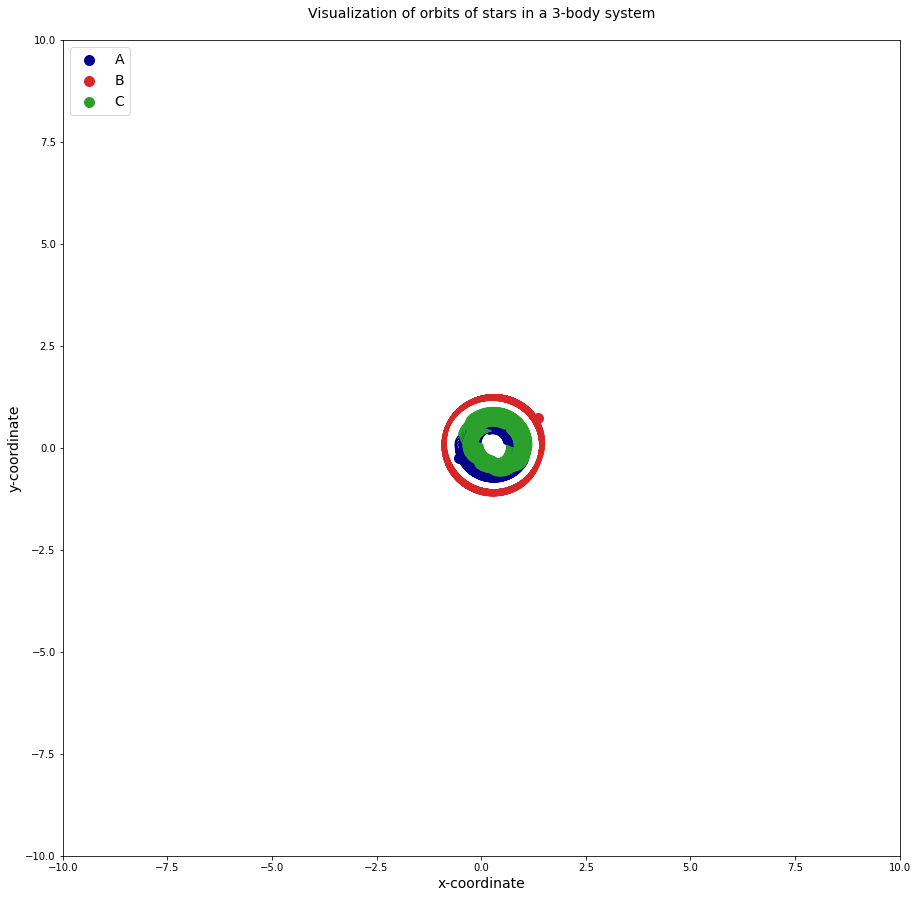

steps: 693 info -4192.005859375 {'r2_init': [1.4469623944535863, -0.12825600335374468], 'r3_init': [-0.5740568090975268, 0.30925651848316194], 'v2_init': [-0.12181305214297028, -0.8750481812376543], 'v3_init': [0.12181305214297028, 0.8750481812376543], 'period': 5014, 'period(s)': 100.28} False
[ 1.4469624  -0.12825601] [-0.5740568   0.30925652] [-0.12181305214297028, -0.8750481812376543] [0.12181305214297028, 0.8750481812376543] 100.28


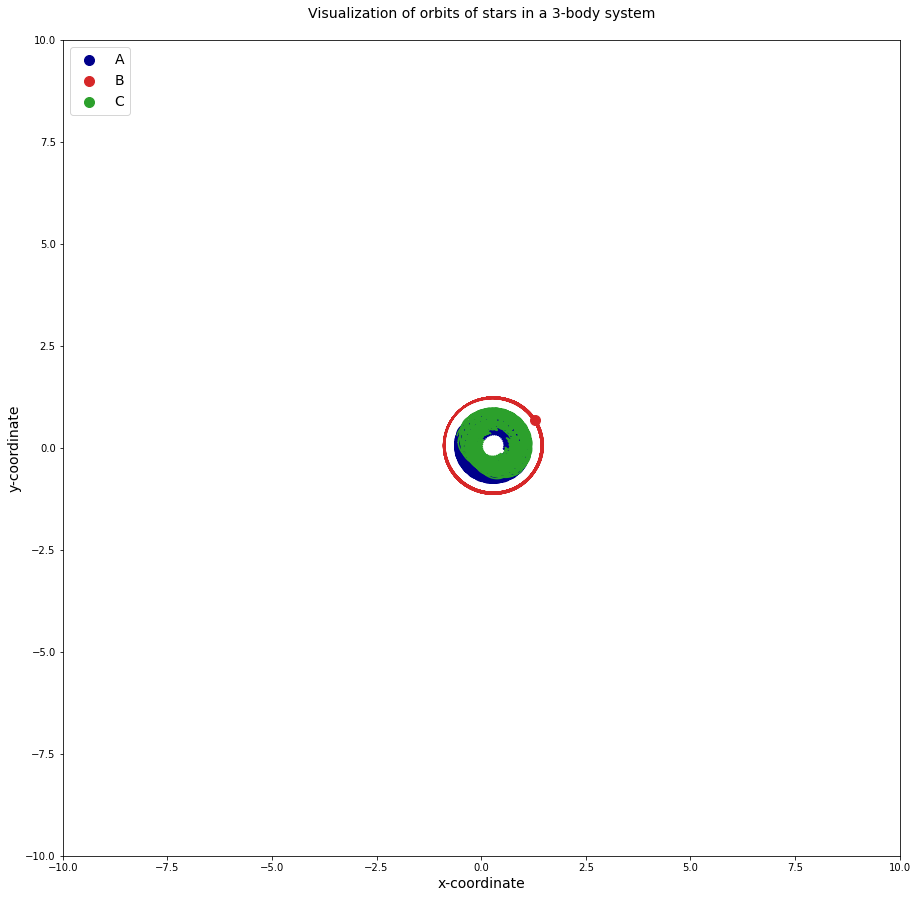

steps: 713 info -3942.8837890625 {'r2_init': [1.4703372625634088, -0.1650776255317032], 'r3_init': [-0.5747335939109308, 0.3055096470098942], 'v2_init': [-0.18701888702344152, -0.8490968309063478], 'v3_init': [0.18701888702344152, 0.8490968309063478], 'period': 5011, 'period(s)': 100.22} False
[ 1.4703373  -0.16507763] [-0.5747336   0.30550966] [-0.18701888702344152, -0.8490968309063478] [0.18701888702344152, 0.8490968309063478] 100.22


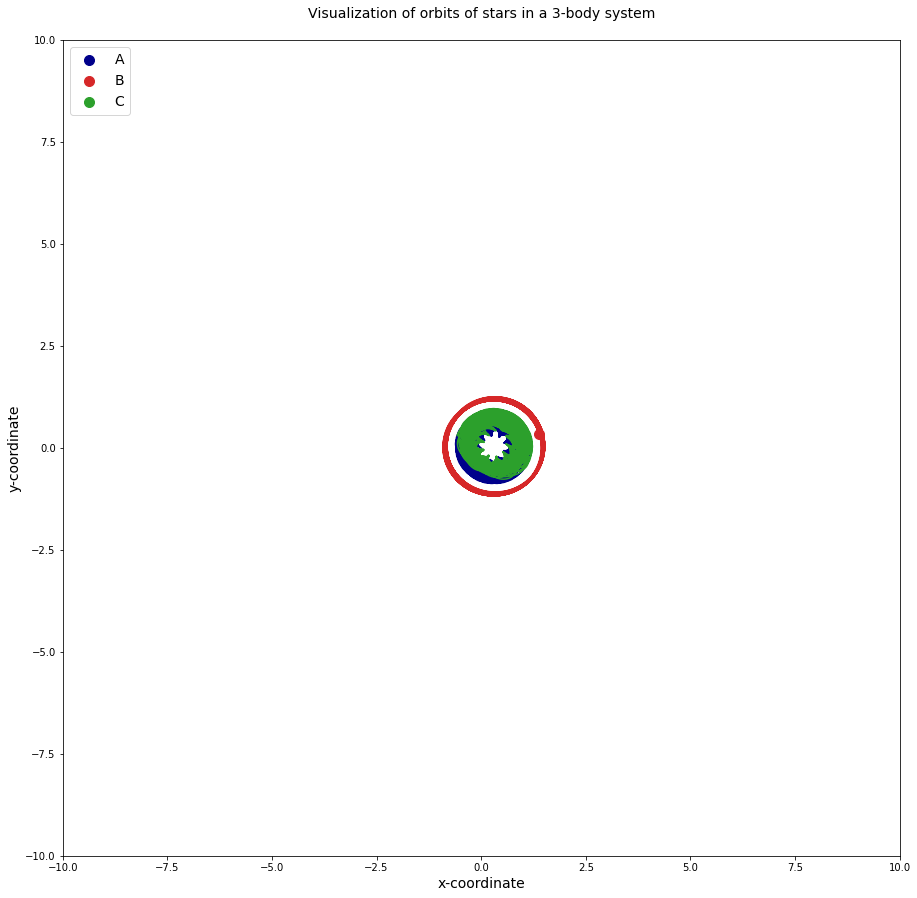

steps: 879 info -3495.19580078125 {'r2_init': [1.556338884383442, -0.1611825270019471], 'r3_init': [-0.5583821431919914, 0.2203790366183967], 'v2_init': [-0.16727548731025302, -0.8177986057661493], 'v3_init': [0.16727548731025302, 0.8177986057661493], 'period': 5007, 'period(s)': 100.14} False
[ 1.5563389  -0.16118252] [-0.55838215  0.22037904] [-0.16727548731025302, -0.8177986057661493] [0.16727548731025302, 0.8177986057661493] 100.14


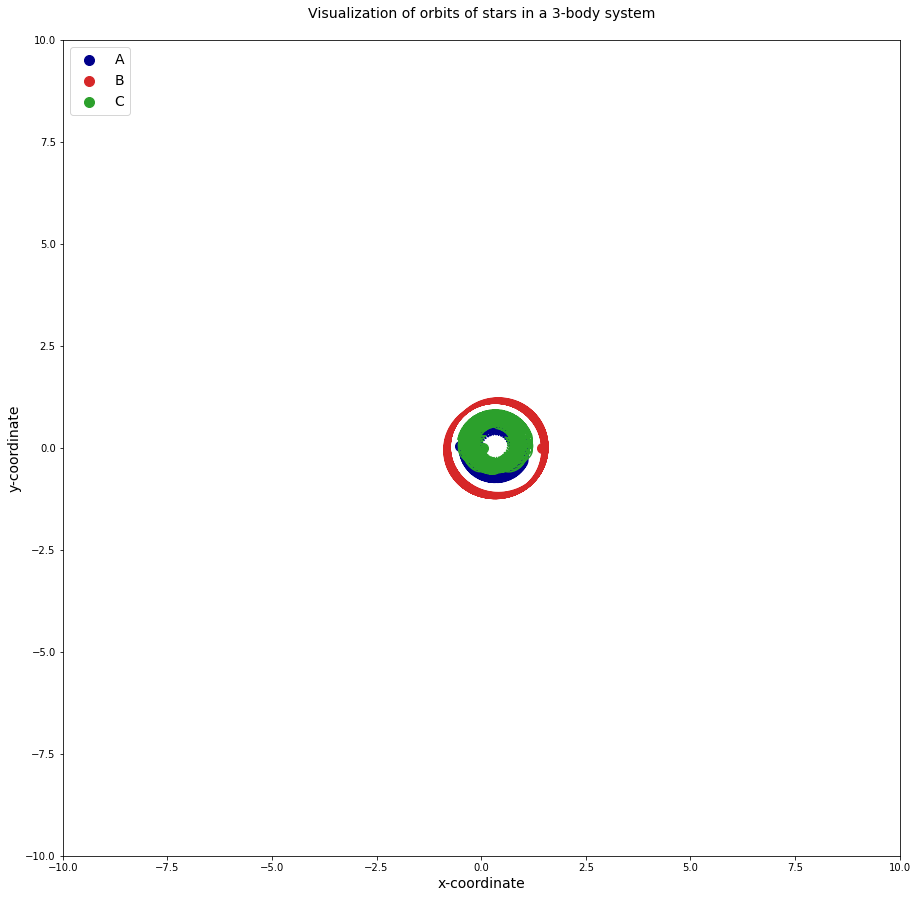

/usr/local/lib/python3.6/dist-packages/scipy/integrate/odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)


steps: 1364 info -877.9722290039062 {'r2_init': [1.8850892712920924, -0.22161337918601934], 'r3_init': [-0.1819494972750514, 0.10283616735134263], 'v2_init': [0.2673984112543986, -0.8559771704766912], 'v3_init': [-0.2673984112543986, 0.8559771704766912], 'period': 4999, 'period(s)': 99.98} False
[ 1.8850893  -0.22161338] [-0.1819495   0.10283617] [0.2673984112543986, -0.8559771704766912] [-0.2673984112543986, 0.8559771704766912] 99.98


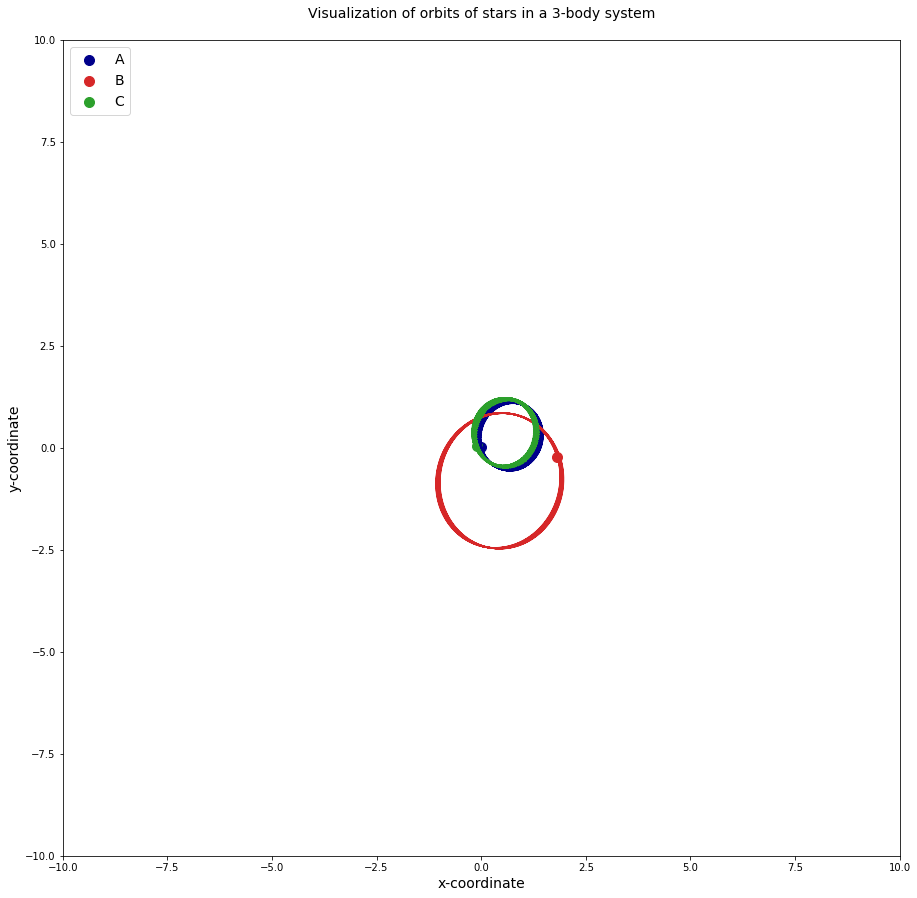

/usr/local/lib/python3.6/dist-packages/scipy/integrate/odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)


In [ ]:
#[A2C, SAC, PPO, TD3]
#take num
path = "/content/drive/My Drive/Termpaper/model/2D_T_VPPO_30000_201128"
model = model_load(2, path)
%xmode Verbose

env = CustomEnv2DT_V()
obs = env.reset()
best_reward = None
for _ in range(10000):
    action, _states = model.predict(obs)
    obs, rewards, dones, info = env.step(action)
    # print("steps", _ , "info", info)
    if dones == False:
      if best_reward is not None:
        if rewards > best_reward:
          print("steps:",_+1, "info", rewards, info, dones)
          env.render()

          best_reward = rewards
        else:
          pass
      else:
        if rewards is not None:
          best_reward = rewards
    


Exception reporting mode: Verbose
steps: 4 info -67508.734375 {'r2_init': [1.0156360897421837, -0.028559748381376267], 'r3_init': [-0.9666862407326698, 0.011417795978486538], 'v2_init': [-0.014630086421966552, -1.0055801555514334], 'v3_init': [0.014630086421966552, 1.0055801555514334], 'period': 2500, 'period(s)': 50.0} False
[ 1.0156361  -0.02855975] [-0.96668625  0.0114178 ] [-0.014630086421966552, -1.0055801555514334] [0.014630086421966552, 1.0055801555514334] 50.0


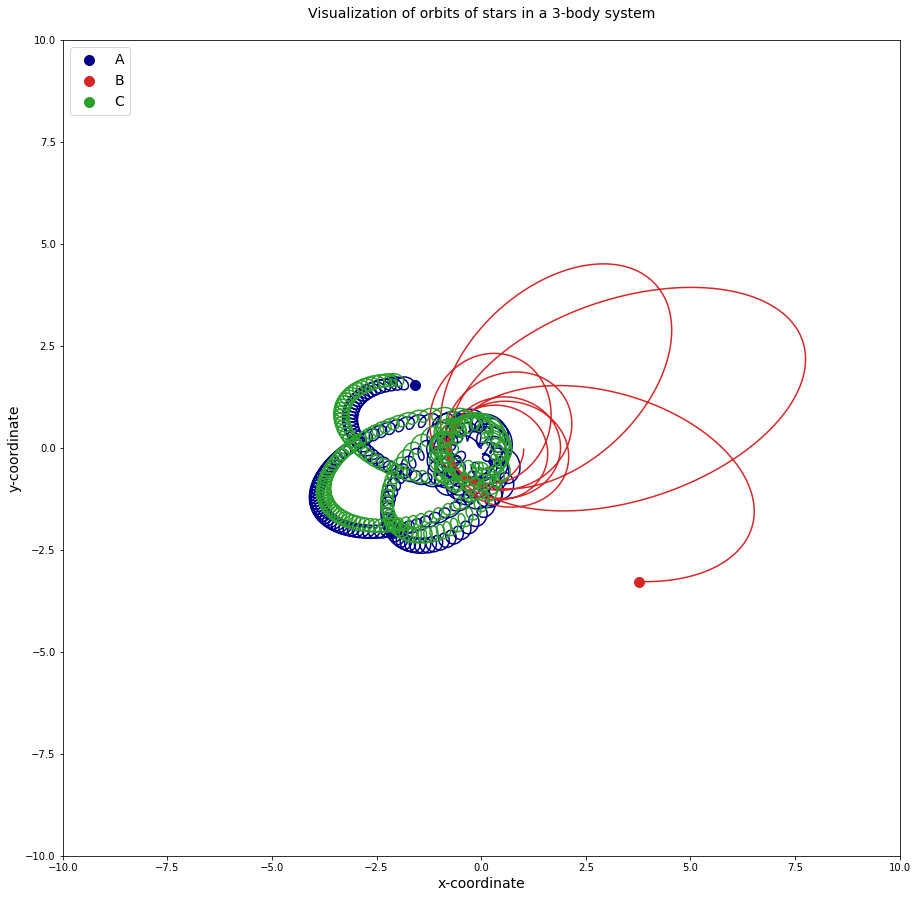

steps: 5 info -54911.21875 {'r2_init': [1.0056360897421837, -0.022844043225049973], 'r3_init': [-0.9766862407326699, 0.0014177959784865378], 'v2_init': [-0.008559621572494507, -1.0155801555514334], 'v3_init': [0.008559621572494507, 1.0155801555514334], 'period': 2501, 'period(s)': 50.02} False
[ 1.0056361  -0.02284404] [-0.97668624  0.0014178 ] [-0.008559621572494507, -1.0155801555514334] [0.008559621572494507, 1.0155801555514334] 50.02


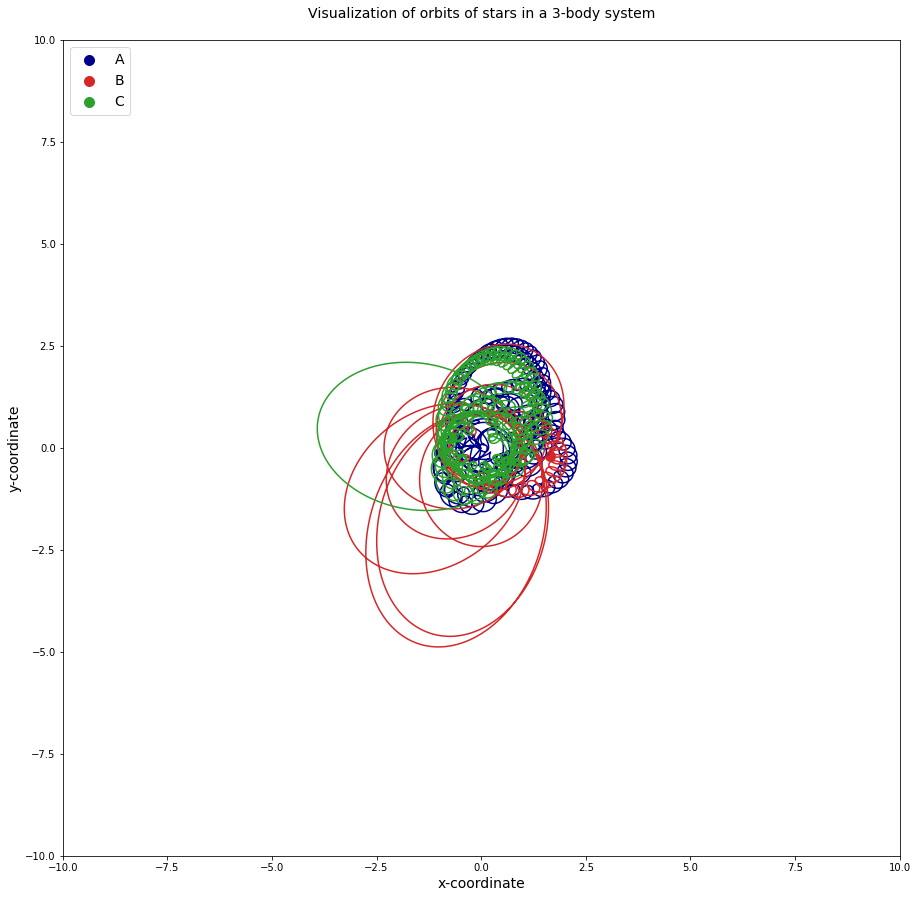

steps: 6 info -48725.1953125 {'r2_init': [1.0086877286434173, -0.012844043225049973], 'r3_init': [-0.9666862407326698, 0.00419632788747549], 'v2_init': [-0.008255824632942676, -1.0255801555514334], 'v3_init': [0.008255824632942676, 1.0255801555514334], 'period': 2500, 'period(s)': 50.0} False
[ 1.0086877  -0.01284404] [-0.96668625  0.00419633] [-0.008255824632942676, -1.0255801555514334] [0.008255824632942676, 1.0255801555514334] 50.0


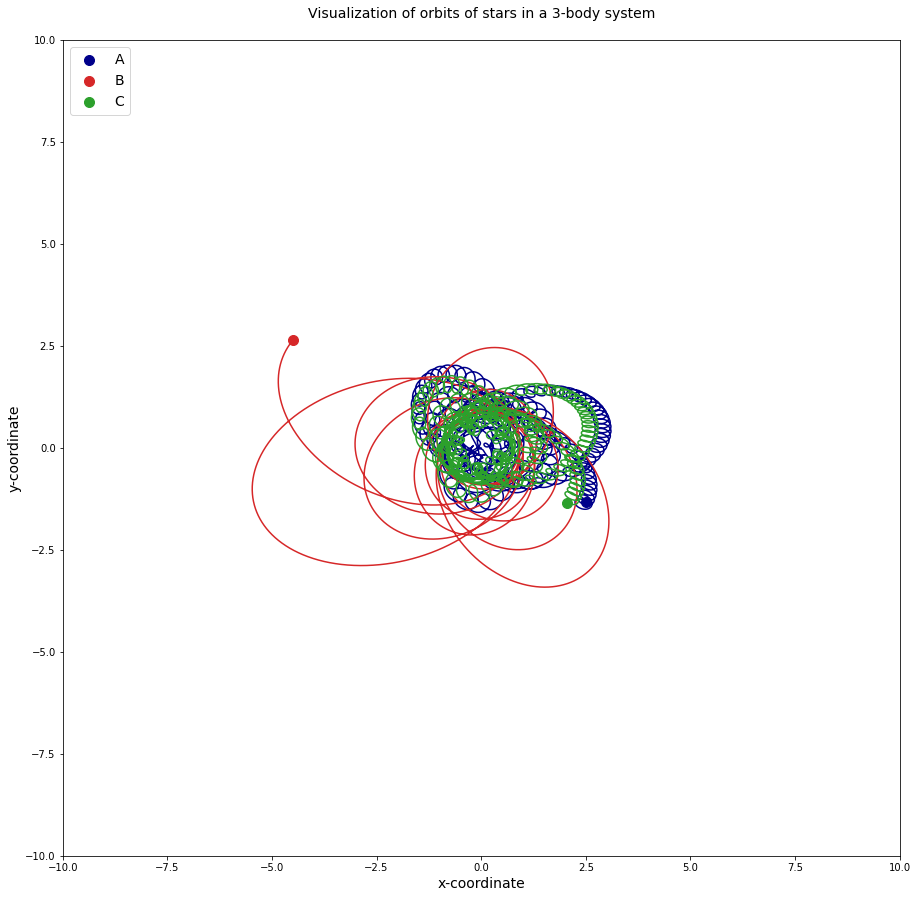

steps: 7 info -38969.171875 {'r2_init': [0.9986877286434173, -0.017864475101232527], 'r3_init': [-0.9725995686650276, 0.01419632788747549], 'v2_init': [-0.018255824632942674, -1.0355801555514335], 'v3_init': [0.018255824632942674, 1.0355801555514335], 'period': 2499, 'period(s)': 49.980000000000004} False
[ 0.99868774 -0.01786448] [-0.97259957  0.01419633] [-0.018255824632942674, -1.0355801555514335] [0.018255824632942674, 1.0355801555514335] 49.980000000000004


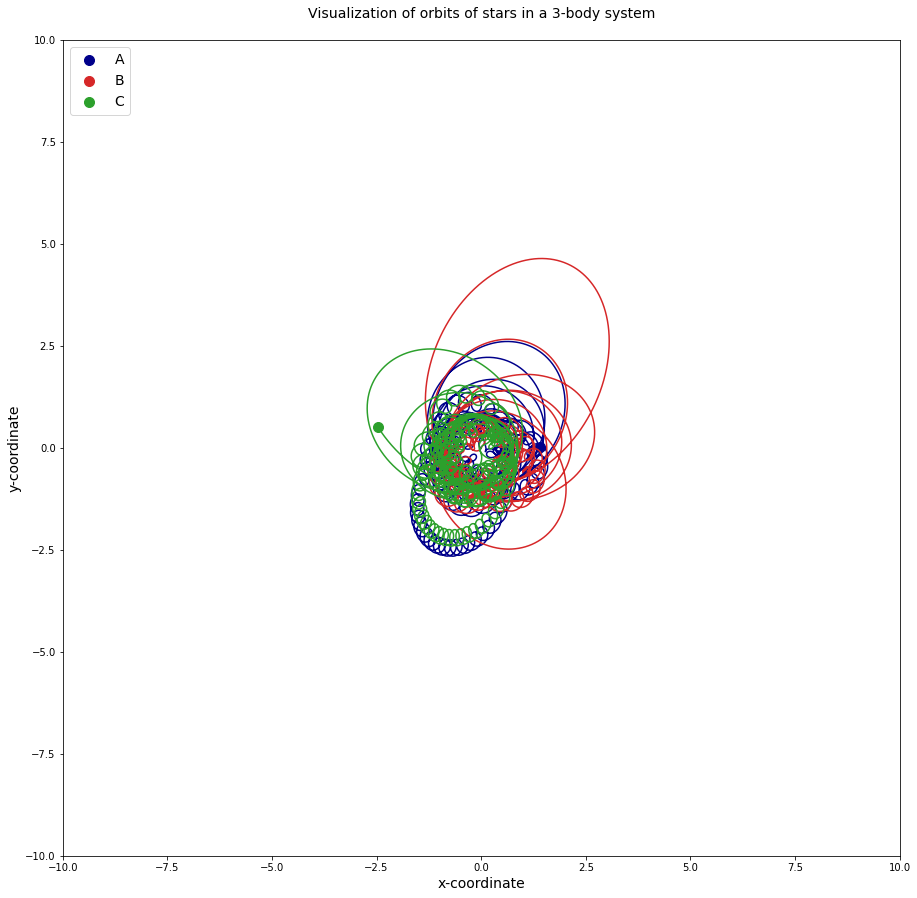

steps: 13 info -38353.0 {'r2_init': [1.0215912877023219, -0.010810824781656262], 'r3_init': [-0.9541236051917076, 0.02629967642948031], 'v2_init': [-0.010509900040924546, -1.0846693044528364], 'v3_init': [0.010509900040924546, 1.0846693044528364], 'period': 2501, 'period(s)': 50.02} False
[ 1.0215913  -0.01081083] [-0.9541236   0.02629968] [-0.010509900040924546, -1.0846693044528364] [0.010509900040924546, 1.0846693044528364] 50.02


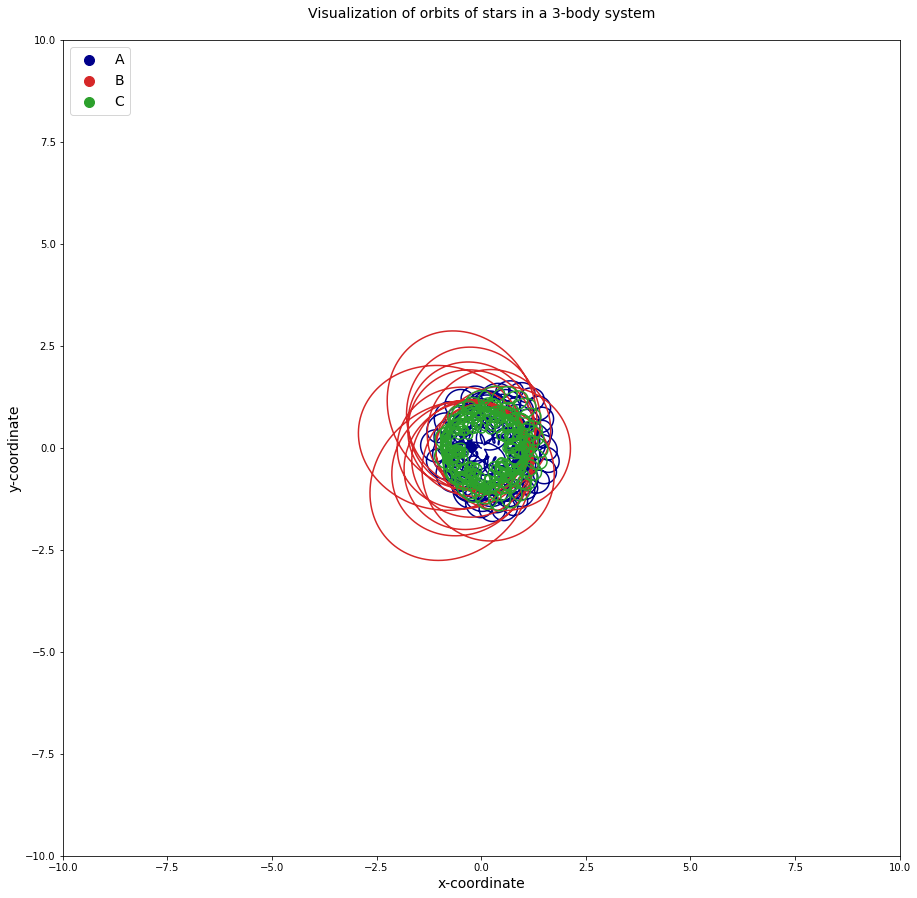

steps: 14 info -36276.6875 {'r2_init': [1.031591287702322, -0.0008108247816562622], 'r3_init': [-0.9591738161444664, 0.0287494078092277], 'v2_init': [-0.011820191778242586, -1.0938207757100462], 'v3_init': [0.011820191778242586, 1.0938207757100462], 'period': 2502, 'period(s)': 50.04} False
[ 1.0315913e+00 -8.1082480e-04] [-0.9591738   0.02874941] [-0.011820191778242586, -1.0938207757100462] [0.011820191778242586, 1.0938207757100462] 50.04


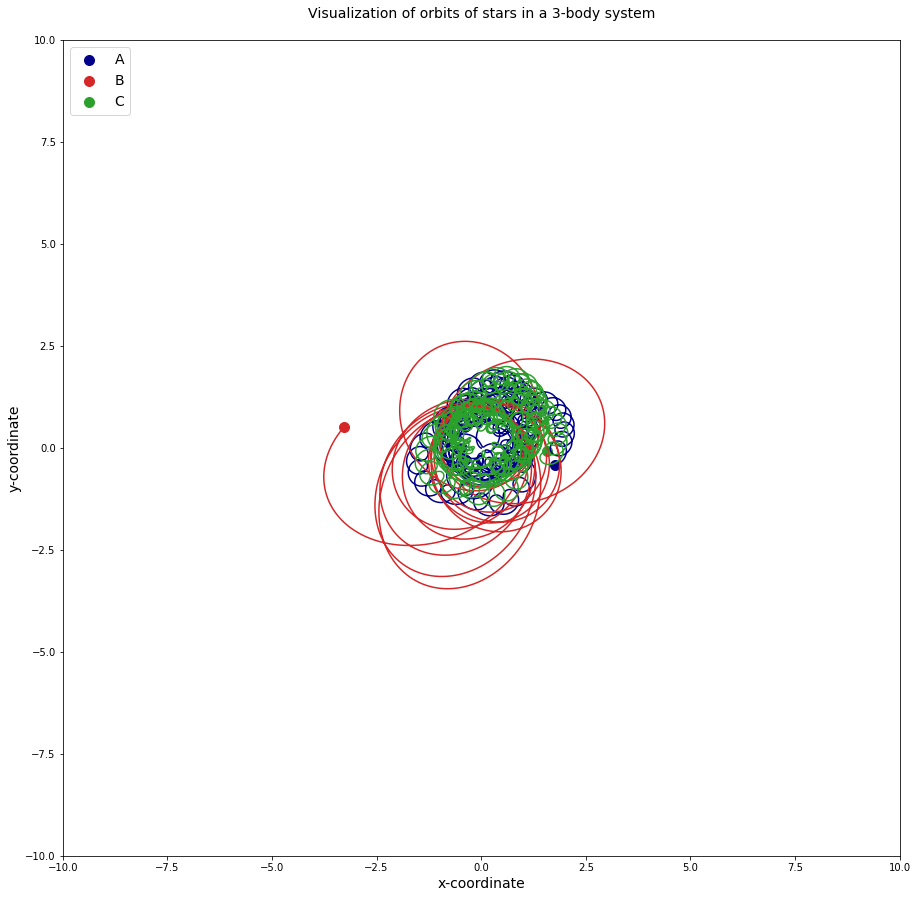

steps: 16 info -30828.505859375 {'r2_init': [1.0288793049752711, 0.006110128909349445], 'r3_init': [-0.9623098942637444, 0.022695659380406137], 'v2_init': [-0.017849760092794896, -1.1010508432611823], 'v3_init': [0.017849760092794896, 1.1010508432611823], 'period': 2502, 'period(s)': 50.04} False
[1.0288793  0.00611013] [-0.9623099   0.02269566] [-0.017849760092794896, -1.1010508432611823] [0.017849760092794896, 1.1010508432611823] 50.04


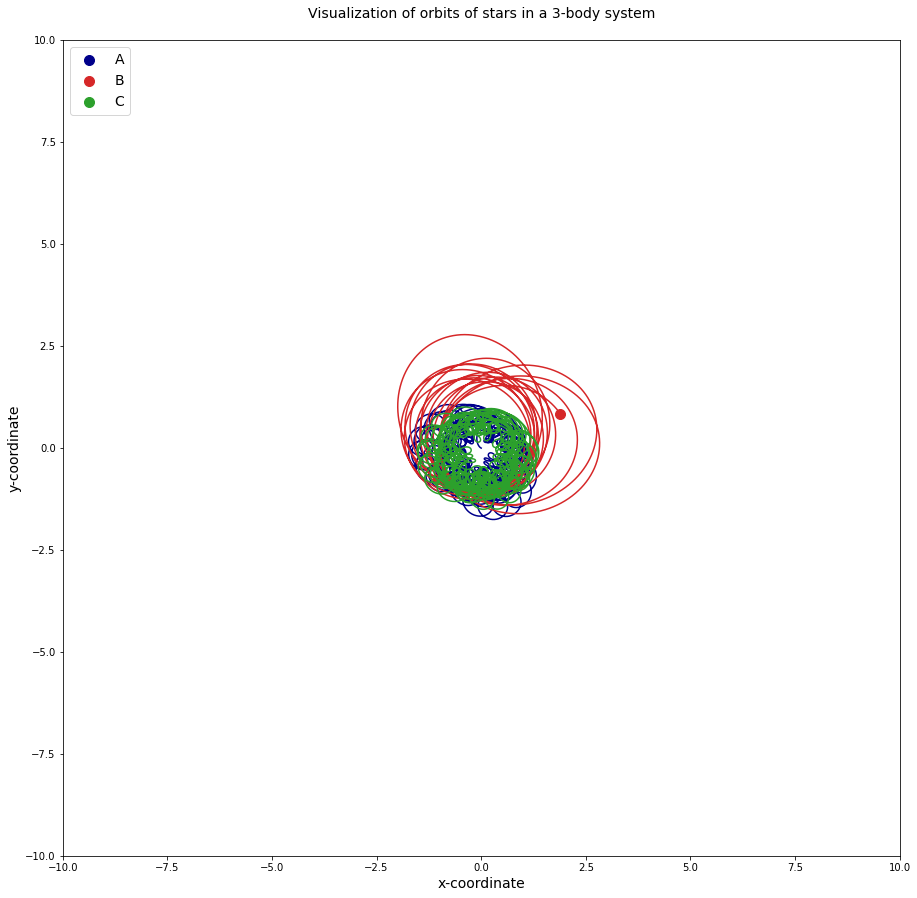

steps: 29 info -25834.34375 {'r2_init': [1.0763939586281774, 0.02603708788752556], 'r3_init': [-1.0043696252256633, 0.009914073776453721], 'v2_init': [0.007831922986079003, -1.0963096112757922], 'v3_init': [-0.007831922986079003, 1.0963096112757922], 'period': 2501, 'period(s)': 50.02} False
[1.076394   0.02603709] [-1.0043696   0.00991407] [0.007831922986079003, -1.0963096112757922] [-0.007831922986079003, 1.0963096112757922] 50.02


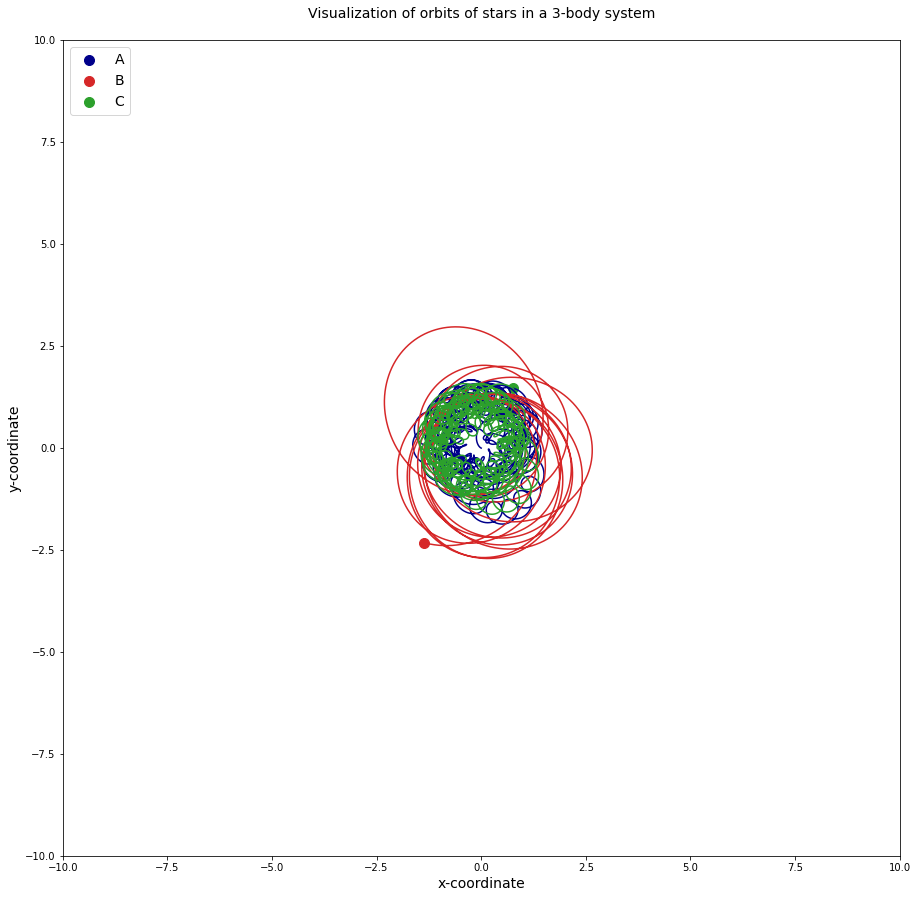

steps: 61 info -25143.693359375 {'r2_init': [1.0932105850428337, 0.04904265228658916], 'r3_init': [-1.0218516311049461, 0.020656376127153618], 'v2_init': [0.11384331202367319, -1.0582422331720591], 'v3_init': [-0.11384331202367319, 1.0582422331720591], 'period': 2507, 'period(s)': 50.14} False
[1.0932106  0.04904265] [-1.0218517   0.02065638] [0.11384331202367319, -1.0582422331720591] [-0.11384331202367319, 1.0582422331720591] 50.14


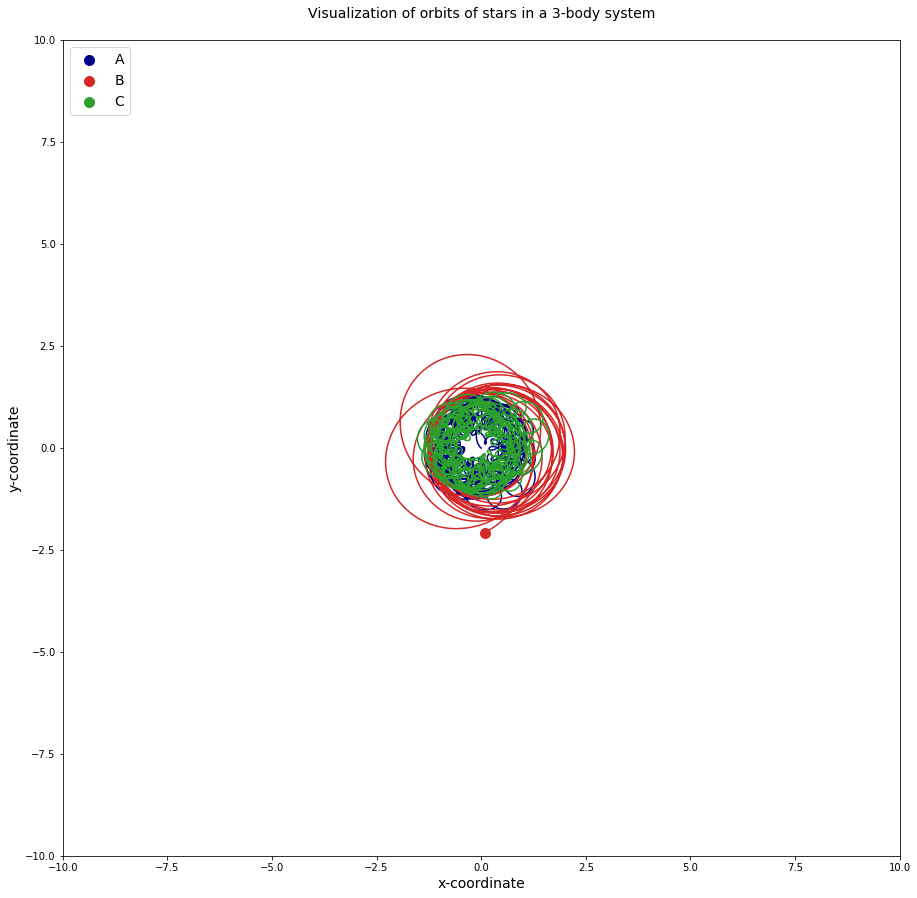

steps: 186 info -20777.0390625 {'r2_init': [1.082698265947402, 0.11040367269888524], 'r3_init': [-0.9189733675122259, 0.0415163215668872], 'v2_init': [0.11795157535234475, -1.0626591239124532], 'v3_init': [-0.11795157535234475, 1.0626591239124532], 'period': 2514, 'period(s)': 50.28} False
[1.0826982  0.11040367] [-0.9189734   0.04151632] [0.11795157535234475, -1.0626591239124532] [-0.11795157535234475, 1.0626591239124532] 50.28


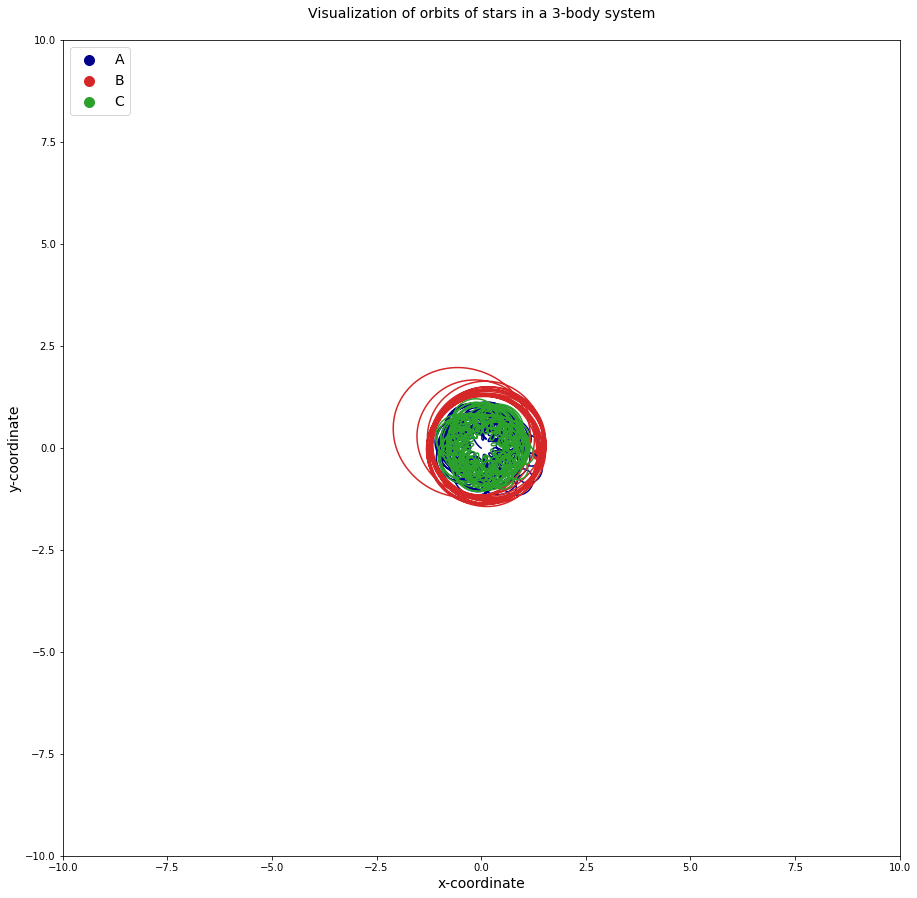

steps: 889 info -8673.876953125 {'r2_init': [1.5361715745925906, 0.03575002986006436], 'r3_init': [-0.6647946097701792, -0.22220638007856894], 'v2_init': [-0.07348044202546564, -1.091095682466402], 'v3_init': [0.07348044202546564, 1.091095682466402], 'period': 2515, 'period(s)': 50.300000000000004} False
[1.5361716  0.03575003] [-0.6647946  -0.22220638] [-0.07348044202546564, -1.091095682466402] [0.07348044202546564, 1.091095682466402] 50.300000000000004


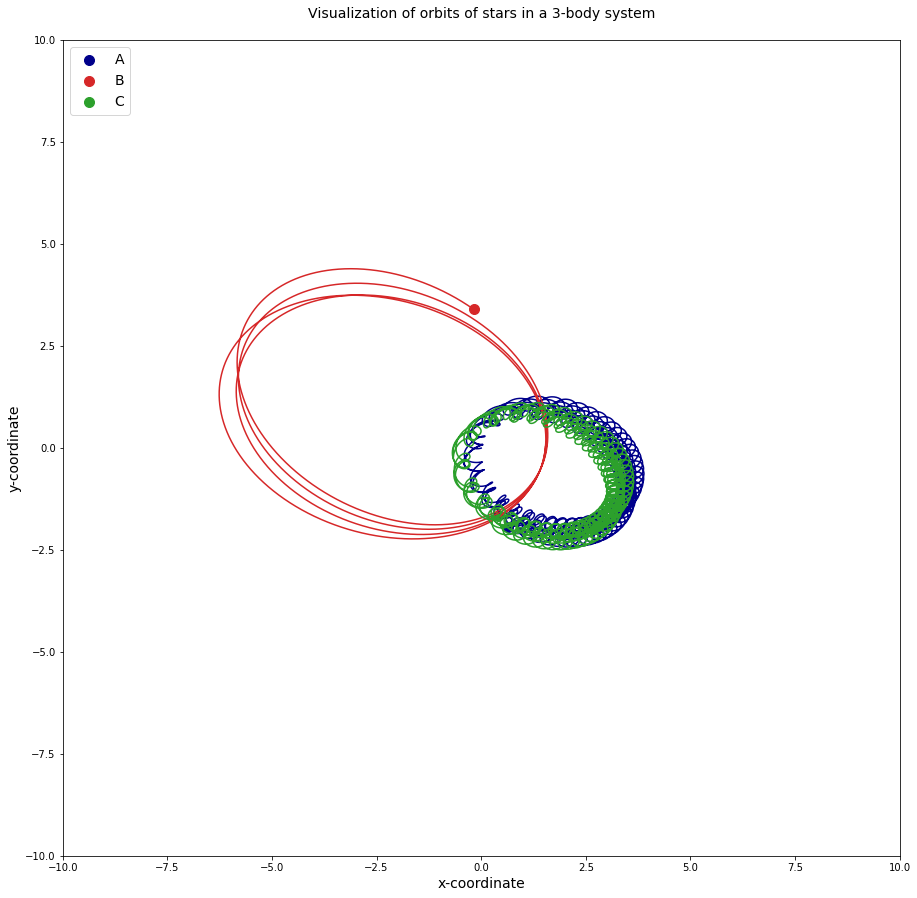

steps: 928 info -6397.98828125 {'r2_init': [1.504033928513527, 0.005678847385570387], 'r3_init': [-0.6526438424736265, -0.1657641807291656], 'v2_init': [-0.05134230032446769, -1.0443288117740293], 'v3_init': [0.05134230032446769, 1.0443288117740293], 'period': 2506, 'period(s)': 50.120000000000005} False
[1.5040339  0.00567885] [-0.65264386 -0.16576418] [-0.05134230032446769, -1.0443288117740293] [0.05134230032446769, 1.0443288117740293] 50.120000000000005


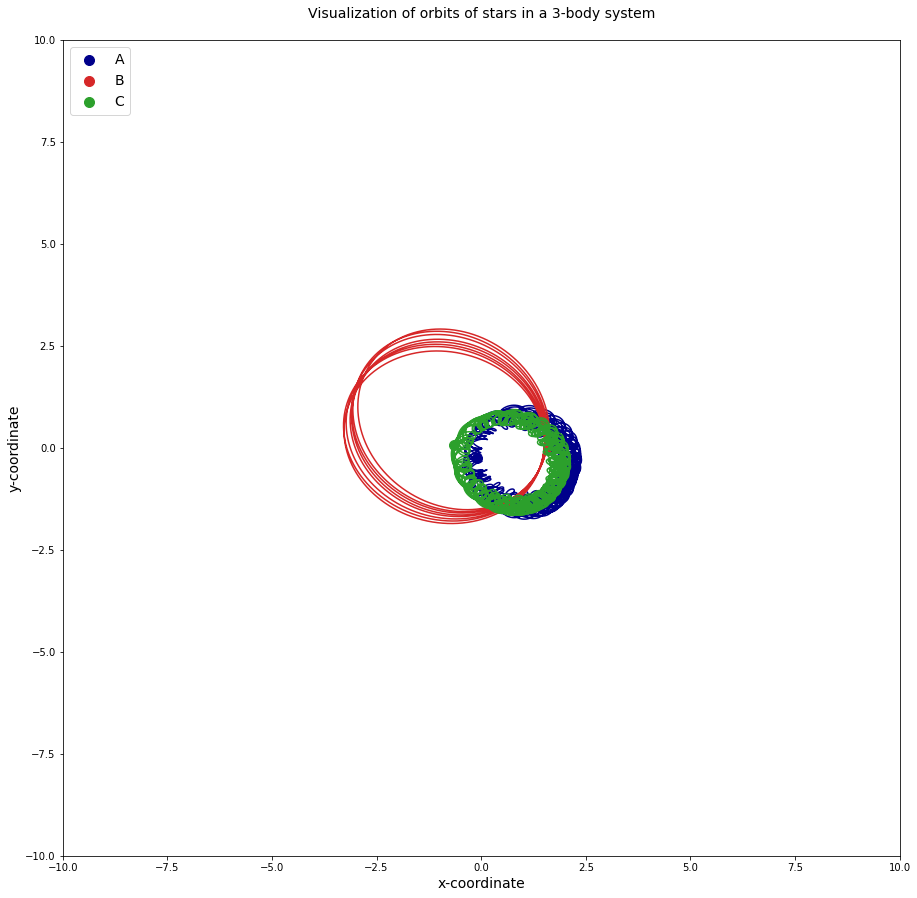

steps: 949 info -3057.15087890625 {'r2_init': [1.4826957896351811, 0.004957122458145001], 'r3_init': [-0.58945080190897, -0.17391623348928983], 'v2_init': [-0.009249201117781653, -1.0681424258369943], 'v3_init': [0.009249201117781653, 1.0681424258369943], 'period': 2510, 'period(s)': 50.2} False
[1.4826958  0.00495712] [-0.5894508  -0.17391624] [-0.009249201117781653, -1.0681424258369943] [0.009249201117781653, 1.0681424258369943] 50.2


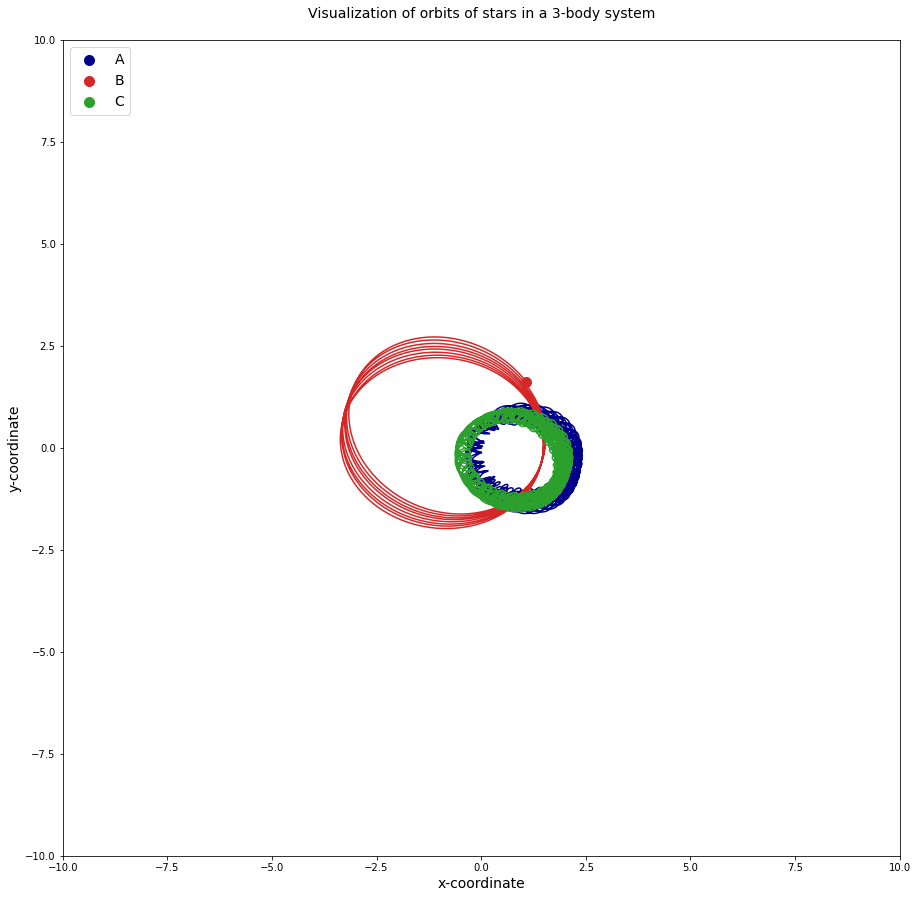

steps: 1329 info -2584.24658203125 {'r2_init': [1.7065671401470905, -0.15976136515382683], 'r3_init': [-0.5362884766608472, -0.19199918090365825], 'v2_init': [0.022245926958276256, -1.0609008298255493], 'v3_init': [-0.022245926958276256, 1.0609008298255493], 'period': 2520, 'period(s)': 50.4} False
[ 1.7065672  -0.15976137] [-0.5362885  -0.19199918] [0.022245926958276256, -1.0609008298255493] [-0.022245926958276256, 1.0609008298255493] 50.4


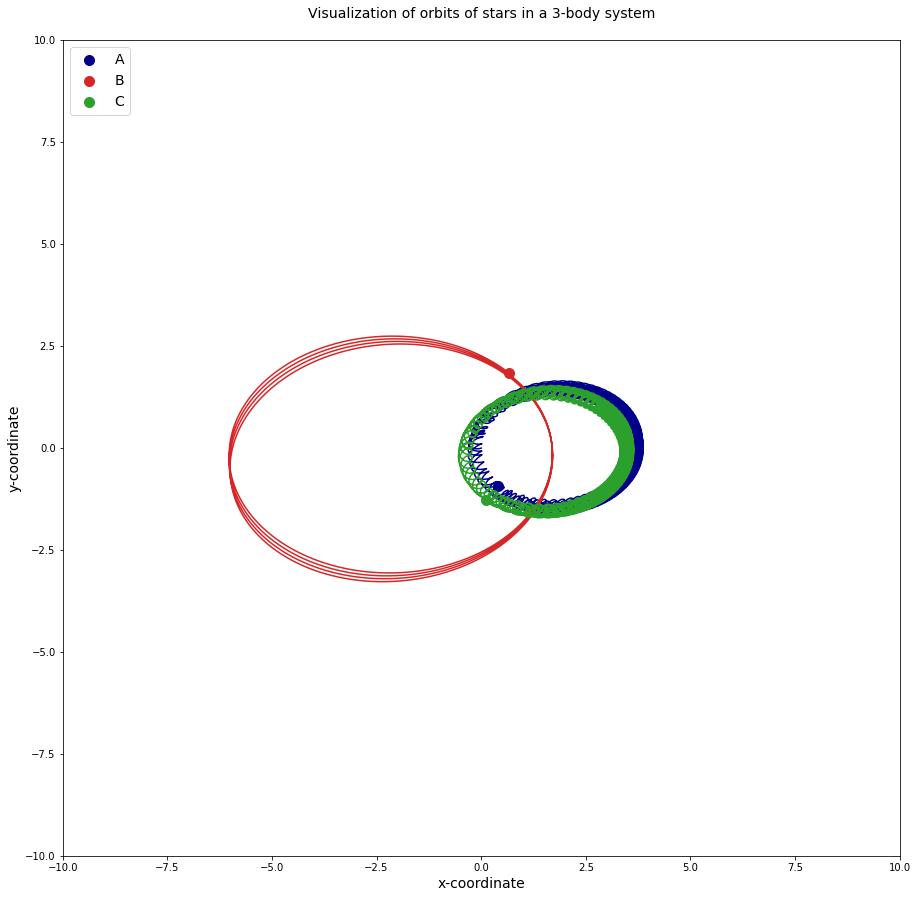

In [ ]:
#[A2C, SAC, PPO, TD3]
#take num
path = "/content/drive/My Drive/Termpaper/model/2D_T_VPPO_30000_201128"
model = model_load(2, path)
%xmode Verbose

env = CustomEnv2DT_V()
obs = env.reset()
best_reward = None
for _ in range(1500):
    action, _states = model.predict(obs)
    obs, rewards, dones, info = env.step(action)
    # print("steps", _ , "info", info)
    if dones == False:
      if best_reward is not None:
        if rewards > best_reward:
          print("steps:",_+1, "info", rewards, info, dones)
          env.render()

          best_reward = rewards
        else:
          pass
      else:
        if rewards is not None:
          best_reward = rewards
    


Exception reporting mode: Verbose
steps: 3 info -40919.9140625 {'r2_init': [1.0066824842616917, 0.012125423401594162], 'r3_init': [-0.9748085635900497, 0.00974477708339691], 'v2_init': [-0.011049216985702515, -0.992818656861782], 'v3_init': [0.011049216985702515, 0.992818656861782], 'period': 2501, 'period(s)': 50.02} False
[1.0066825  0.01212542] [-0.9748086   0.00974478] [-0.011049216985702515, -0.992818656861782] [0.011049216985702515, 0.992818656861782] 50.02


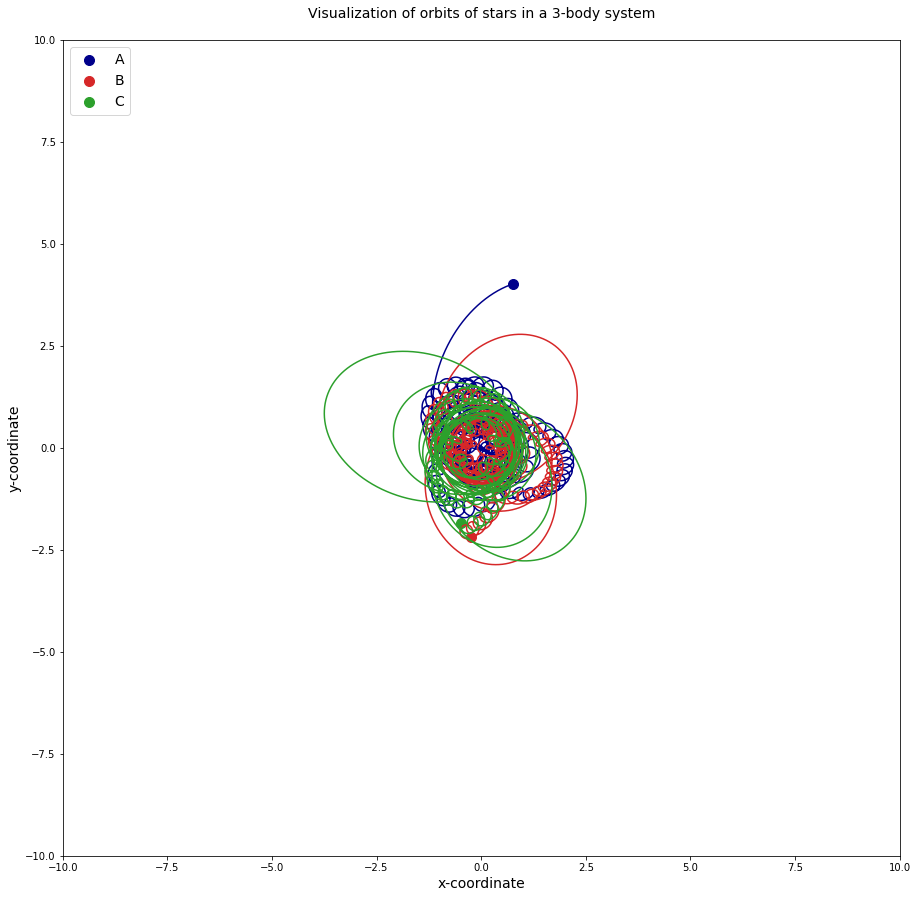

steps: 5 info -37727.2578125 {'r2_init': [0.998417986445129, 3.668606281280462e-05], 'r3_init': [-0.9559925681352616, 0.007369189858436583], 'v2_init': [-0.009753952026367186, -0.9801707085967063], 'v3_init': [0.009753952026367186, 0.9801707085967063], 'period': 2501, 'period(s)': 50.02} False
[9.9841797e-01 3.6686062e-05] [-0.9559926   0.00736919] [-0.009753952026367186, -0.9801707085967063] [0.009753952026367186, 0.9801707085967063] 50.02


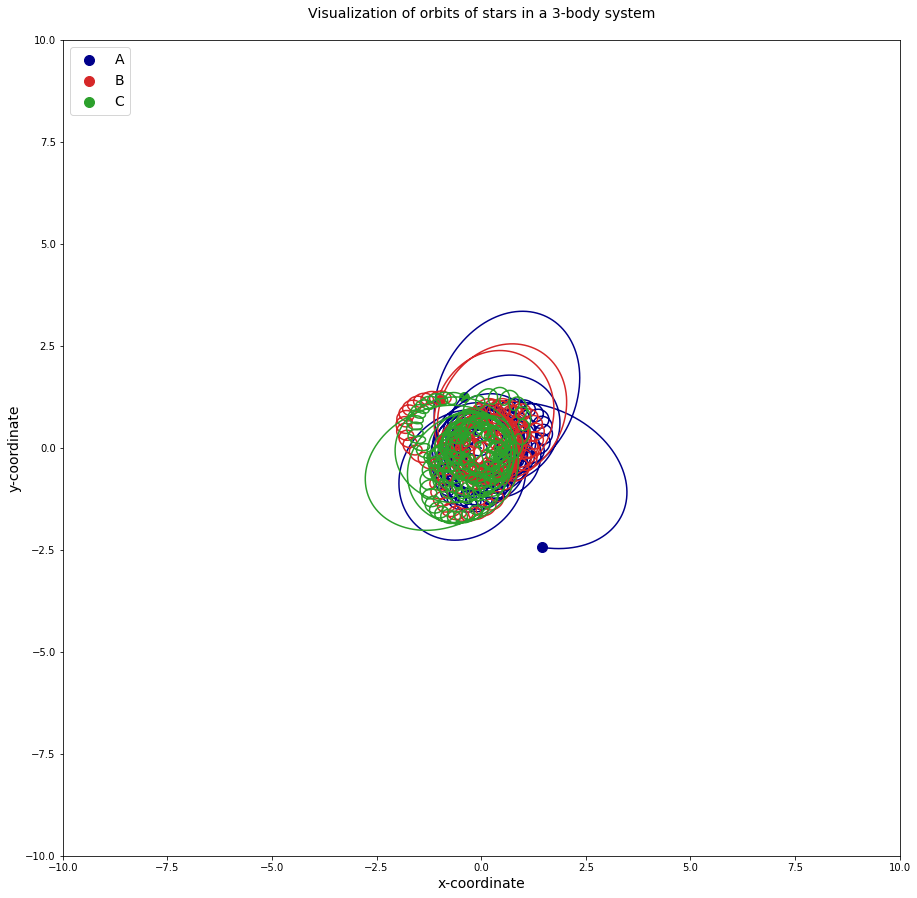

steps: 20 info -33567.03125 {'r2_init': [1.0007529852911832, -0.015320774600841108], 'r3_init': [-0.9348642233014107, 0.02210306313820183], 'v2_init': [-0.03610444635152817, -0.996836622580886], 'v3_init': [0.03610444635152817, 0.996836622580886], 'period': 2504, 'period(s)': 50.08} False
[ 1.0007529  -0.01532077] [-0.9348642   0.02210306] [-0.03610444635152817, -0.996836622580886] [0.03610444635152817, 0.996836622580886] 50.08


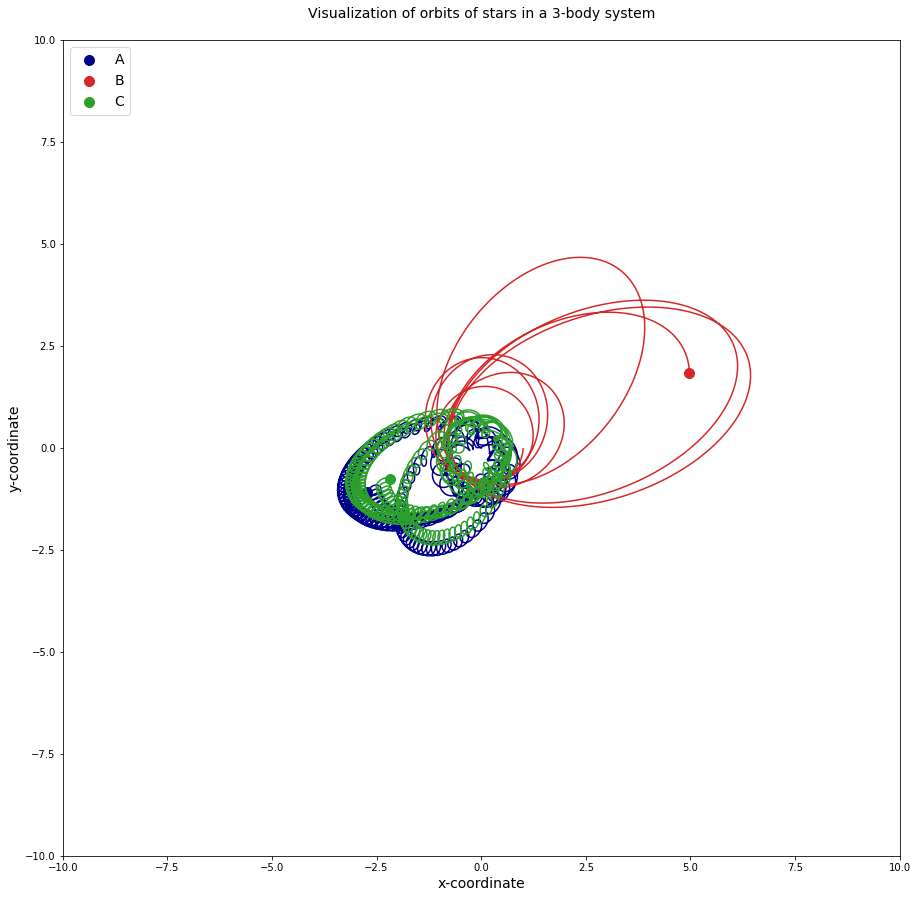

steps: 63 info -25608.955078125 {'r2_init': [1.06125184122473, -0.013248576135374618], 'r3_init': [-0.8207135082036258, 0.06154836227186024], 'v2_init': [-0.11735301711130884, -1.0094134491682056], 'v3_init': [0.11735301711130884, 1.0094134491682056], 'period': 2511, 'period(s)': 50.22} False
[ 1.0612519  -0.01324858] [-0.8207135   0.06154836] [-0.11735301711130884, -1.0094134491682056] [0.11735301711130884, 1.0094134491682056] 50.22


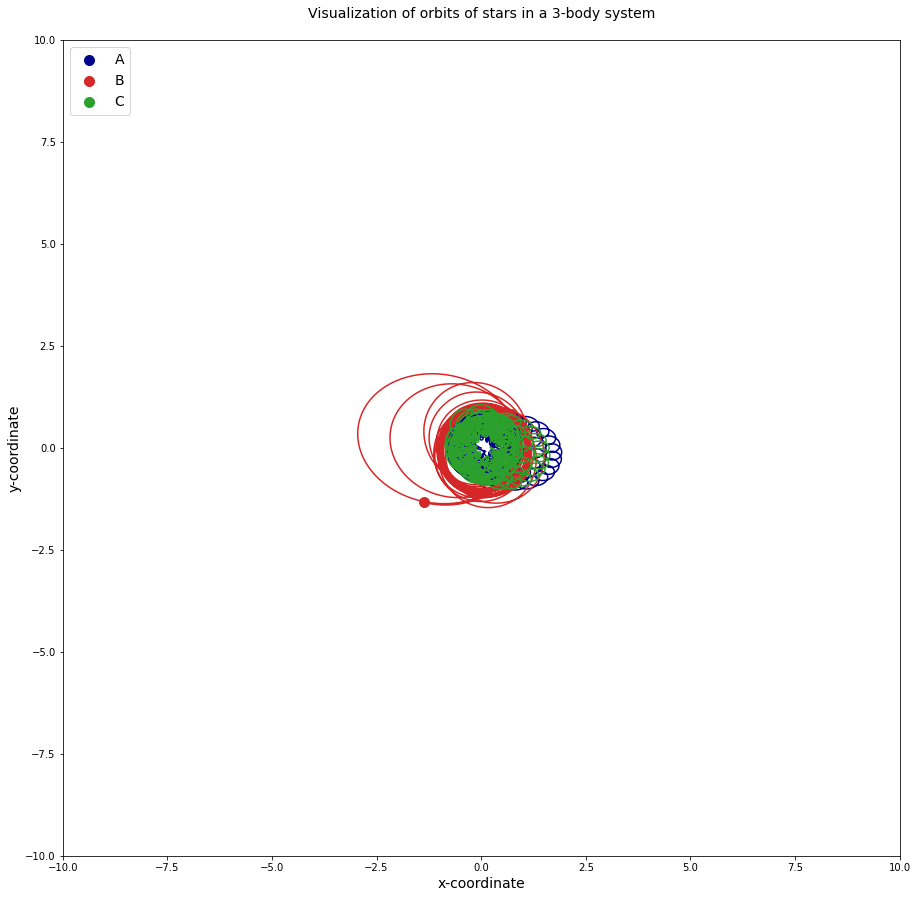

steps: 156 info -25270.25390625 {'r2_init': [1.0061195739731195, 0.020199604532681395], 'r3_init': [-0.7479447022452947, 0.1656767262890934], 'v2_init': [-0.21671755278017368, -1.0739287931006405], 'v3_init': [0.21671755278017368, 1.0739287931006405], 'period': 2509, 'period(s)': 50.18} False
[1.0061196 0.0201996] [-0.7479447   0.16567673] [-0.21671755278017368, -1.0739287931006405] [0.21671755278017368, 1.0739287931006405] 50.18


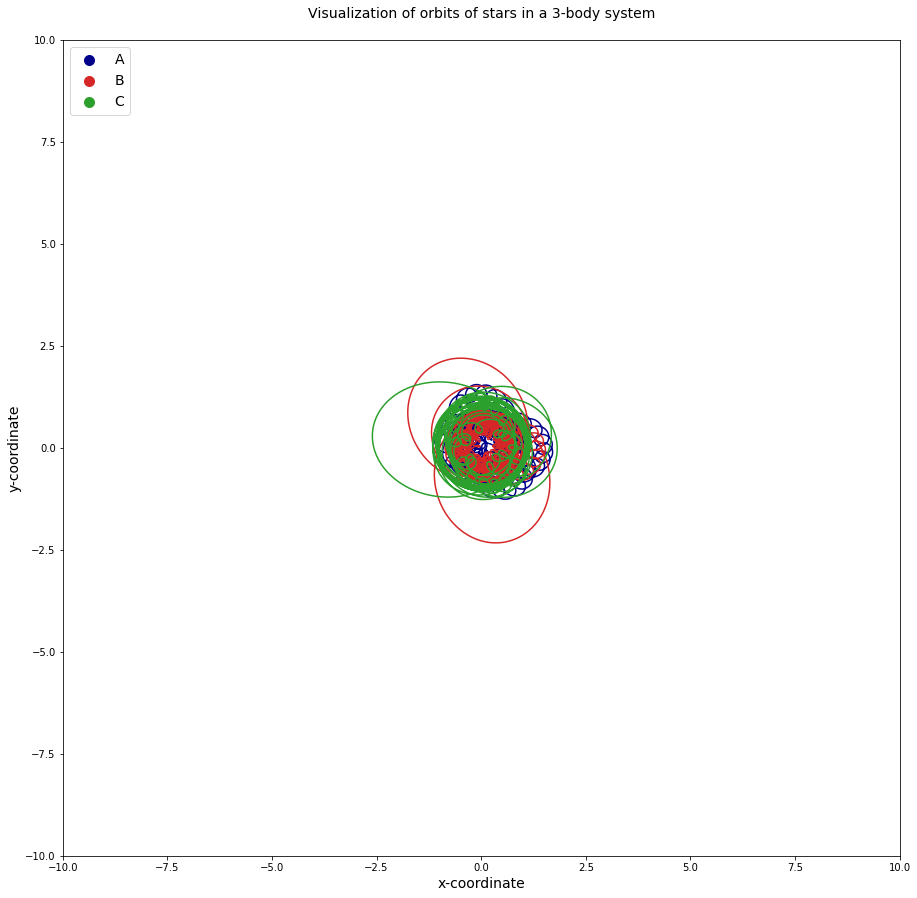

steps: 193 info -23635.259765625 {'r2_init': [1.0438658288493756, -0.015752428048290332], 'r3_init': [-0.7460739619657395, 0.1163960385648533], 'v2_init': [-0.18890439541544757, -1.1363551816623656], 'v3_init': [0.18890439541544757, 1.1363551816623656], 'period': 2502, 'period(s)': 50.04} False
[ 1.0438658  -0.01575243] [-0.74607396  0.11639604] [-0.18890439541544757, -1.1363551816623656] [0.18890439541544757, 1.1363551816623656] 50.04


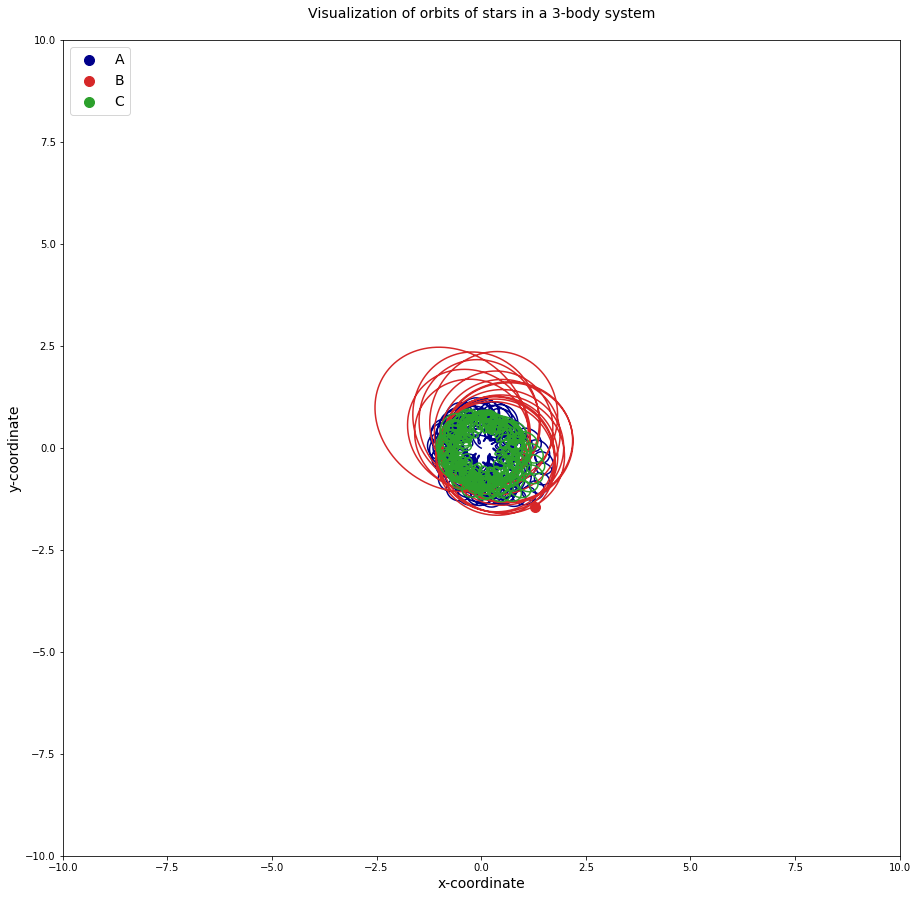

steps: 277 info -17148.068359375 {'r2_init': [1.026079001165927, 0.04333703233394774], 'r3_init': [-0.5960643250495192, 0.08839172444771969], 'v2_init': [-0.23070807686541225, -1.2015670248586678], 'v3_init': [0.23070807686541225, 1.2015670248586678], 'period': 2491, 'period(s)': 49.82} False
[1.026079   0.04333703] [-0.5960643   0.08839172] [-0.23070807686541225, -1.2015670248586678] [0.23070807686541225, 1.2015670248586678] 49.82


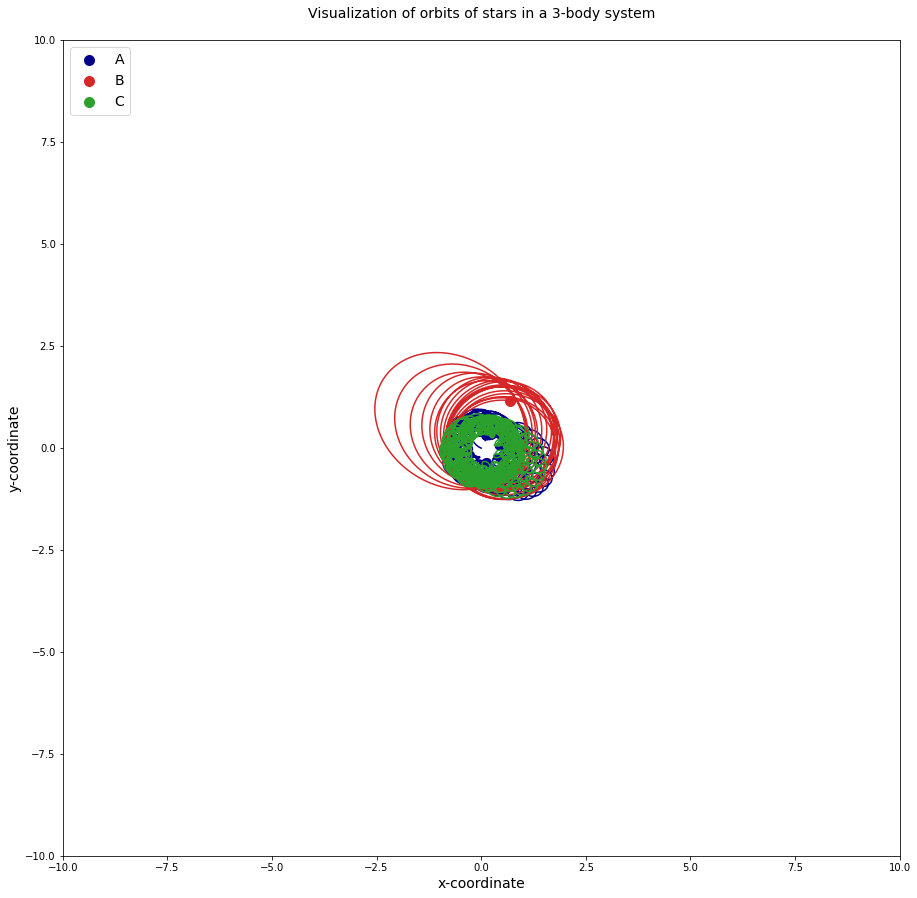

steps: 334 info -16212.5703125 {'r2_init': [1.0595805842056878, -0.008571869018487607], 'r3_init': [-0.6051519242674108, 0.1496188694192096], 'v2_init': [-0.1391161282593384, -1.1736284636333574], 'v3_init': [0.1391161282593384, 1.1736284636333574], 'period': 2495, 'period(s)': 49.9} False
[ 1.0595806  -0.00857187] [-0.60515195  0.14961886] [-0.1391161282593384, -1.1736284636333574] [0.1391161282593384, 1.1736284636333574] 49.9


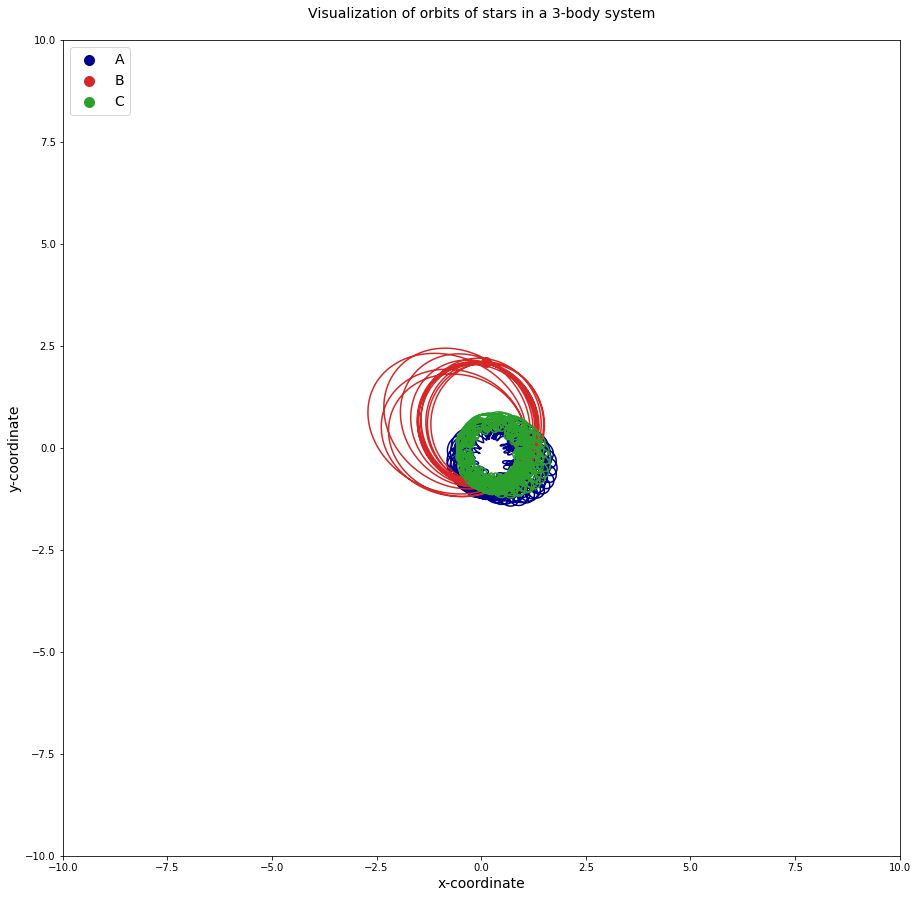

/usr/local/lib/python3.6/dist-packages/scipy/integrate/odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)


steps: 1040 info -10562.9296875 {'r2_init': [1.670287499651314, 0.03566180605906999], 'r3_init': [-0.12698434904217676, 0.33322549870703383], 'v2_init': [0.0884783330699431, -1.139868835173545], 'v3_init': [-0.0884783330699431, 1.139868835173545], 'period': 2566, 'period(s)': 51.32} False
[1.6702875  0.03566181] [-0.12698434  0.3332255 ] [0.0884783330699431, -1.139868835173545] [-0.0884783330699431, 1.139868835173545] 51.32


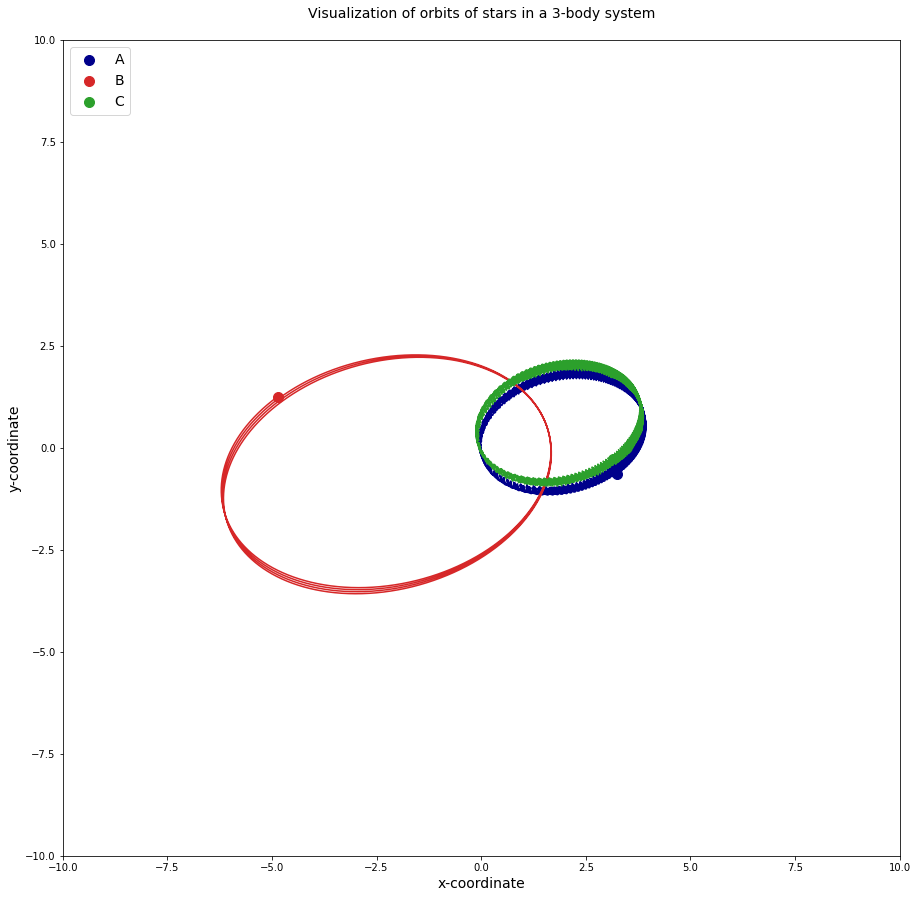

steps: 1048 info -3566.400390625 {'r2_init': [1.6889573516696703, 0.03817018766421831], 'r3_init': [-0.12018448032438712, 0.33567525917664187], 'v2_init': [0.0898801756044852, -1.1308162579312897], 'v3_init': [-0.0898801756044852, 1.1308162579312897], 'period': 2565, 'period(s)': 51.300000000000004} False
[1.6889573  0.03817019] [-0.12018448  0.33567527] [0.0898801756044852, -1.1308162579312897] [-0.0898801756044852, 1.1308162579312897] 51.300000000000004


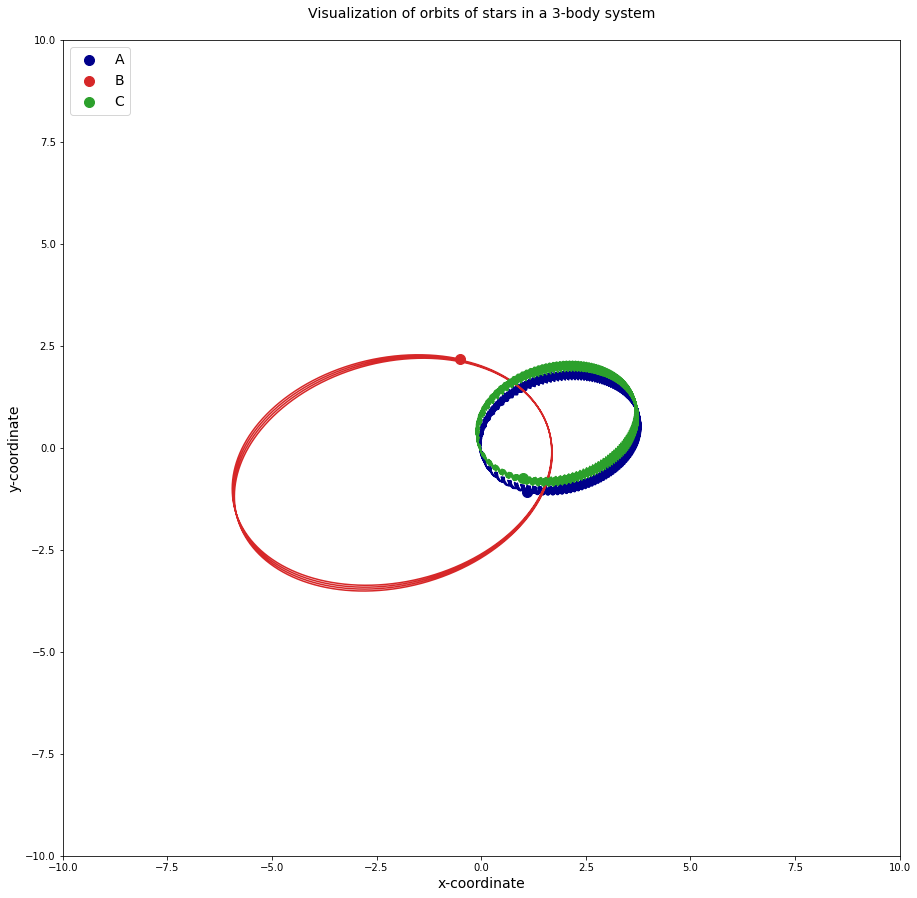

/usr/local/lib/python3.6/dist-packages/scipy/integrate/odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)


In [ ]:
#[A2C, SAC, PPO, TD3]
#take num
path = "/content/drive/My Drive/Termpaper/model/2D_T_VPPO_30000_201128"
model = model_load(2, path)
%xmode Verbose

env = CustomEnv2DT_V()
obs = env.reset()
best_reward = None
for _ in range(1500):
    action, _states = model.predict(obs)
    obs, rewards, dones, info = env.step(action)
    # print("steps", _ , "info", info)
    if dones == False:
      if best_reward is not None:
        if rewards > best_reward:
          print("steps:",_+1, "info", rewards, info, dones)
          env.render()

          best_reward = rewards
        else:
          pass
      else:
        if rewards is not None:
          best_reward = rewards
    


Exception reporting mode: Verbose
steps: 4 info -37767.39453125 {'r2_init': [1.0162978042662143, 0.015009816884994507], 'r3_init': [-0.9909432139992714, 0.01047736406326294], 'v2_init': [-0.019864360094070437, -0.9891394526511431], 'v3_init': [0.019864360094070437, 0.9891394526511431], 'period': 2501, 'period(s)': 50.02} False
[1.0162978  0.01500982] [-0.9909432   0.01047736] [-0.019864360094070437, -0.9891394526511431] [0.019864360094070437, 0.9891394526511431] 50.02


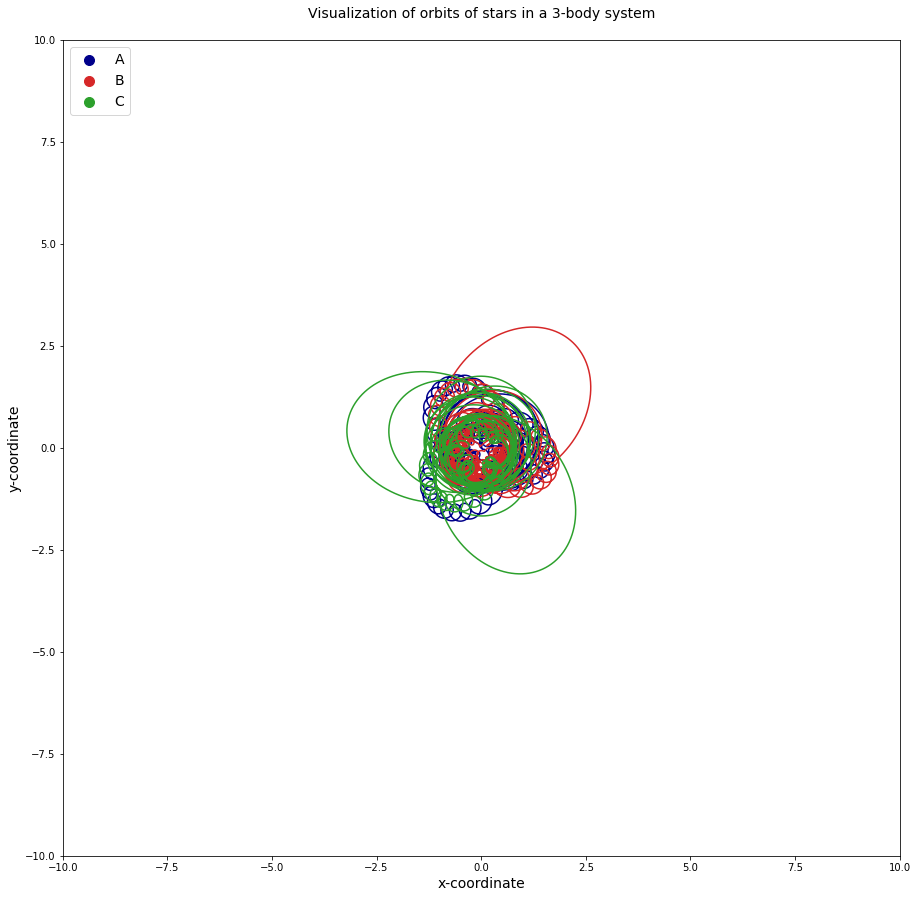

steps: 19 info -37582.296875 {'r2_init': [1.0568132387846707, 0.06004555955529213], 'r3_init': [-0.9395864138007163, 0.03409663058817387], 'v2_init': [-0.018909258730709554, -0.9804424152057619], 'v3_init': [0.018909258730709554, 0.9804424152057619], 'period': 2504, 'period(s)': 50.08} False
[1.0568132  0.06004556] [-0.9395864   0.03409663] [-0.018909258730709554, -0.9804424152057619] [0.018909258730709554, 0.9804424152057619] 50.08


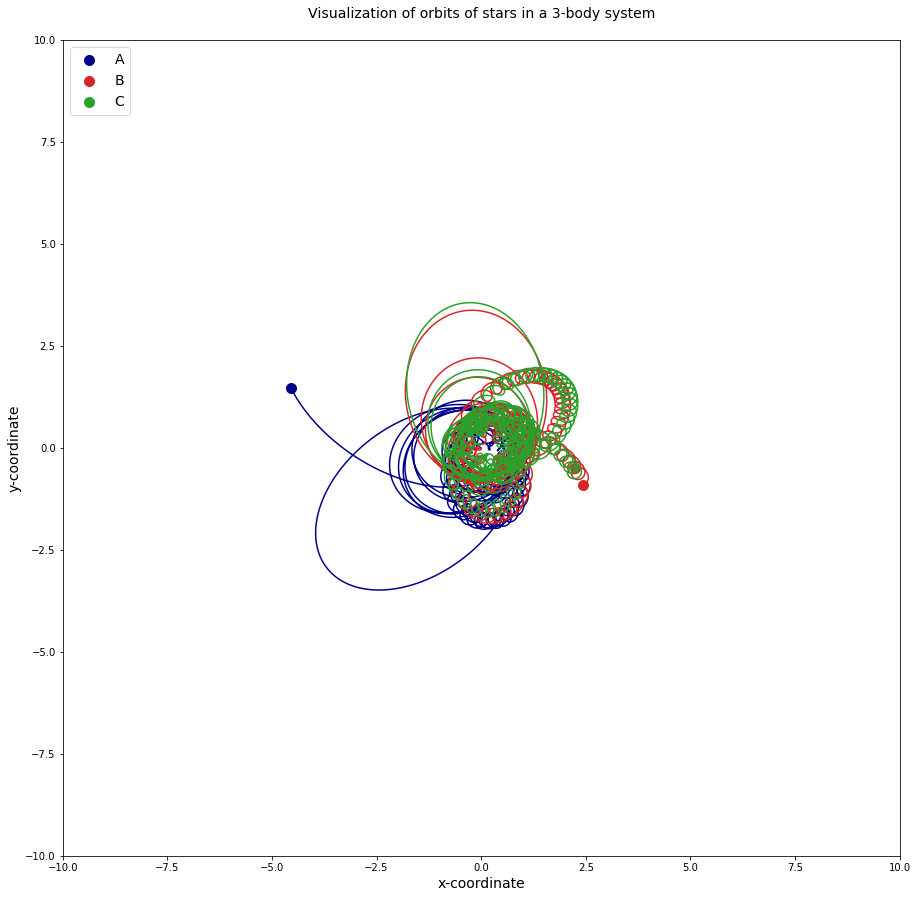

steps: 21 info -27595.6484375 {'r2_init': [1.0411302088946102, 0.06617736294865607], 'r3_init': [-0.9314123702049255, 0.034726742282509805], 'v2_init': [-0.034590455181896684, -0.9814373168628664], 'v3_init': [0.034590455181896684, 0.9814373168628664], 'period': 2504, 'period(s)': 50.08} False
[1.0411302  0.06617736] [-0.9314124   0.03472674] [-0.034590455181896684, -0.9814373168628664] [0.034590455181896684, 0.9814373168628664] 50.08


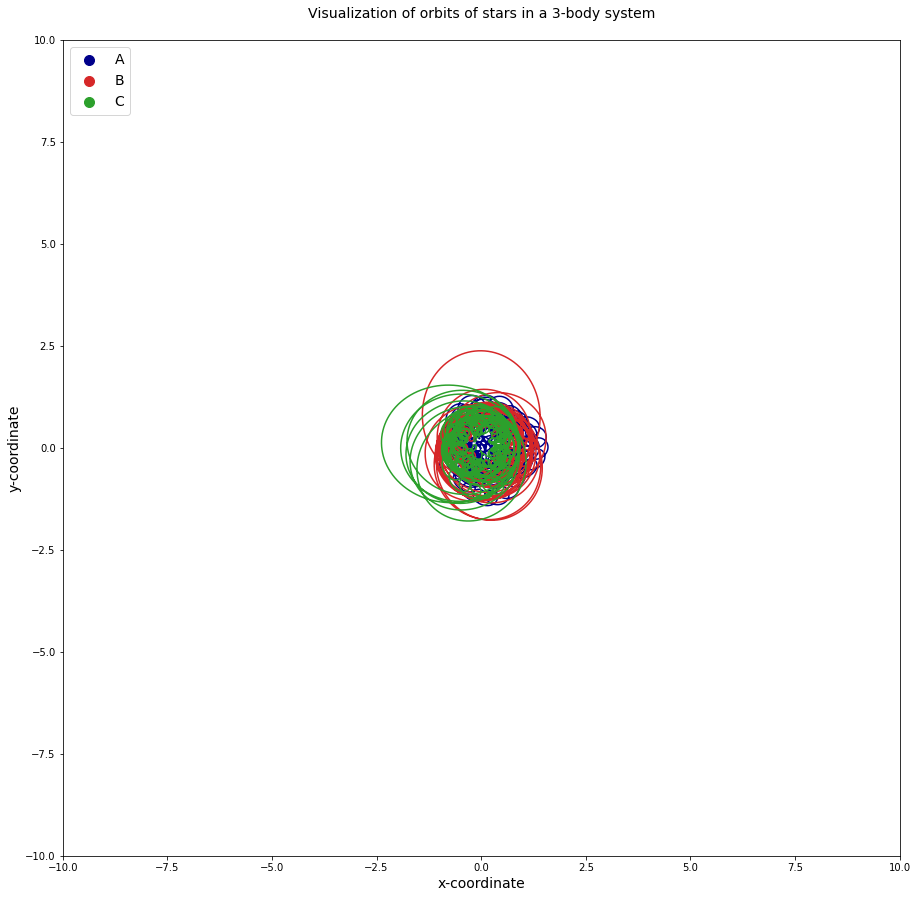

steps: 105 info -24066.095703125 {'r2_init': [1.1474114035815006, 0.02493255868554112], 'r3_init': [-0.924329006746411, -0.0016025432571768593], 'v2_init': [-0.05836972195655106, -1.018420383520424], 'v3_init': [0.05836972195655106, 1.018420383520424], 'period': 2495, 'period(s)': 49.9} False
[1.1474113  0.02493256] [-0.924329   -0.00160254] [-0.05836972195655106, -1.018420383520424] [0.05836972195655106, 1.018420383520424] 49.9


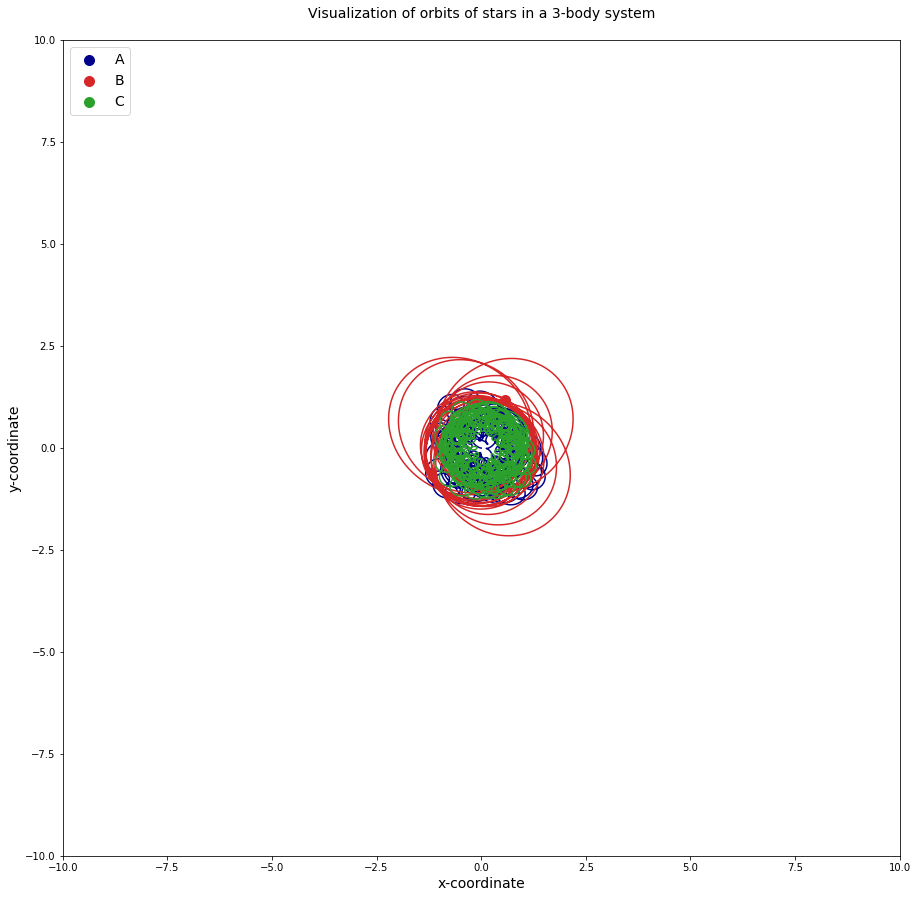

steps: 123 info -23811.65625 {'r2_init': [1.1769699413329366, 0.02816761672496792], 'r3_init': [-0.9052952884882686, 0.02068917471915485], 'v2_init': [-0.1006833132356405, -1.0186870910972354], 'v3_init': [0.1006833132356405, 1.0186870910972354], 'period': 2495, 'period(s)': 49.9} False
[1.1769699  0.02816762] [-0.9052953   0.02068917] [-0.1006833132356405, -1.0186870910972354] [0.1006833132356405, 1.0186870910972354] 49.9


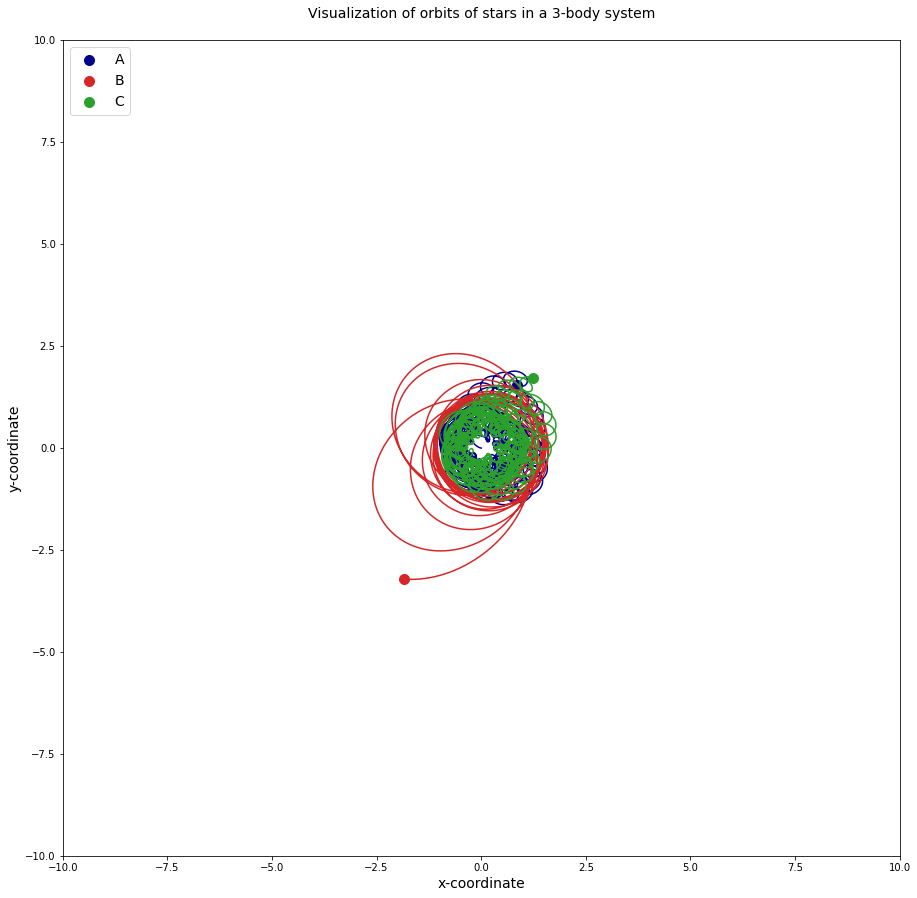

steps: 138 info -19811.11328125 {'r2_init': [1.1930737537890679, 0.03662038546055552], 'r3_init': [-0.8989859826117752, 0.026968597676604998], 'v2_init': [-0.07770204722881317, -1.0265676452219483], 'v3_init': [0.07770204722881317, 1.0265676452219483], 'period': 2496, 'period(s)': 49.92} False
[1.1930737  0.03662039] [-0.898986   0.0269686] [-0.07770204722881317, -1.0265676452219483] [0.07770204722881317, 1.0265676452219483] 49.92


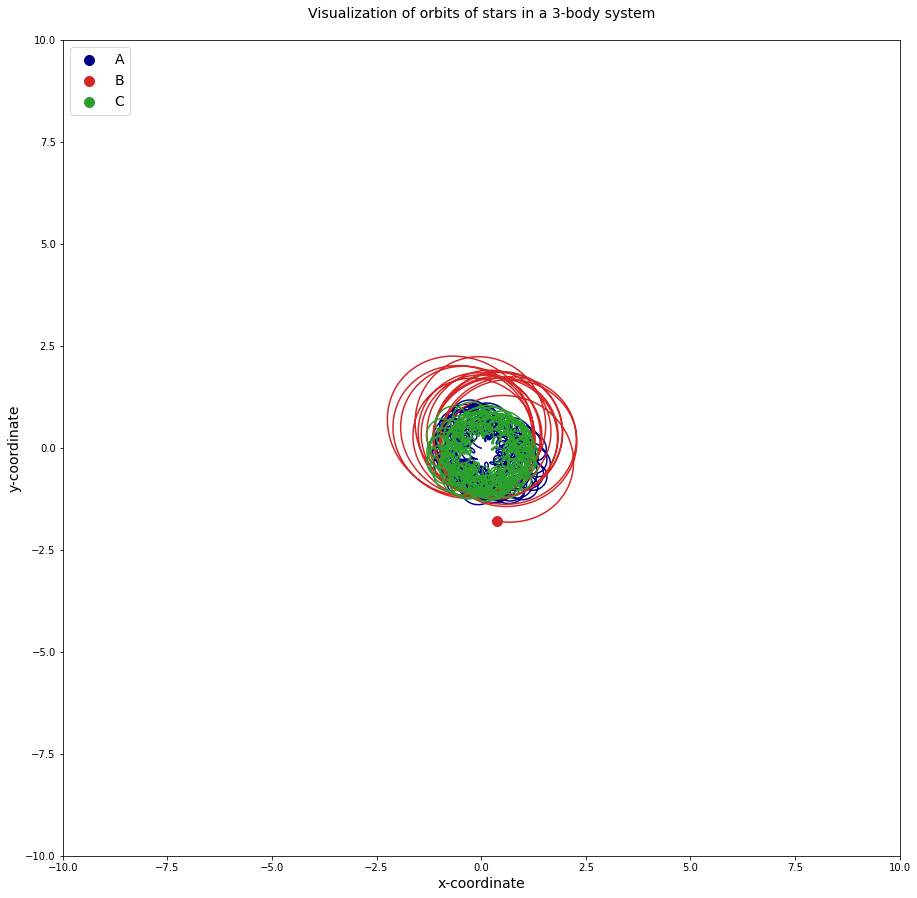

steps: 866 info -19105.005859375 {'r2_init': [1.6770049112662662, -0.06009836638346316], 'r3_init': [-0.6777930852770807, 0.22526183085516105], 'v2_init': [-0.06734461165033295, -1.0462461065594102], 'v3_init': [0.06734461165033295, 1.0462461065594102], 'period': 2481, 'period(s)': 49.620000000000005} False
[ 1.6770049  -0.06009836] [-0.6777931   0.22526184] [-0.06734461165033295, -1.0462461065594102] [0.06734461165033295, 1.0462461065594102] 49.620000000000005


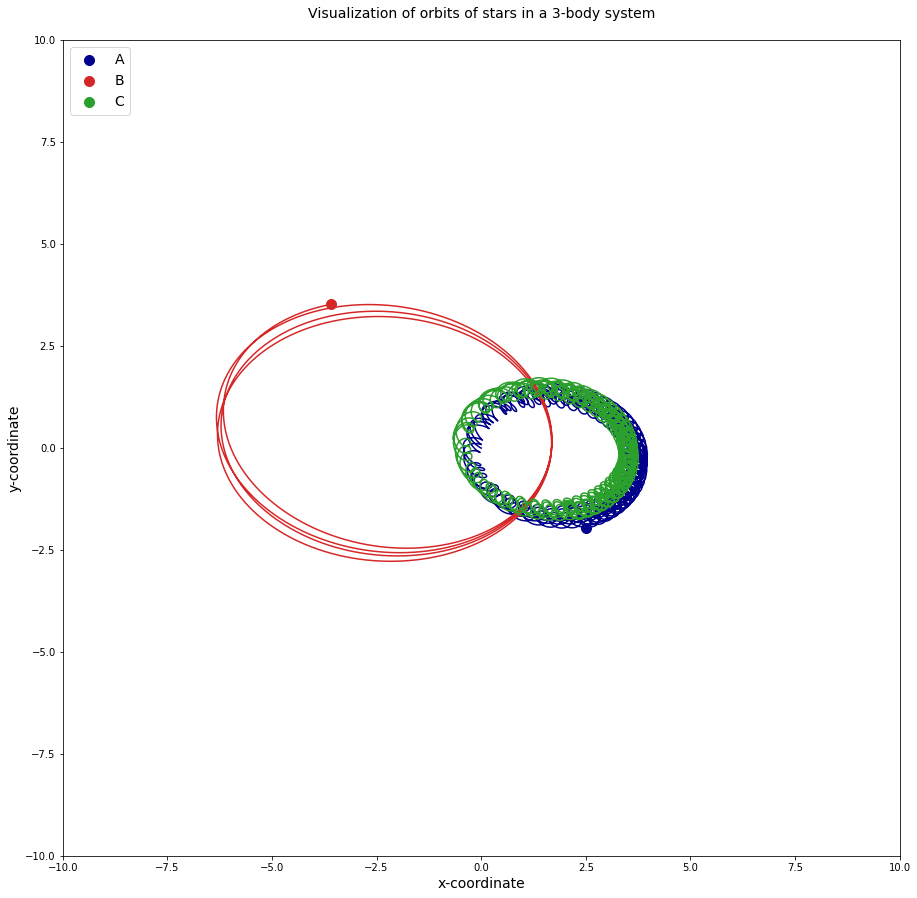

steps: 869 info -8363.89453125 {'r2_init': [1.683386619798838, -0.062327656839042914], 'r3_init': [-0.6681390219926836, 0.22121605606749664], 'v2_init': [-0.06623151219449952, -1.0398730539623642], 'v3_init': [0.06623151219449952, 1.0398730539623642], 'period': 2480, 'period(s)': 49.6} False
[ 1.6833866  -0.06232766] [-0.66813904  0.22121605] [-0.06623151219449952, -1.0398730539623642] [0.06623151219449952, 1.0398730539623642] 49.6


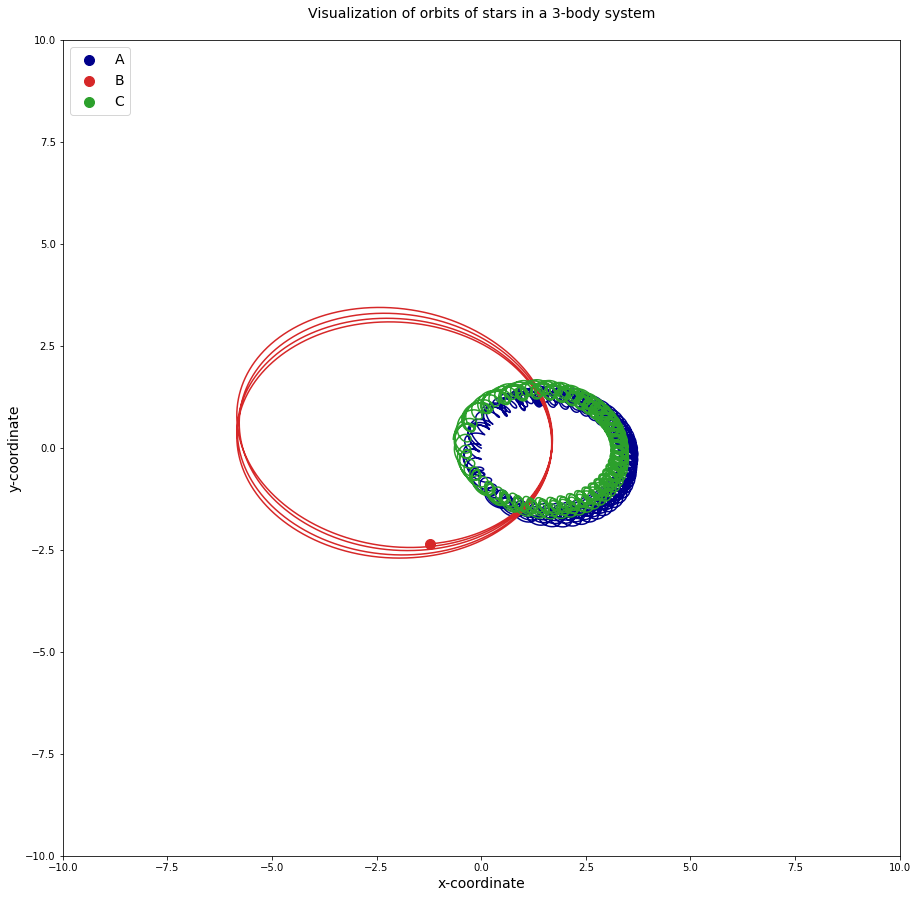

steps: 870 info -3761.110595703125 {'r2_init': [1.676434836499392, -0.06078775444999338], 'r3_init': [-0.6781390219926836, 0.23045202823355804], 'v2_init': [-0.05984875119291261, -1.0418483685795212], 'v3_init': [0.05984875119291261, 1.0418483685795212], 'period': 2480, 'period(s)': 49.6} False
[ 1.6764349  -0.06078776] [-0.67813903  0.23045203] [-0.05984875119291261, -1.0418483685795212] [0.05984875119291261, 1.0418483685795212] 49.6


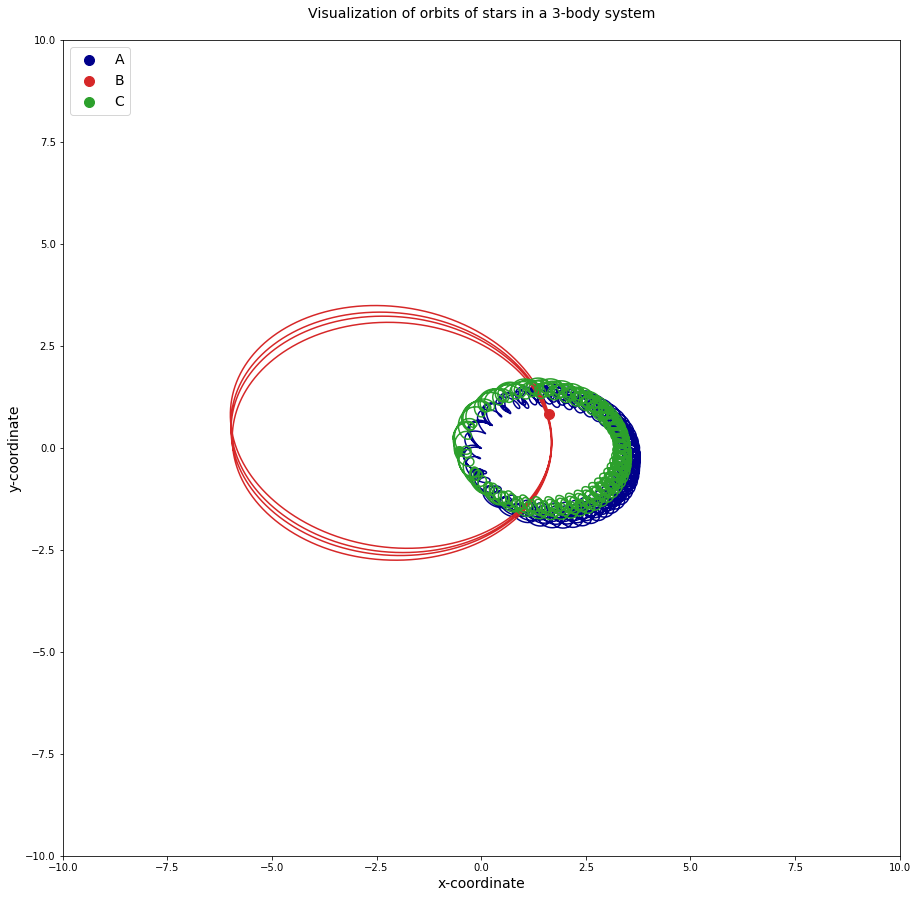

In [ ]:
#[A2C, SAC, PPO, TD3]
#take num
path = "/content/drive/My Drive/Termpaper/model/2D_T_VPPO_30000_201128"
model = model_load(2, path)
%xmode Verbose

env = CustomEnv2DT_V()
obs = env.reset()
best_reward = None
for _ in range(1500):
    action, _states = model.predict(obs)
    obs, rewards, dones, info = env.step(action)
    # print("steps", _ , "info", info)
    if dones == False:
      if best_reward is not None:
        if rewards > best_reward:
          print("steps:",_+1, "info", rewards, info, dones)
          env.render()

          best_reward = rewards
        else:
          pass
      else:
        if rewards is not None:
          best_reward = rewards
    


/usr/local/lib/python3.6/dist-packages/torch/cuda/__init__.py:52: UserWarning: CUDA initialization: The NVIDIA driver on your system is too old (found version 10010). Please update your GPU driver by downloading and installing a new version from the URL: http://www.nvidia.com/Download/index.aspx Alternatively, go to: https://pytorch.org to install a PyTorch version that has been compiled with your version of the CUDA driver. (Triggered internally at  /pytorch/c10/cuda/CUDAFunctions.cpp:100.)
  return torch._C._cuda_getDeviceCount() > 0


Exception reporting mode: Verbose


/usr/local/lib/python3.6/dist-packages/scipy/integrate/odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:55: RuntimeWarning: invalid value encountered in subtract
/usr/local/lib/python3.6/dist-packages/numpy/linalg/linalg.py:2506: RuntimeWarning: overflow encountered in multiply
  


steps: 128 info -3546.715929031372 {'r2_init': [0.9553837591223422, 1.0213196013122794], 'r3_init': [-0.9923656089976434, -0.9217678489908578], 'period': 248} False
[0.9553838 1.0213196] [-0.9923656  -0.92176783]


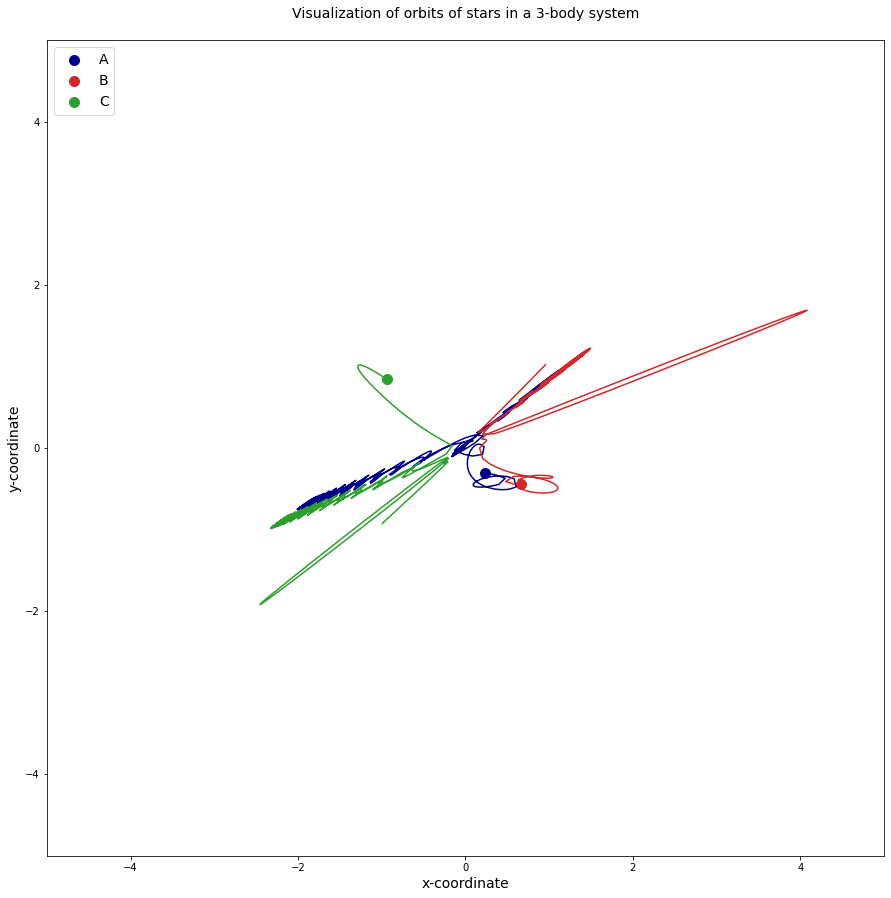

/usr/local/lib/python3.6/dist-packages/scipy/integrate/odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)


steps: 136 info -3467.2281131744385 {'r2_init': [0.9829511908814315, 1.0245655924826857], 'r3_init': [-0.9639921658113603, -0.8739750347658993], 'period': 248} False
[0.98295116 1.0245656 ] [-0.9639922  -0.87397504]


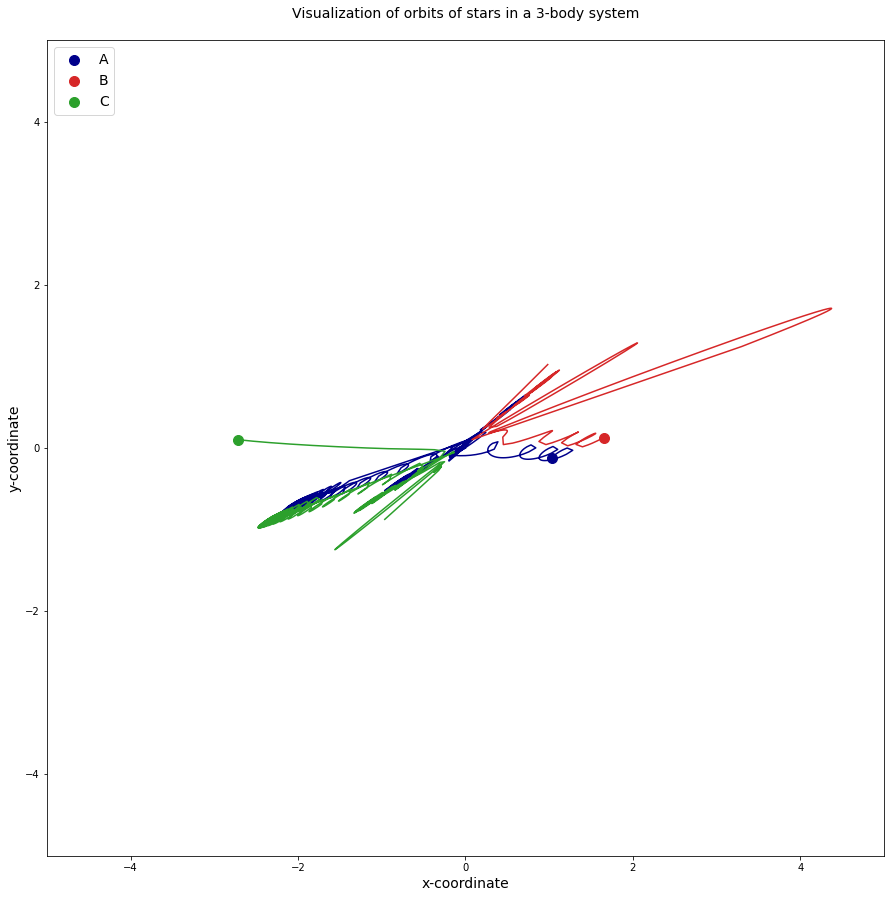

/usr/local/lib/python3.6/dist-packages/scipy/integrate/odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)


steps: 140 info -3424.6189823150635 {'r2_init': [0.9894785382226113, 1.0263514806888994], 'r3_init': [-0.9788844512775544, -0.858699564151466], 'period': 248} False
[0.9894785 1.0263515] [-0.97888446 -0.85869956]


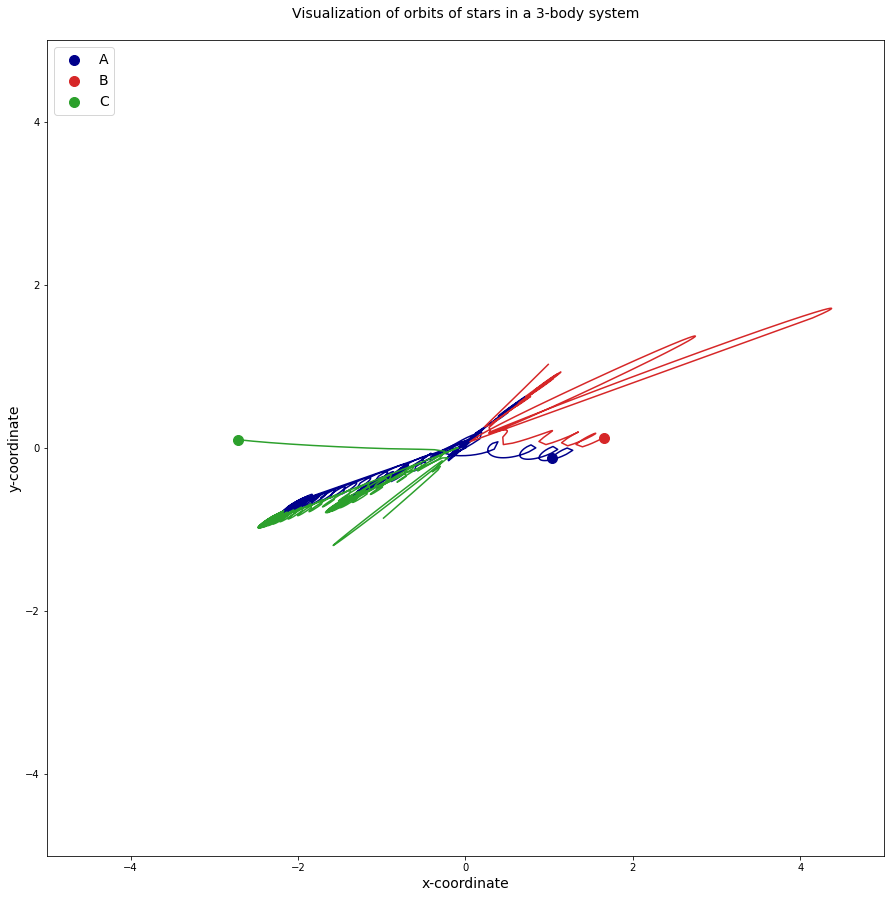

/usr/local/lib/python3.6/dist-packages/scipy/integrate/odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)


steps: 178 info -2155.499701023102 {'r2_init': [0.9737970361113548, 0.9750274496711786], 'r3_init': [-0.9758025217428806, -0.8723842738196254], 'period': 248} False
[0.973797   0.97502744] [-0.97580254 -0.87238425]


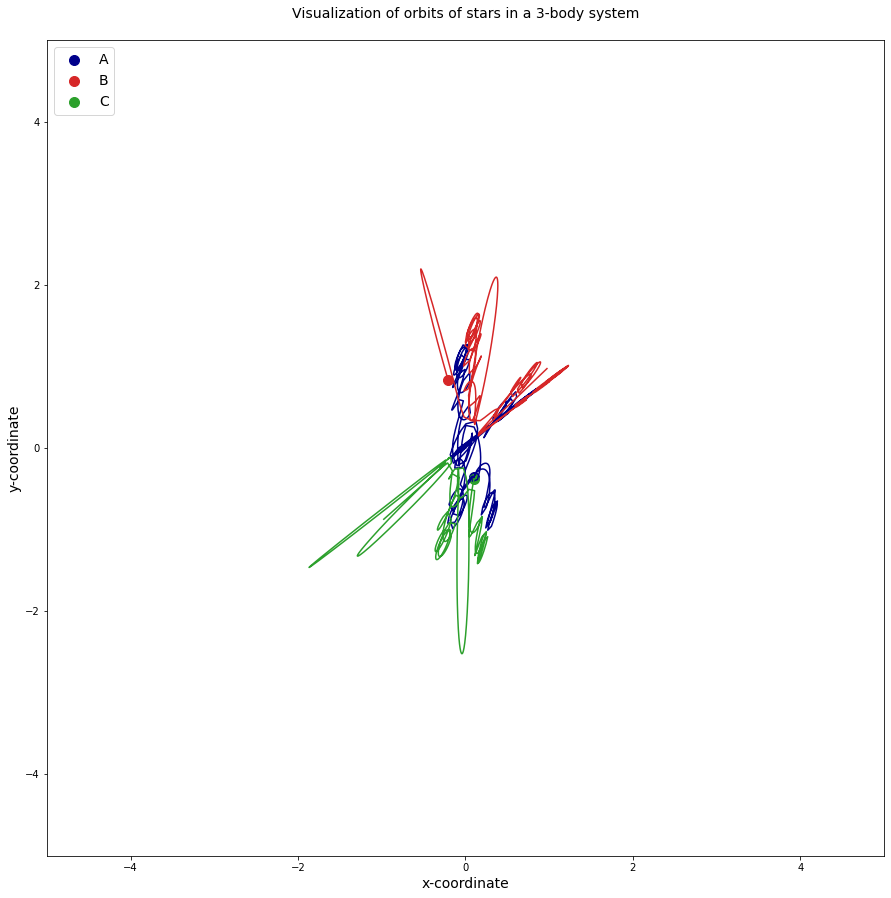

/usr/local/lib/python3.6/dist-packages/scipy/integrate/odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)


steps: 183 info -1929.7845396995544 {'r2_init': [0.9817763005197048, 0.9833588393963869], 'r3_init': [-0.9837791359797122, -0.862624275945127], 'period': 248} False
[0.9817763  0.98335886] [-0.98377913 -0.8626243 ]


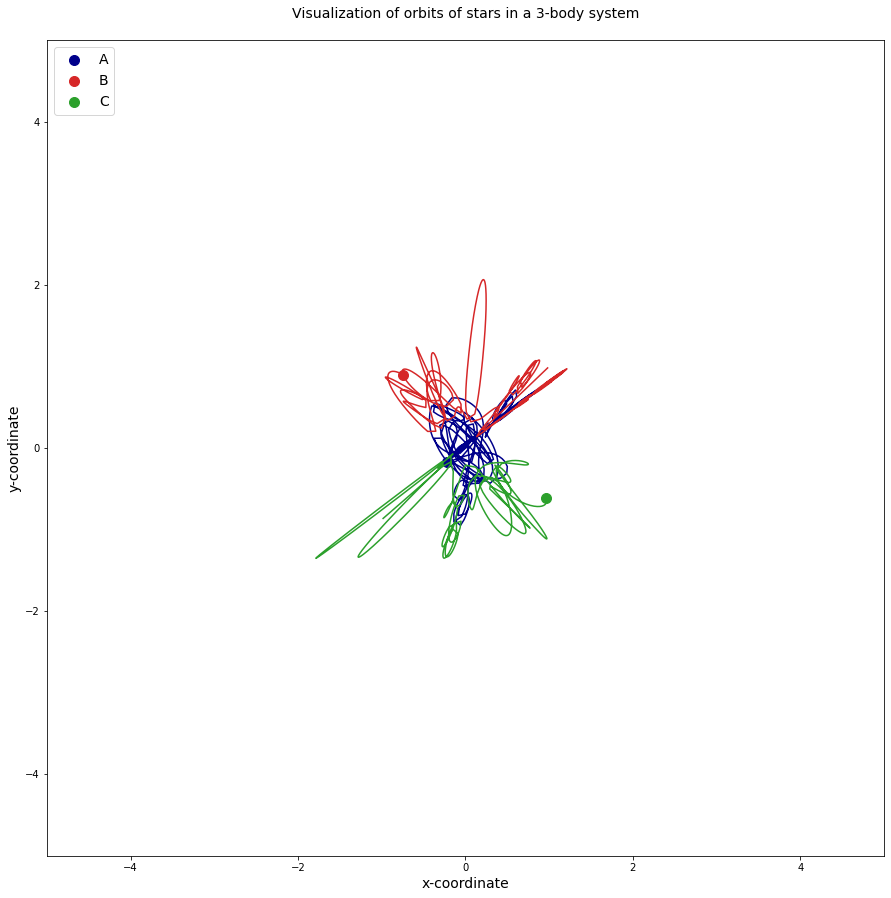

/usr/local/lib/python3.6/dist-packages/scipy/integrate/odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)


steps: 202 info -1784.8336668014526 {'r2_init': [0.98773796569556, 0.9678573163691904], 'r3_init': [-1.0051645836606622, -0.8872003326192499], 'period': 248} False
[0.98773795 0.9678573 ] [-1.0051646  -0.88720036]


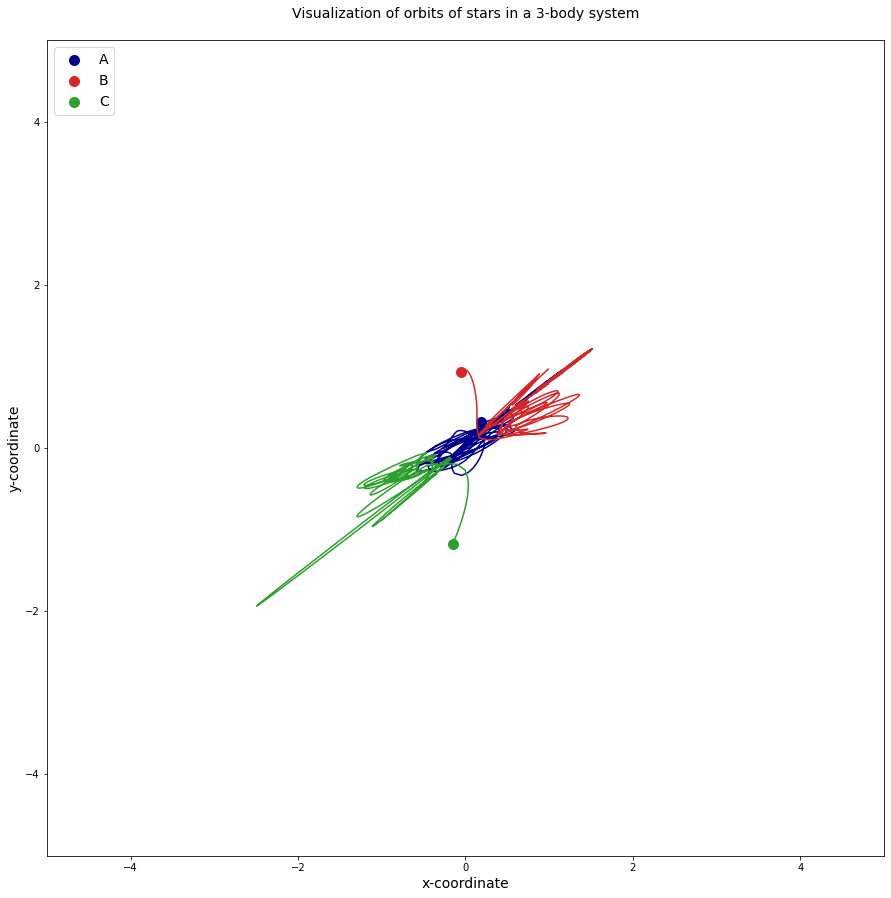

/usr/local/lib/python3.6/dist-packages/scipy/integrate/odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)


steps: 230 info -1301.2705302238464 {'r2_init': [0.9976457439363002, 1.0087256440985943], 'r3_init': [-1.0310525924246756, -0.8082494024932386], 'period': 248} False
[0.99764574 1.0087256 ] [-1.0310526 -0.8082494]


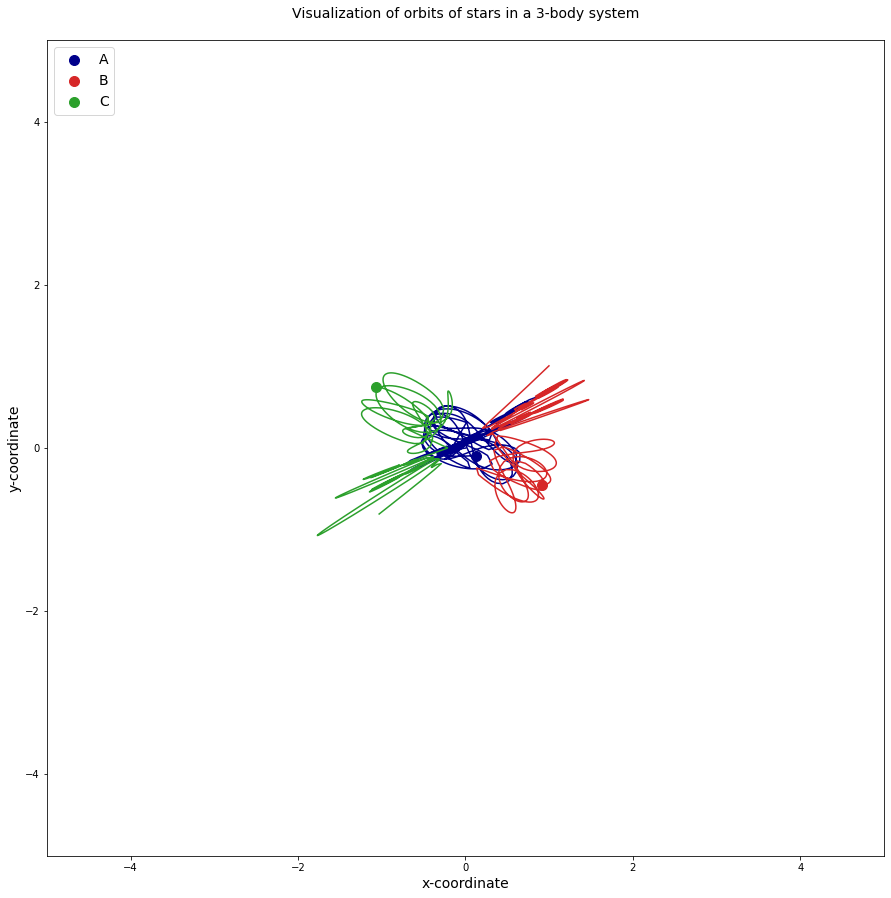

/usr/local/lib/python3.6/dist-packages/scipy/integrate/odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)


steps: 324 info -1209.4038543701172 {'r2_init': [0.9805480028316378, 1.0756330180820075], 'r3_init': [-1.0105076558049768, -0.7098081365600235], 'period': 248} False
[0.980548 1.075633] [-1.0105077 -0.7098081]


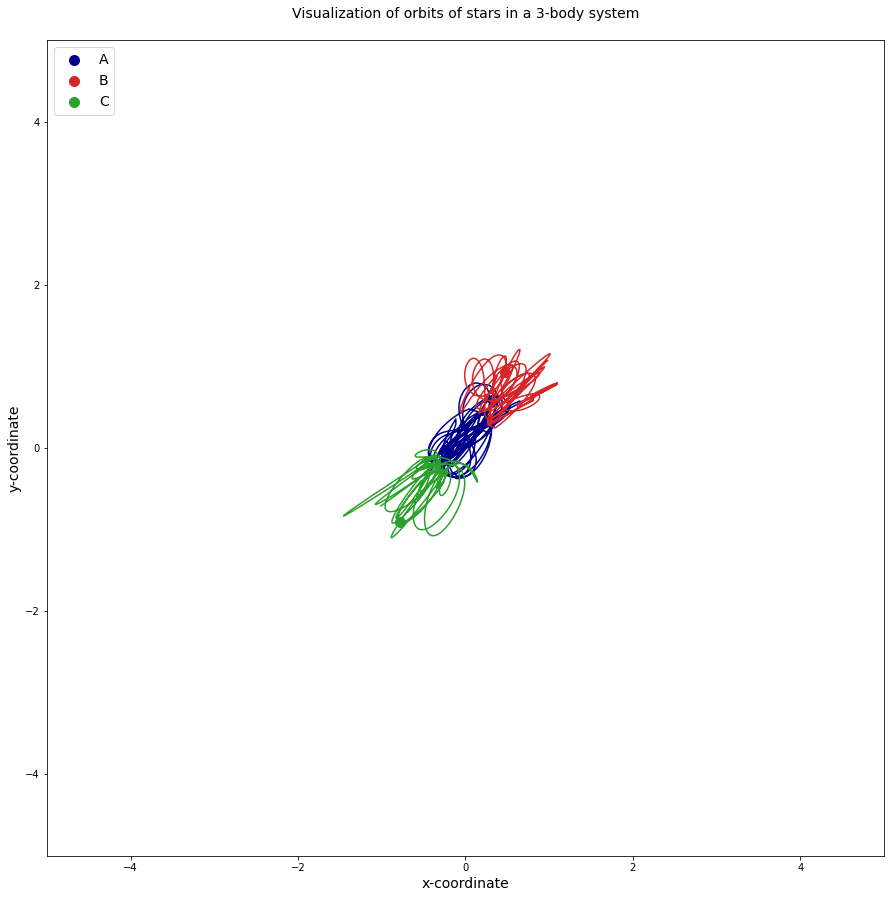

/usr/local/lib/python3.6/dist-packages/scipy/integrate/odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)


steps: 345 info -1202.3123598098755 {'r2_init': [0.9578190816566345, 1.0292320709442717], 'r3_init': [-1.0426540102716533, -0.691354933902622], 'period': 248} False
[0.9578191 1.029232 ] [-1.042654   -0.69135493]


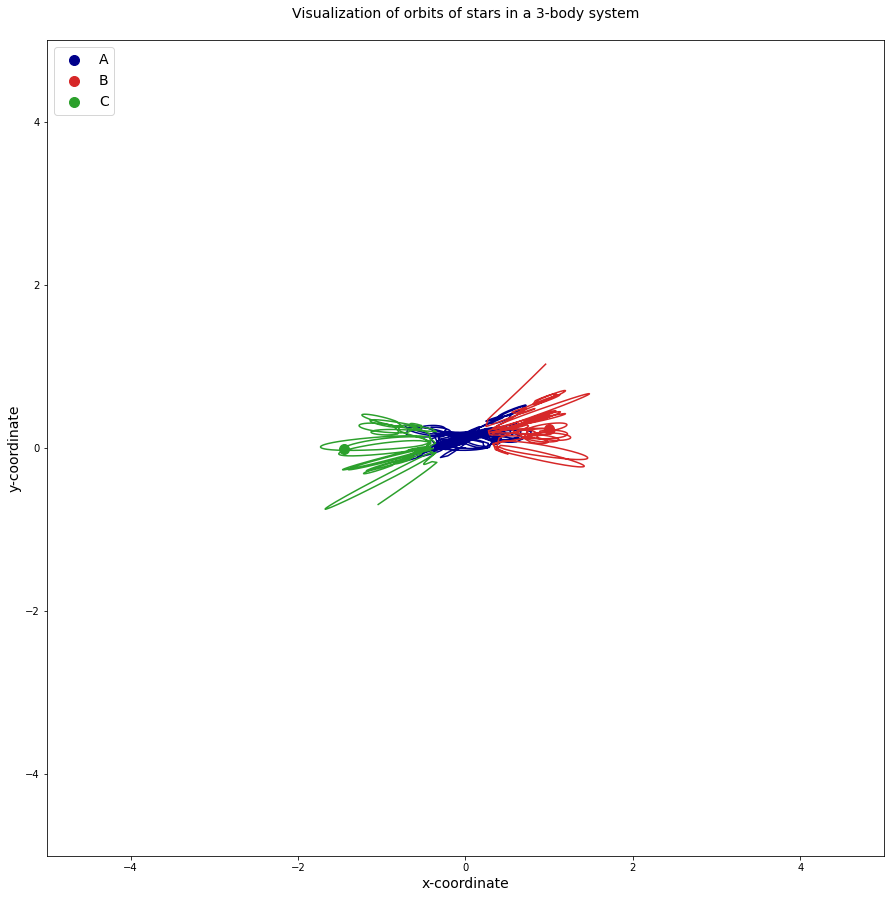

/usr/local/lib/python3.6/dist-packages/scipy/integrate/odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)


steps: 437 info -1162.7422304153442 {'r2_init': [0.9437517148535692, 1.1011052669165653], 'r3_init': [-1.0950958189368245, -0.8030502334237107], 'period': 248} False
[0.9437517 1.1011052] [-1.0950959 -0.8030502]


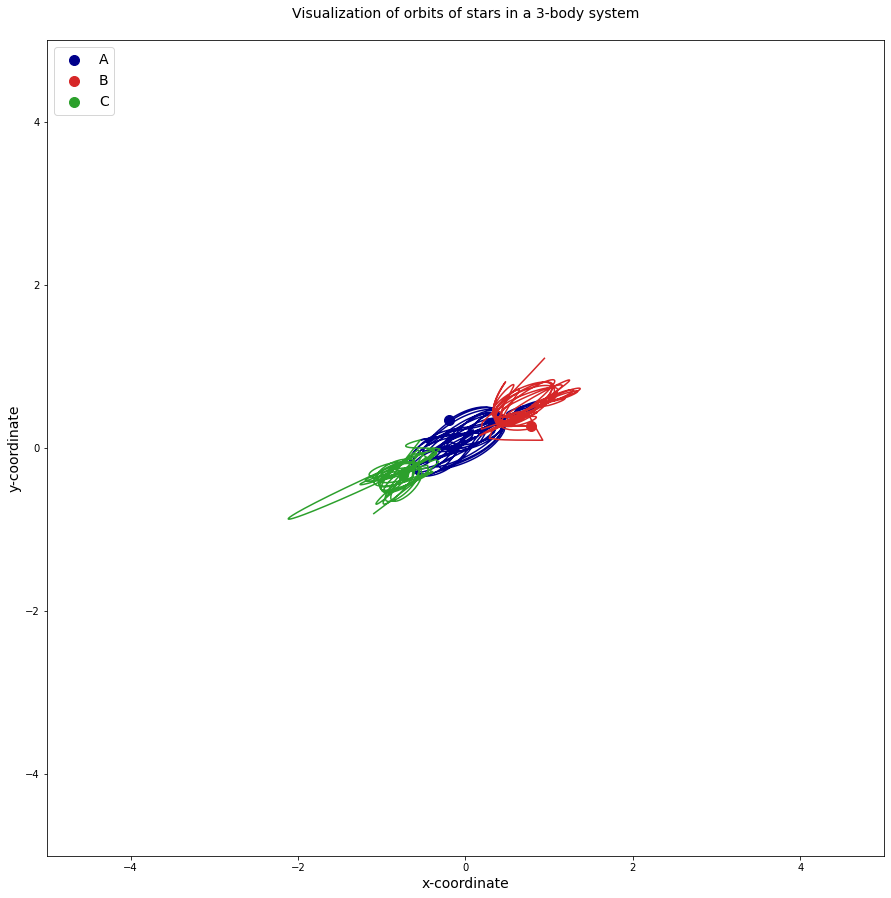

/usr/local/lib/python3.6/dist-packages/scipy/integrate/odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)


steps: 502 info -946.8126292228699 {'r2_init': [0.9815195075143124, 1.082466848539188], 'r3_init': [-1.0890638255700464, -0.7220951088890442], 'period': 248} False
[0.9815195 1.0824668] [-1.0890639  -0.72209513]


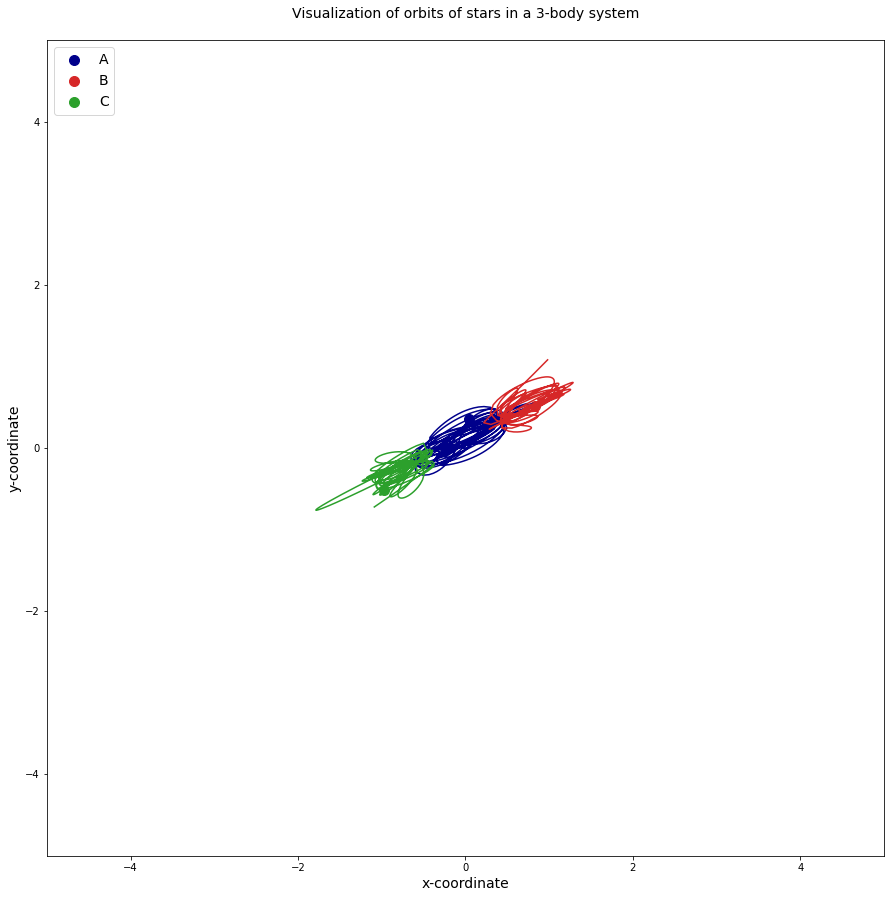

/usr/local/lib/python3.6/dist-packages/scipy/integrate/odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)


steps: 503 info -945.3535227775574 {'r2_init': [0.9809491278324272, 1.0845548239815974], 'r3_init': [-1.0848988419398662, -0.7271941628679641], 'period': 248} False
[0.9809491 1.0845548] [-1.0848988 -0.7271942]


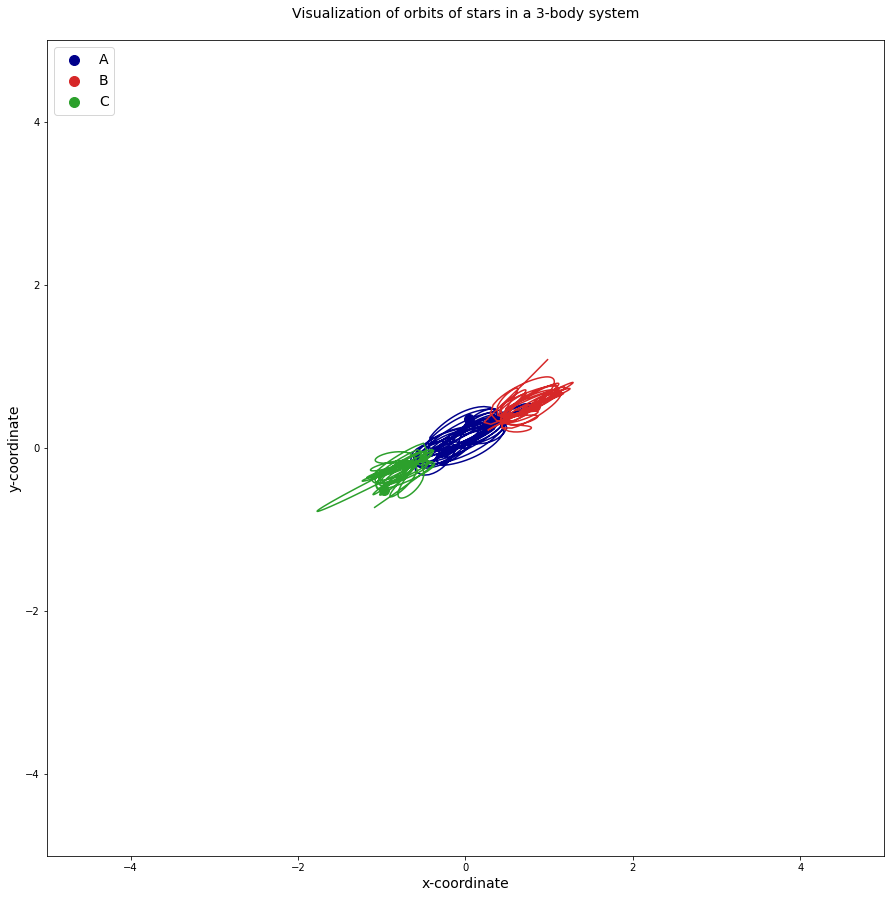

/usr/local/lib/python3.6/dist-packages/scipy/integrate/odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)


steps: 536 info -854.1071312427521 {'r2_init': [1.0581236729491499, 1.0490242715878404], 'r3_init': [-1.0358557952195404, -0.7410851484164603], 'period': 248} False
[1.0581237 1.0490242] [-1.0358558 -0.7410852]


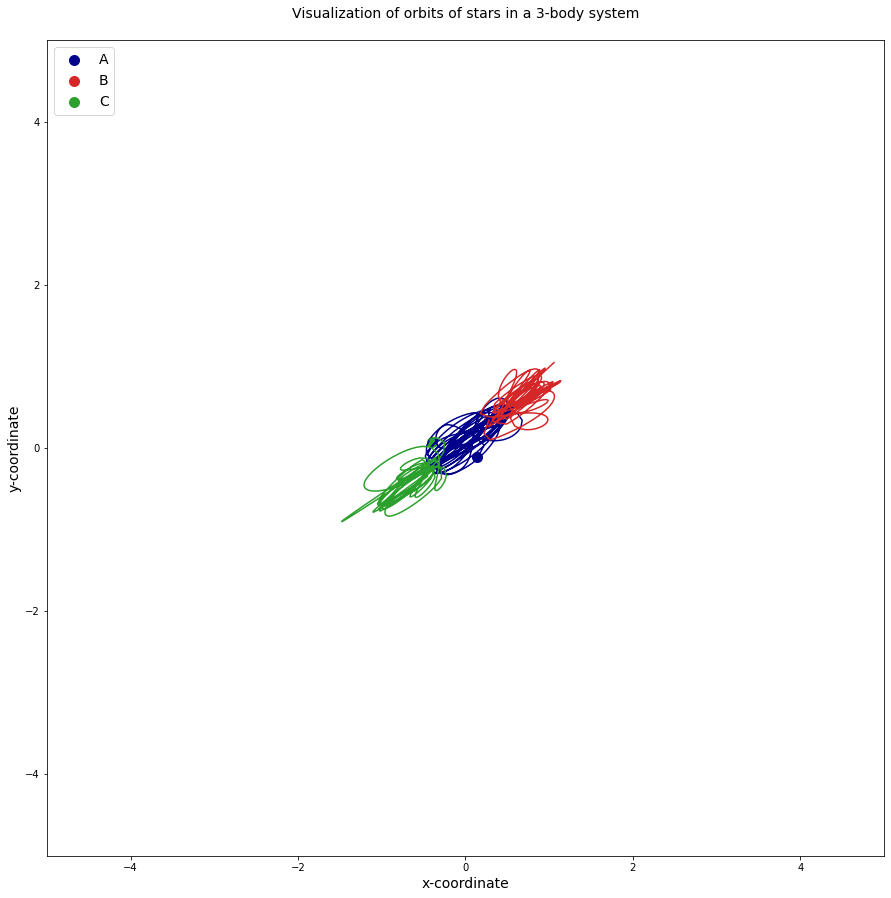

/usr/local/lib/python3.6/dist-packages/scipy/integrate/odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)


In [ ]:
#[A2C, SAC, PPO, TD3]
#take num
path = "/content/drive/My Drive/Termpaper/model/2dt_ppo_demo_10000_201126_"
model = model_load(2, path)
%xmode Verbose

env = CustomEnv2DT()
obs = env.reset()
best_reward = None
for _ in range(1500):
    action, _states = model.predict(obs)
    obs, rewards, dones, info = env.step(action)
    # print("steps", _ , "info", info)
    if dones == False:
      if best_reward is not None:
        if rewards > best_reward:
          print("steps:",_+1, "info", rewards, info, dones)
          env.render()

          best_reward = rewards
        else:
          pass
      else:
        if rewards is not None:
          best_reward = rewards
    


# Check the results

##Functions


In [ ]:
import numpy as np
def model_results_2D(r2, r3, v2, v3, fin, div, val, ani = False):
  G=1
  m_nd=1
  r_nd=1
  v_nd=1
  t_nd=1
  #Net constants
  K1=G*t_nd*m_nd/(r_nd**2*v_nd)
  K2=v_nd*t_nd/r_nd

  #initial condition

  m1=1
  m2=1
  m3=1
  r1=[0,0]
  r2=r2
  r3=r3
  v1=[0,0]
  v2=v2
  v3=v3
  r1=np.array(r1,dtype="float64")
  r2=np.array(r2,dtype="float64")
  r3=np.array(r3,dtype="float64")
  #Velocity of the Third Star
  v1=np.array(v1,dtype="float64")
  v2=np.array(v2,dtype="float64")
  v3=np.array(v3,dtype="float64")
  t = np.linspace(0, fin, div)
  fs = 1/div

  # %xmode Verbose
  #Run the ODE solver
  import scipy as sci
  import scipy.integrate
  init_params=sci.array([r1,r2,r3,v1,v2,v3]) #Initial parameters
  init_params=init_params.flatten()
  three_body_sol=sci.integrate.odeint(ThreeBodyEquations2,init_params,t,args=(m1,m2,m3))

  r1_sol=three_body_sol[:,:2]
  r2_sol=three_body_sol[:,2:4]
  r3_sol=three_body_sol[:,4:6]

  if ani == False:
    import matplotlib.pyplot as plt
    fig=plt.figure(figsize=(15,15))
    #Create 3D axes
    ax=fig.add_subplot(111)
    #Plot the orbits
    ax.plot(r1_sol[:,0],r1_sol[:,1],color="darkblue")
    ax.plot(r2_sol[:,0],r2_sol[:,1],color="tab:red")
    ax.plot(r3_sol[:,0],r3_sol[:,1],color="tab:green")
    #Plot the final positions of the stars
    ax.scatter(r1_sol[-1,0],r1_sol[-1,1],color="darkblue",marker="o",s=100,label="A")
    ax.scatter(r2_sol[-1,0],r2_sol[-1,1],color="tab:red",marker="o",s=100,label="B")
    ax.scatter(r3_sol[-1,0],r3_sol[-1,1],color="tab:green",marker="o",s=100,label="C")
    #Add a few more bells and whistles
    ax.set_xlabel("x-coordinate",fontsize=14)
    ax.set_ylabel("y-coordinate",fontsize=14)

    ax.set_title("Visualization of orbits of stars in a 3-body system\n",fontsize=14)
    plt.xlim(-val,val)
    plt.ylim(-val,val)
    print(r2_sol[0,:],r3_sol[0,:],self.v2, self.v3, self.period)
    ax.legend(loc="upper left",fontsize=14)

    return plt.show()
  elif ani:
    from mpl_toolkits.mplot3d import Axes3D
    from matplotlib import animation
    import matplotlib.pyplot as plt


    r1_sol=three_body_sol[:,:2]
    r2_sol=three_body_sol[:,2:4]
    r3_sol=three_body_sol[:,4:6]
    data1 = np.c_[r1_sol[:,0],r1_sol[:,1]]
    data2 = np.c_[r2_sol[:,0],r2_sol[:,1]]
    data3 = np.c_[r3_sol[:,0],r3_sol[:,1]]

    full_data = np.asarray([data1,data2,data3])

    x_t = full_data

    # Set up figure & 3D axis for animation
    #Create figure
    fig=plt.figure(figsize=(15,15))
    #Create 3D axes
    ax=fig.add_subplot(111)
    ax.set_xlim((-val, val))
    ax.set_ylim((-val, val))

    # choose a different color for each trajectory
    colors = plt.cm.jet(np.linspace(0, 1, 3))

    # set up lines and points
    lines = sum([ax.plot([], [], [], '-', c=c)
                for c in colors], [])
    pts = sum([ax.plot([], [], [], 'o', c=c)
              for c in colors], [])

    # prepare the axes limits
    ax.set_xlabel("x-coordinate",fontsize=14)
    ax.set_ylabel("y-coordinate",fontsize=14)
    ax.set_title("Visualization of orbits of stars in a 3-body system\n",fontsize=14)
    ax.legend(loc="upper left",fontsize=14)

    # initialization function: plot the background of each frame
    def init():
        for line, pt in zip(lines, pts):
            line.set_data([], [])

            pt.set_data([], [])
        return lines + pts

    # animation function.  This will be called sequentially with the frame number
    def animate(i):
        # we'll step two time-steps per frame.  This leads to nice results.
        i = (2 * i) % x_t.shape[1]

        for line, pt, xi in zip(lines, pts, x_t):
            x, y= np.transpose(xi[:i])
            line.set_data(x, y)

            pt.set_data(x[-1:], y[-1:])


        # ax.view_init(30, 0.3 * i) # view angle rotate

        fig.canvas.draw()
        return lines + pts

    # instantiate the animator.
    anim = animation.FuncAnimation(fig, animate, init_func=init,
                                  frames=np.arange(0.0, fin, 0.1), interval=30, blit=True)
    return anim

    # Save as mp4. This requires mplayer or ffmpeg to be installed
    #anim.save('lorentz_attractor.mp4', fps=15, extra_args=['-vcodec', 'libx264'])

In [ ]:
[0.69473769146949, 0.952729935962707], 'r3_init': [-0.5584692883491504, -0.37753519275225733], 'period': 207} False
[0.6947377  0.95272994] [-0.5584693 -0.3775352]

##Check the results 2D & anim

In [ ]:
from mpl_toolkits.mplot3d import Axes3D
from matplotlib import animation
import matplotlib.pyplot as plt


In [ ]:
G=1
m_nd=1
r_nd=1
v_nd=1
t_nd=1
#Net constants
K1=G*t_nd*m_nd/(r_nd**2*v_nd)
K2=v_nd*t_nd/r_nd

#initial condition
val = 10
m1=1
m2=1
m3=1
r1=[0,0]
r2= [1.7060478835552957, -0.1962866971455517]
r3= [-0.3248998699337242, -0.20805559483356803]
v1=[0,0]
v2=[-0.2853840887080883, -1.095852420516313]
v3=[0.2853840887080883, 1.095852420516313]
r1=np.array(r1,dtype="float64")
r2=np.array(r2,dtype="float64")
r3=np.array(r3,dtype="float64")
#Velocity of the Third Star
v1=np.array(v1,dtype="float64")
v2=np.array(v2,dtype="float64")
v3=np.array(v3,dtype="float64")
div = 10000
t = np.linspace(0, 200, div)
fs = 1/div

# %xmode Verbose
#Run the ODE solver
import scipy as sci
import scipy.integrate
init_params=sci.array([r1,r2,r3,v1,v2,v3]) #Initial parameters
init_params=init_params.flatten()
three_body_sol=sci.integrate.odeint(ThreeBodyEquations2,init_params,t,args=(m1,m2,m3))

r1_sol=three_body_sol[:,:2]
r2_sol=three_body_sol[:,2:4]
r3_sol=three_body_sol[:,4:6]

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:36: DeprecationWarning: scipy.array is deprecated and will be removed in SciPy 2.0.0, use numpy.array instead


No handles with labels found to put in legend.


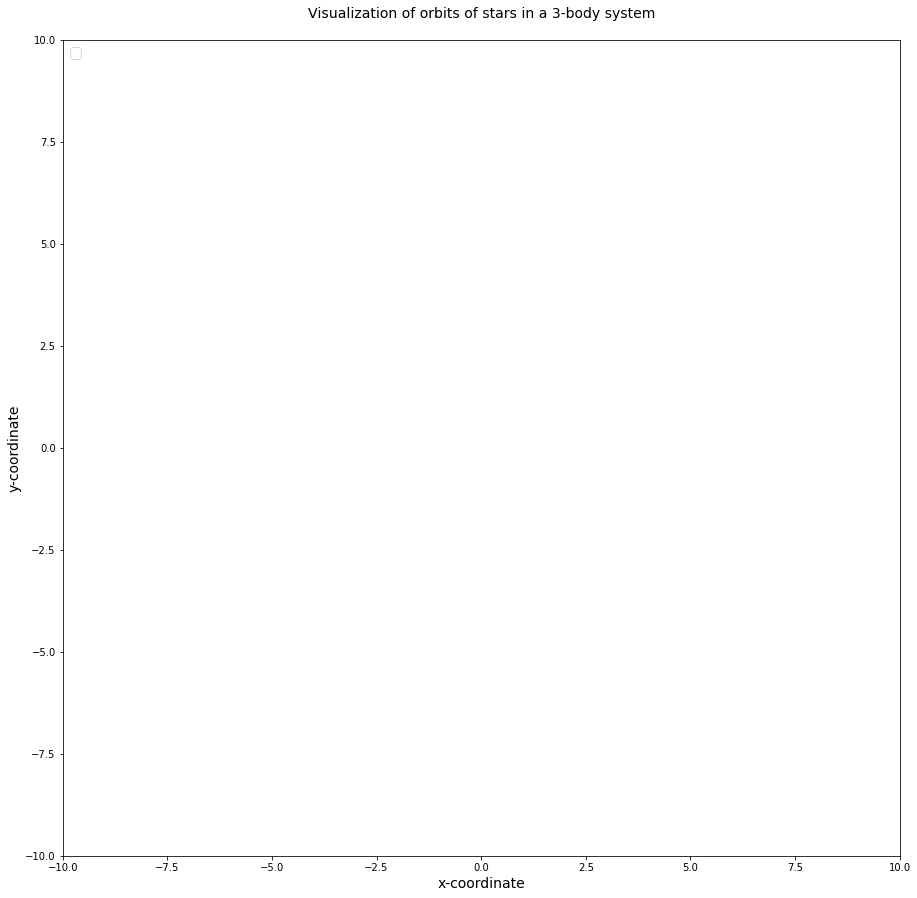

In [ ]:
r1_sol=three_body_sol[:,:2]
r2_sol=three_body_sol[:,2:4]
r3_sol=three_body_sol[:,4:6]
data1 = np.c_[r1_sol[:,0],r1_sol[:,1]]
data2 = np.c_[r2_sol[:,0],r2_sol[:,1]]
data3 = np.c_[r3_sol[:,0],r3_sol[:,1]]

full_data = np.asarray([data1,data2,data3])

x_t = full_data

# Set up figure & 3D axis for animation
#Create figure
fig=plt.figure(figsize=(15,15))
val = 3
#Create 3D axes
ax=fig.add_subplot(111)
ax.set_xlim((-val, val))
ax.set_ylim((-val, val))

# choose a different color for each trajectory
colors =['r','g','b']

# set up lines and points
lines = sum([ax.plot([], [], [], '-', c=c)
            for c in colors], [])
pts = sum([ax.plot([], [], [], 'o', c=c)
          for c in colors], [])

# prepare the axes limits
ax.set_xlabel("x-coordinate",fontsize=14)
ax.set_ylabel("y-coordinate",fontsize=14)
ax.set_title("Visualization of orbits of stars in a 3-body system\n",fontsize=14)
ax.legend(loc="upper left",fontsize=14)

# initialization function: plot the background of each frame
def init():
    for line, pt in zip(lines, pts):
        line.set_data([], [])
        pt.set_data([], [])
    return lines + pts

# animation function.  This will be called sequentially with the frame number
def animate(i):
    for line, pt, xi in zip(lines, pts, x_t):
        x, y= np.transpose(xi[:i])
        line.set_data(x, y)
        pt.set_data(x[-1:], y[-1:])


    # ax.view_init(30, 0.3 * i) # view angle rotate

    fig.canvas.draw()
    return lines + pts

# instantiate the animator.
anim = animation.FuncAnimation(fig, animate, frames = 60, interval=10, init_func=init, blit=True)
#For the saved animation the duration is going to be frames * (1 / fps) (in seconds)
# For the display animation the duration is going to be frames * interval / 1000 (in seconds)
#frames=60, interval=1000 기본 / saved - fps, displayed - interval

In [ ]:
# def model_results_2D(r2, r3, v2, v3, fin, div, val, ani=False)
anim = model_results_2D([0.69473769146949, 0.952729935962707], [-0.5584692883491504, -0.37753519275225733], 
                 [0.6947377,  0.95272994], [-0.5584693, -0.3775352], 200, 10000, 10, ani=True)

In [ ]:
import matplotlib
matplotlib.rcParams['animation.embed_limit'] = 2**64

In [ ]:
from matplotlib import rc
rc('animation', html='jshtml')
anim

In [ ]:

move_name = '3'
anim.save(f'/content/gdrive/My Drive/Termpaper/{mov_name}.mp4')